# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [6]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [7]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [8]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [9]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [10]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [11]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs= mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [12]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [13]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = ((1 - gradient_norm)**2 ).mean()
    #### END CODE HERE ####
    return penalty

In [14]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [17]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [18]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [21]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = -crit_real_pred.mean() + crit_fake_pred.mean() + c_lambda*gp
    #### END CODE HERE ####
    return crit_loss

In [22]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08848784730769693, critic loss: 1.8850477361083033


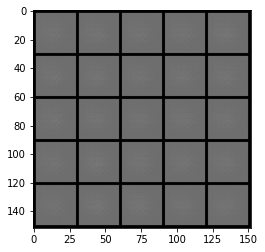

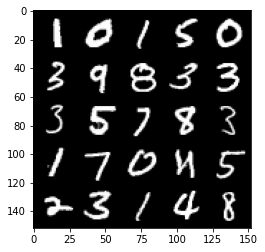

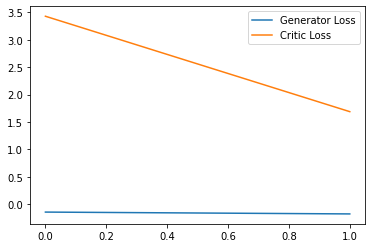

Step 100: Generator loss: 0.9973068287223578, critic loss: -1.9567873033881187


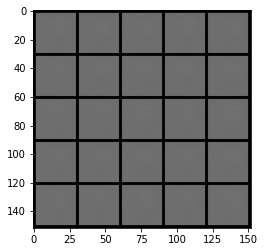

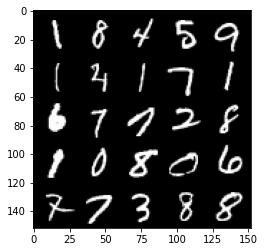

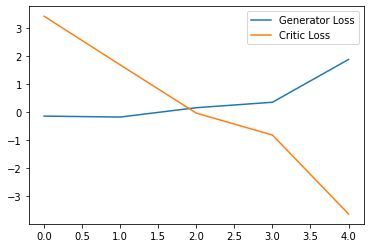

Step 150: Generator loss: 2.7928628802299498, critic loss: -11.276314939498903


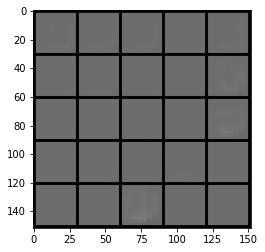

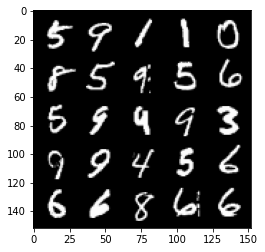

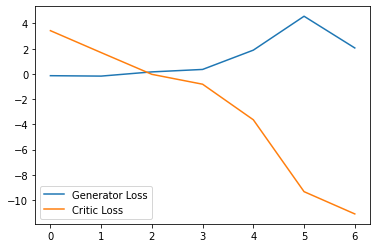

Step 200: Generator loss: -0.11085363235324622, critic loss: -27.677228027343745


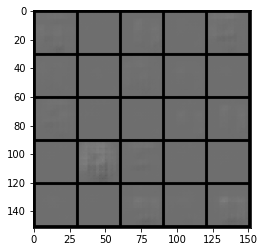

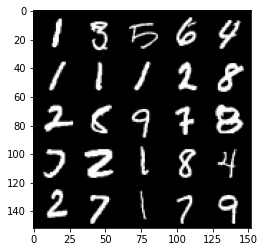

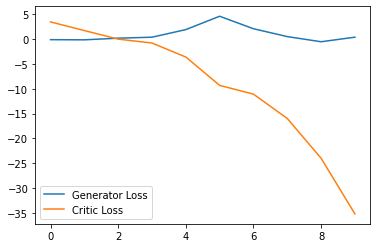

Step 250: Generator loss: -0.06552600920200348, critic loss: -60.740914062499996


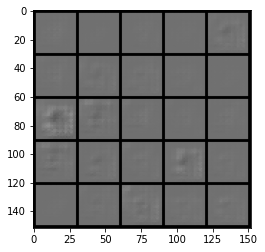

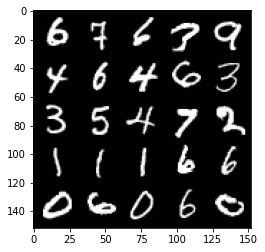

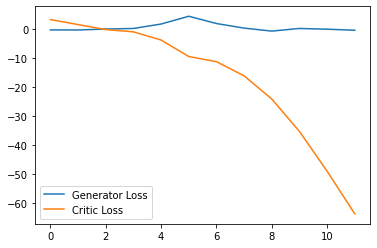

Step 300: Generator loss: 1.9642025089263917, critic loss: -103.19425054931638


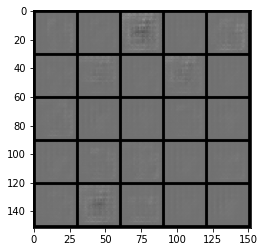

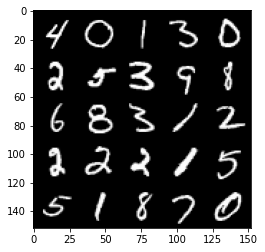

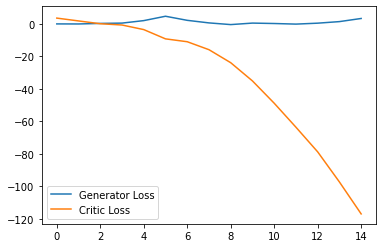

Step 350: Generator loss: 5.998899402618409, critic loss: -149.6431047668457


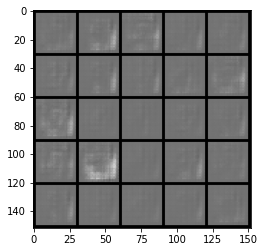

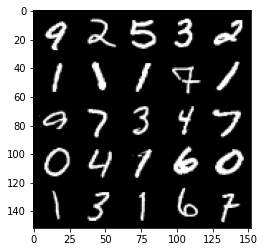

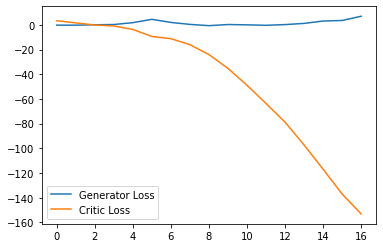

Step 400: Generator loss: 9.517062339782715, critic loss: -201.31372772216798


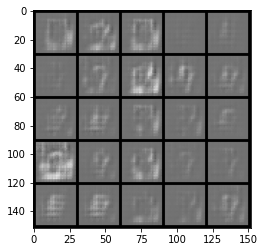

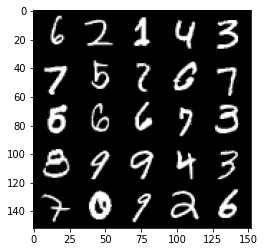

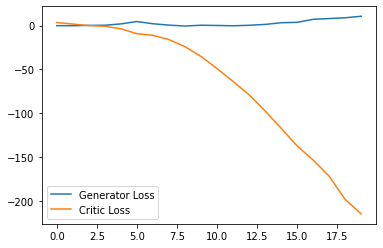

Step 450: Generator loss: 3.5404891753196717, critic loss: -197.12024552917484


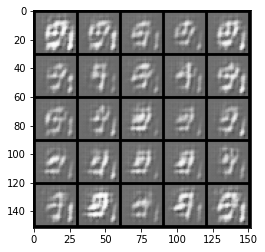

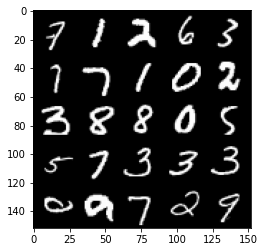

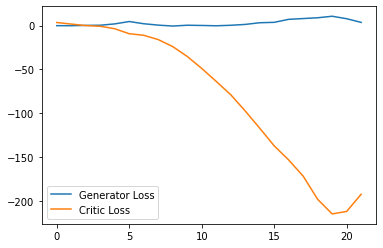

Step 500: Generator loss: 14.702580087184906, critic loss: -256.1083228149414


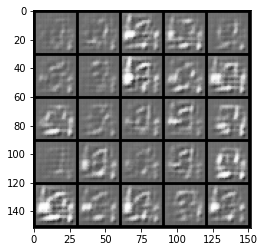

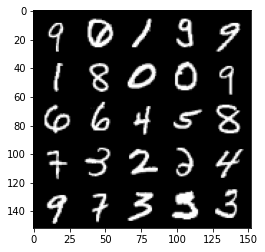

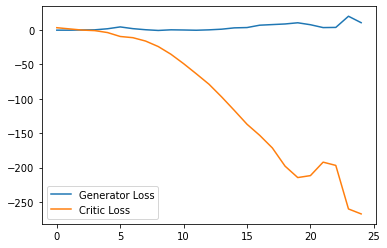

Step 550: Generator loss: 6.269148950576782, critic loss: -297.483280456543


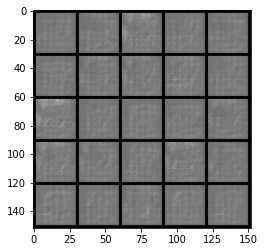

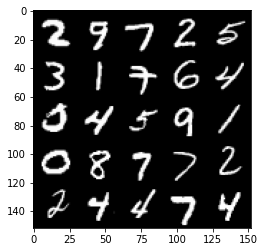

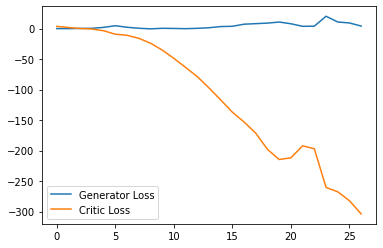

Step 600: Generator loss: 6.667398009300232, critic loss: -341.6546201782227


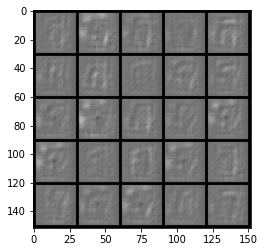

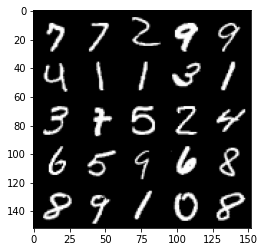

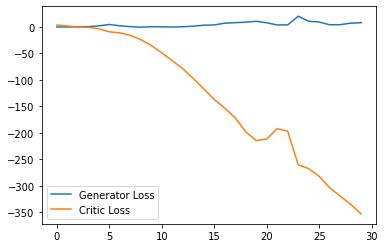

Step 650: Generator loss: 12.117172565460205, critic loss: -393.1612313232422


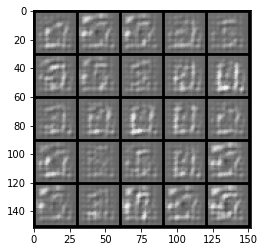

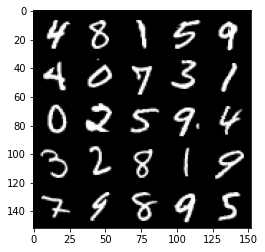

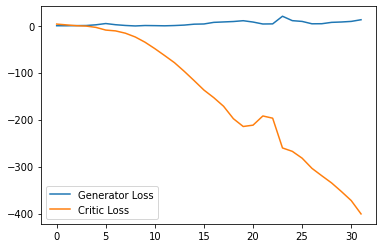

Step 700: Generator loss: -19.413174571990968, critic loss: -276.81748443603516


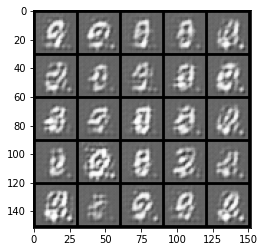

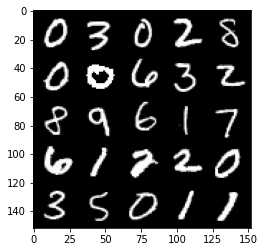

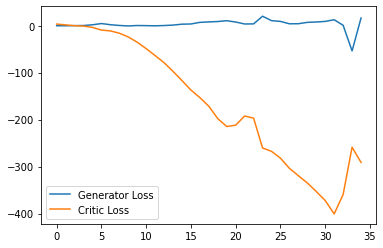

Step 750: Generator loss: -5.937764728069306, critic loss: -289.9649908447265


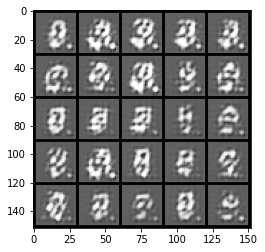

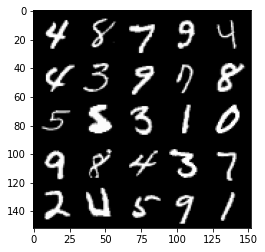

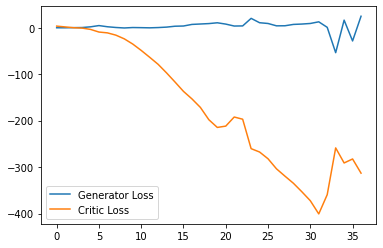

Step 800: Generator loss: 22.23601490020752, critic loss: -296.9274831237793


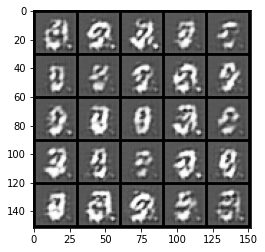

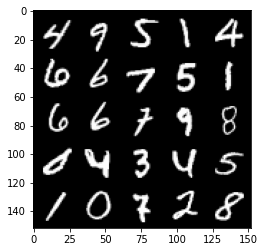

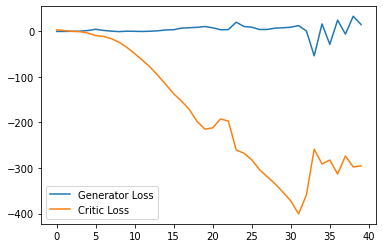

Step 850: Generator loss: -11.486255700588226, critic loss: -240.82889361572268


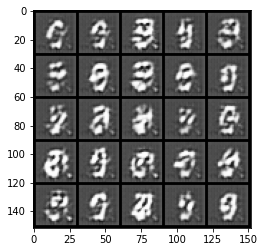

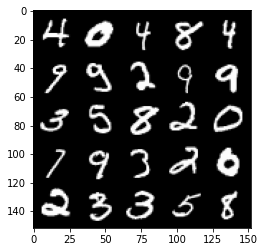

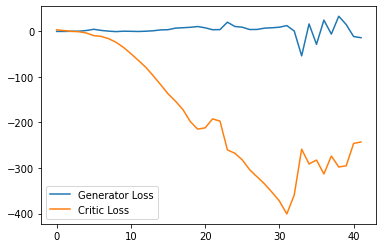

Step 900: Generator loss: -11.239331221580505, critic loss: -182.29498220825192


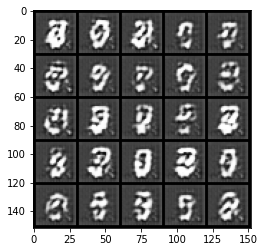

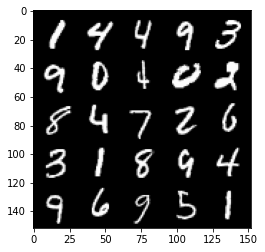

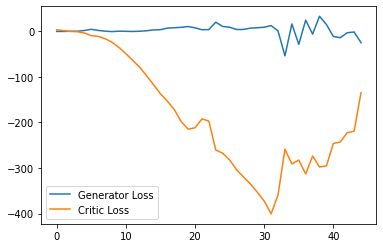

Step 950: Generator loss: -22.8752880191803, critic loss: -90.37078924179079


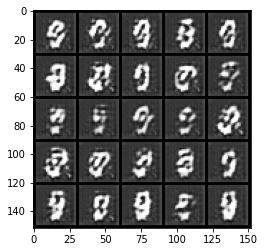

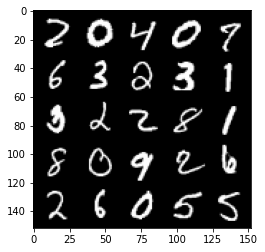

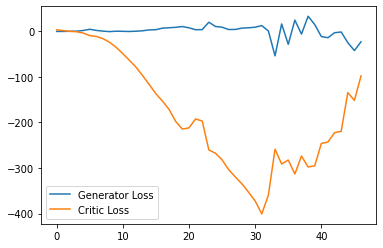

Step 1000: Generator loss: 3.2371225643157957, critic loss: 12.894766033172603


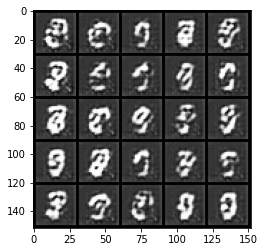

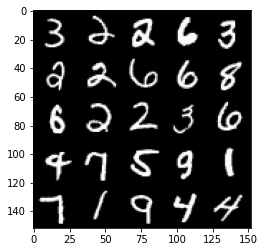

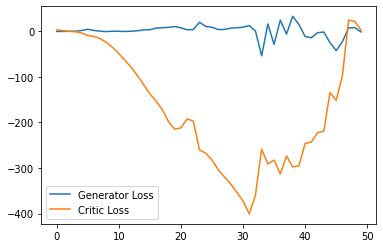

Step 1050: Generator loss: -14.658015823364257, critic loss: -20.55686817932128


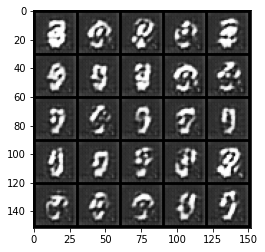

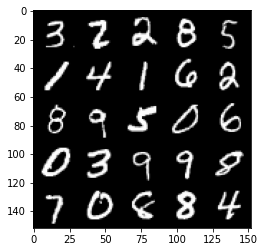

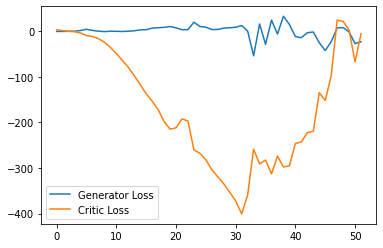

Step 1100: Generator loss: 17.995817985534668, critic loss: 36.48935617828369


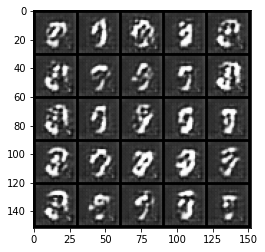

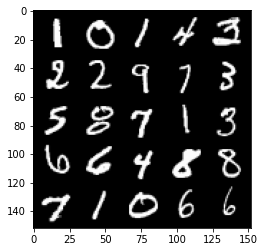

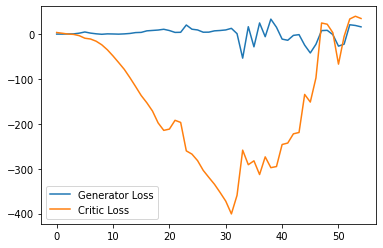

Step 1150: Generator loss: 12.219593601226807, critic loss: 22.03058312988281


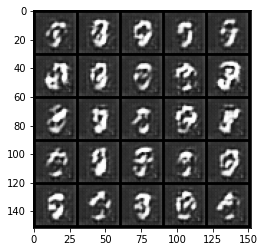

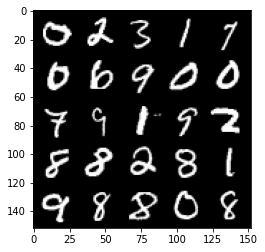

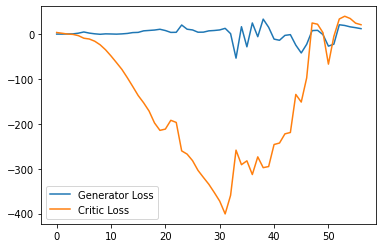

Step 1200: Generator loss: 7.9125368118286135, critic loss: 21.934152179718016


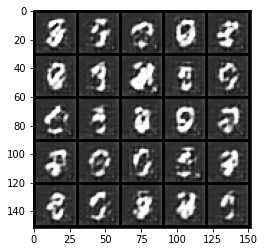

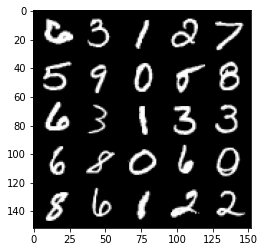

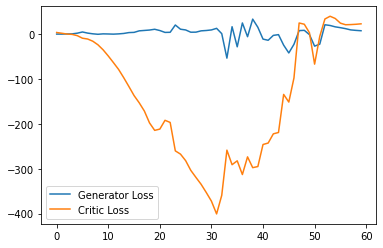

Step 1250: Generator loss: 6.91060474395752, critic loss: 25.540881027221687


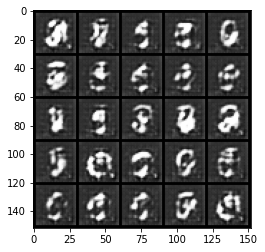

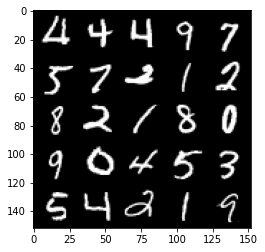

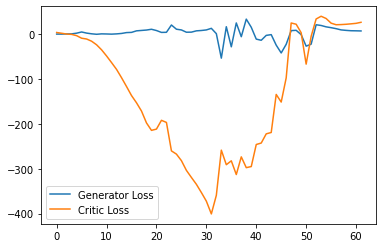

Step 1300: Generator loss: 6.569307260513305, critic loss: 28.680360244750982


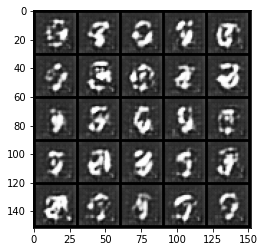

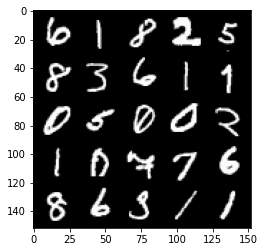

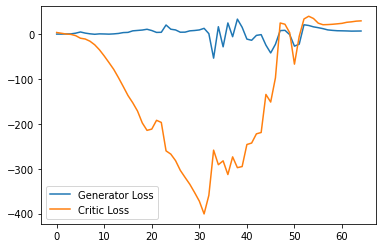

Step 1350: Generator loss: 7.047187671661377, critic loss: 31.53331583404541


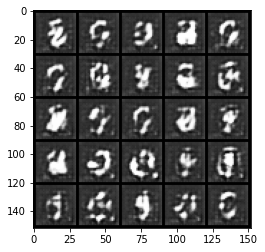

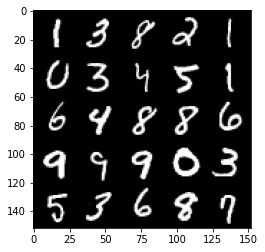

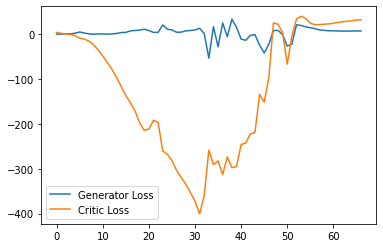

Step 1400: Generator loss: 8.10883155822754, critic loss: 31.6964797668457


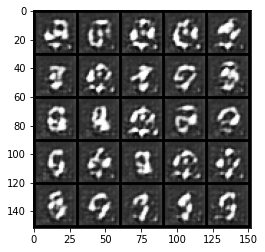

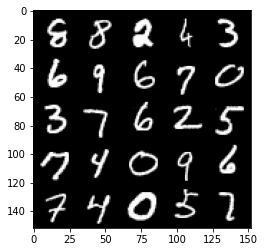

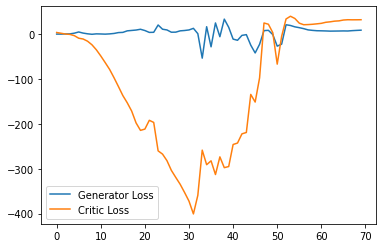

Step 1450: Generator loss: 10.80174328804016, critic loss: 28.355821933746338


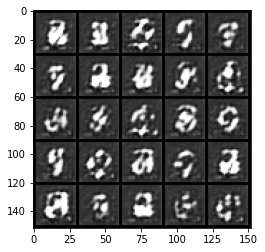

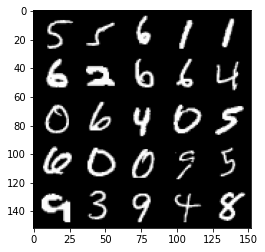

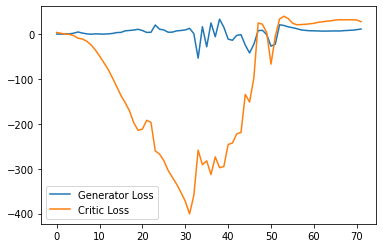

Step 1500: Generator loss: 14.57503828048706, critic loss: 18.518378433227536


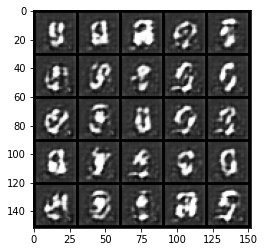

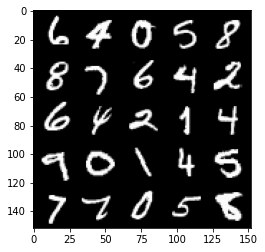

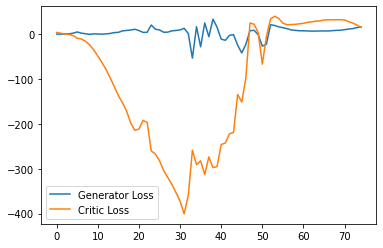

Step 1550: Generator loss: 18.45363998413086, critic loss: 10.135525062561038


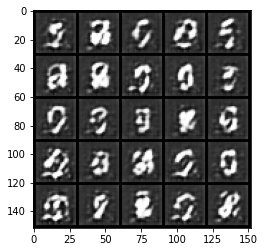

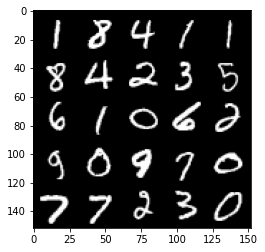

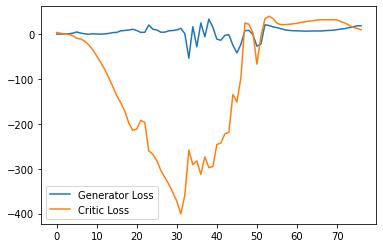

Step 1600: Generator loss: 21.725558891296387, critic loss: 2.077210193634033


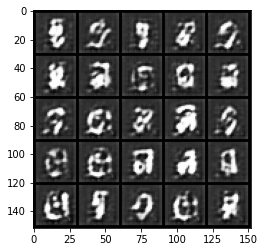

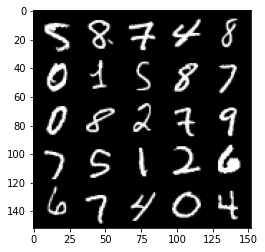

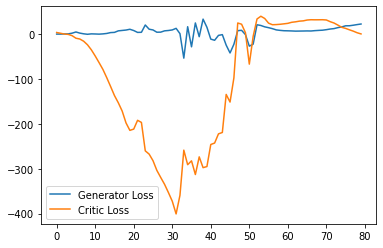

Step 1650: Generator loss: 23.00854124069214, critic loss: -4.990658119201659


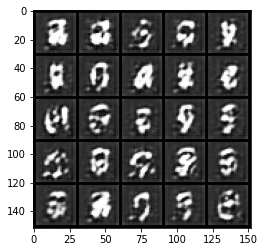

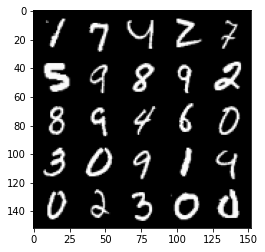

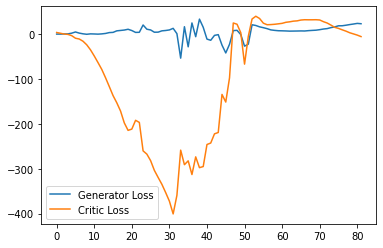

Step 1700: Generator loss: 26.160650882720947, critic loss: -9.938908832550048


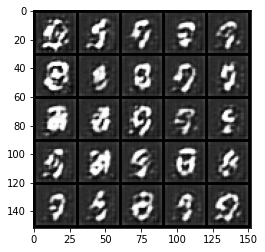

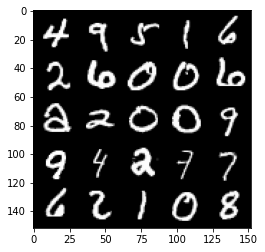

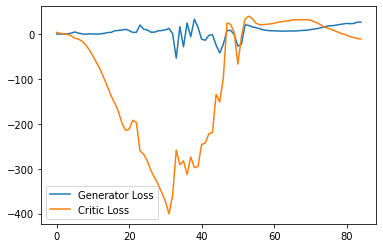

Step 1750: Generator loss: 27.37233871459961, critic loss: -14.765207374572755


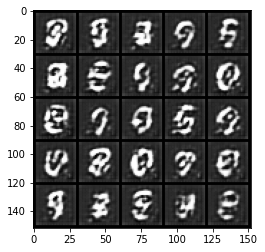

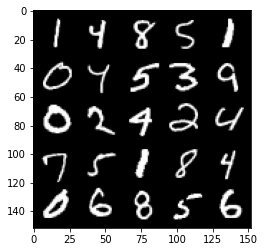

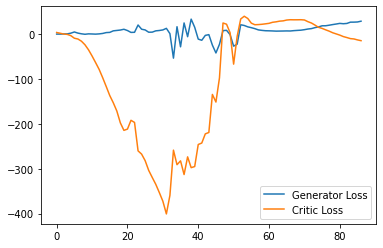

Step 1800: Generator loss: 31.067129039764403, critic loss: -16.41795973587036


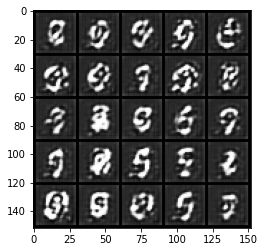

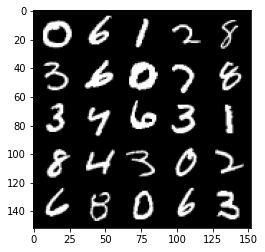

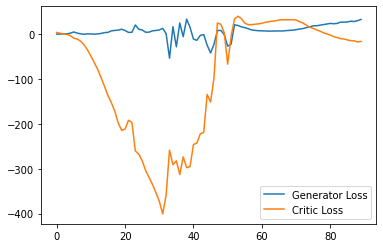

Step 1850: Generator loss: 33.35638484954834, critic loss: -17.423942852020264


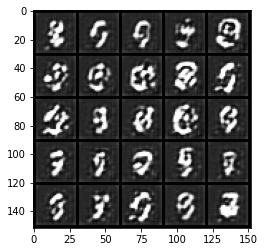

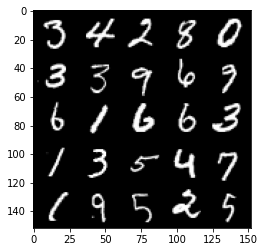

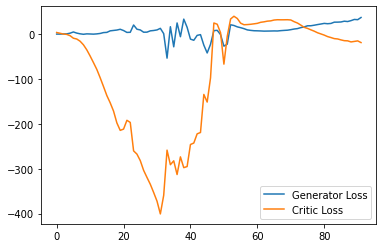

Step 1900: Generator loss: 34.86393199920654, critic loss: -15.79408105087281


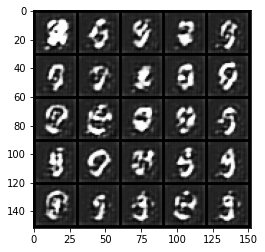

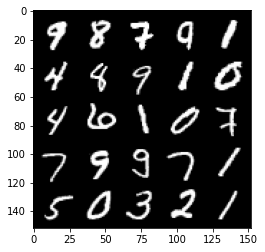

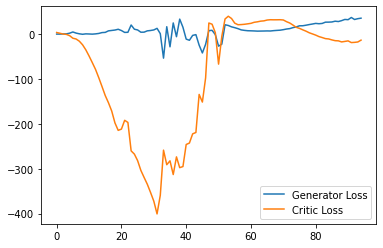

Step 1950: Generator loss: 37.21937309265137, critic loss: -7.8168255023956315


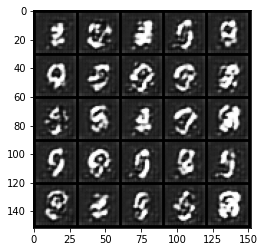

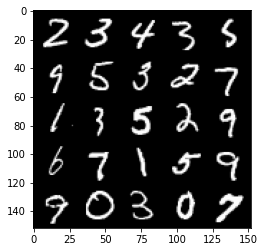

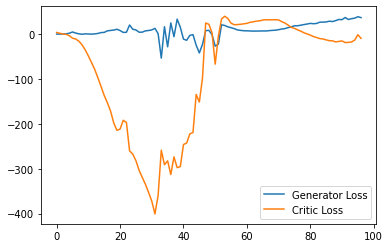

Step 2000: Generator loss: 39.01796314239502, critic loss: -15.056844745635981


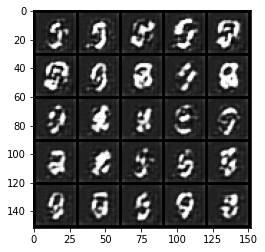

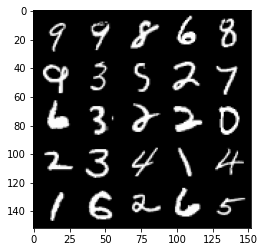

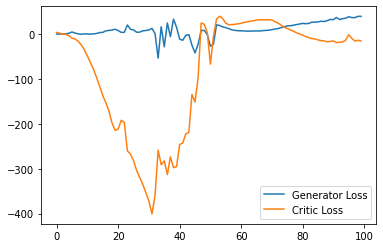

Step 2050: Generator loss: 41.44853324890137, critic loss: -14.85380994129181


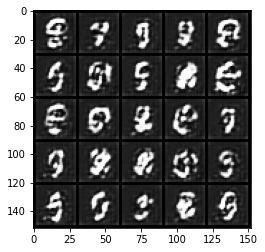

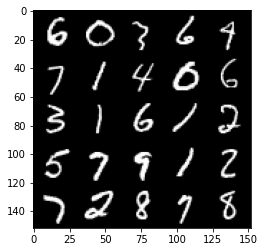

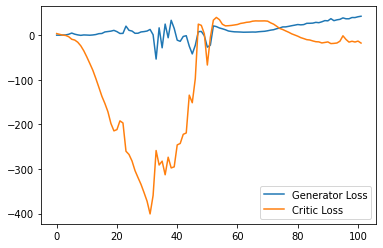

Step 2100: Generator loss: 43.789084663391115, critic loss: -7.705039746761319


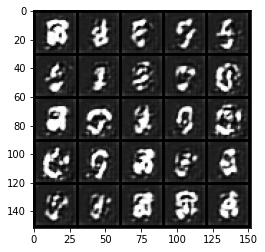

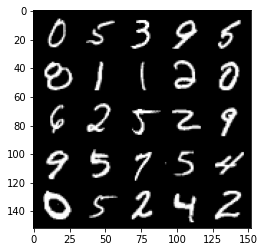

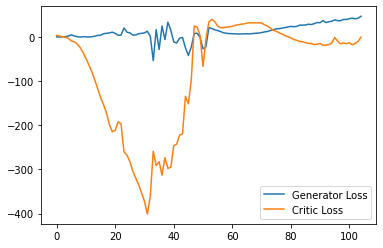

Step 2150: Generator loss: 44.98916351318359, critic loss: -1.51048410654068


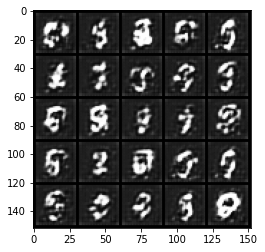

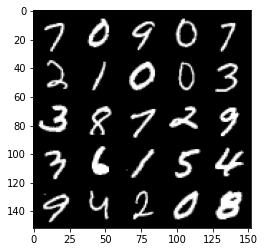

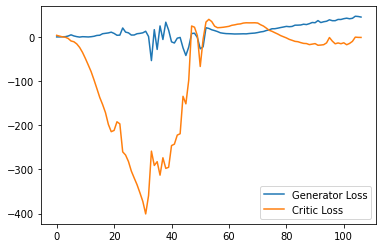

Step 2200: Generator loss: 39.930325469970704, critic loss: -12.016952792167665


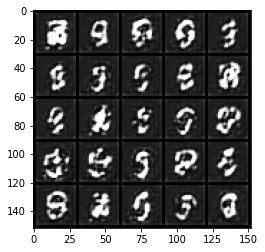

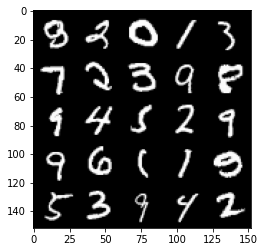

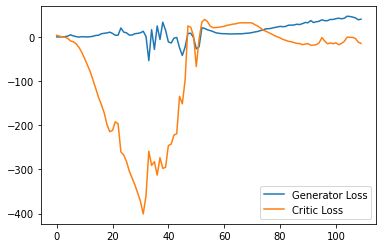

Step 2250: Generator loss: 42.223178443908694, critic loss: -15.360916477203373


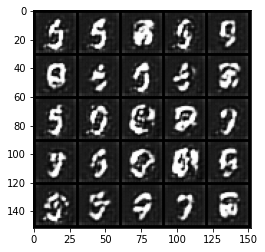

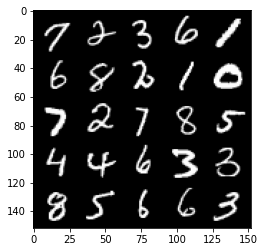

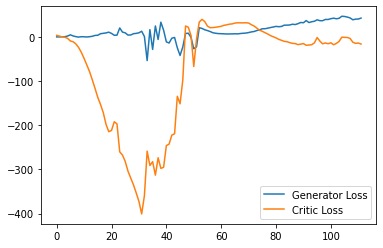

Step 2300: Generator loss: 45.112201919555666, critic loss: -6.366393136024475


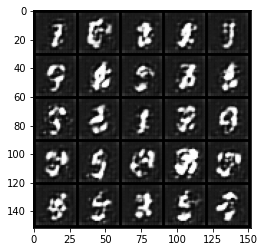

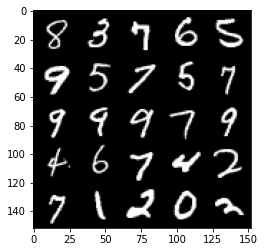

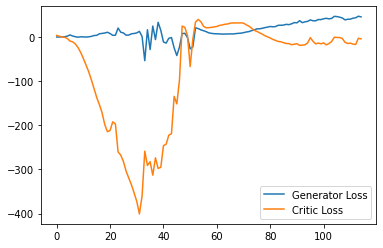

Step 2350: Generator loss: 40.11269607543945, critic loss: -13.32930590057373


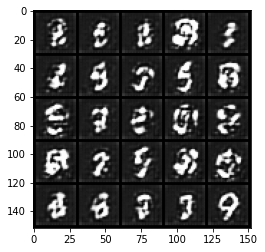

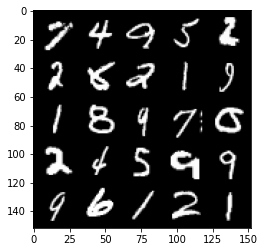

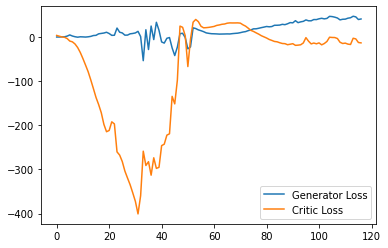

Step 2400: Generator loss: 41.96943607330322, critic loss: -15.171710798263549


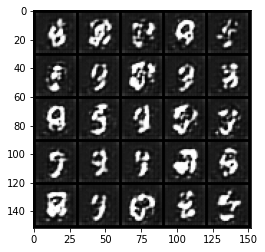

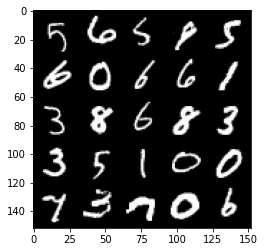

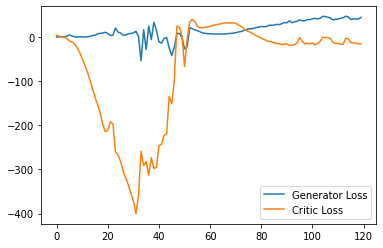

Step 2450: Generator loss: 44.82878330230713, critic loss: -9.255812321662905


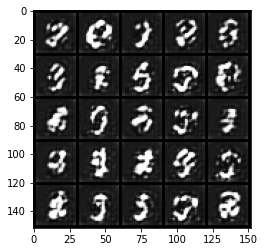

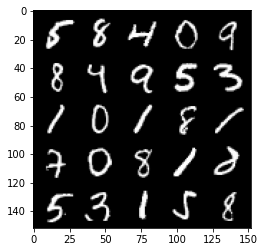

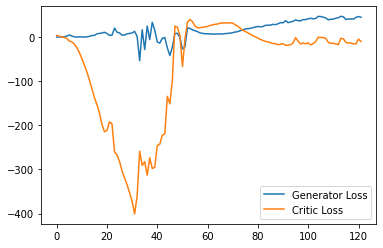

Step 2500: Generator loss: 42.67491268157959, critic loss: -15.76894890403748


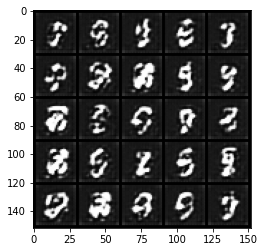

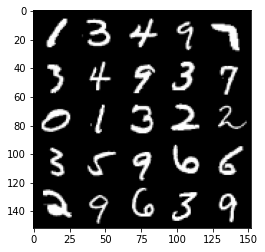

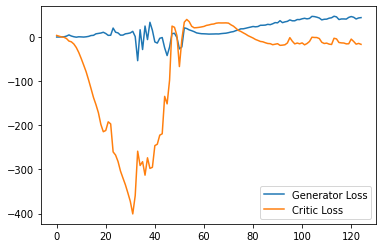

Step 2550: Generator loss: 44.596143836975095, critic loss: -14.208745367050174


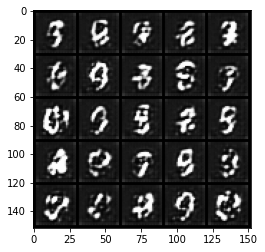

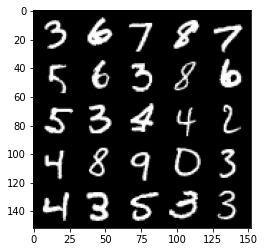

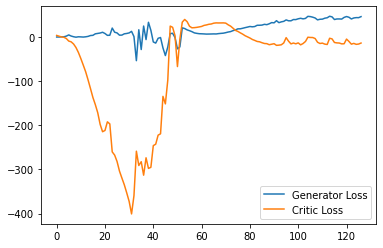

Step 2600: Generator loss: 44.82636734008789, critic loss: -12.834811637878417


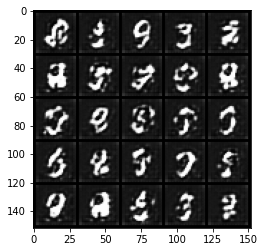

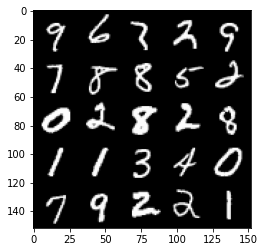

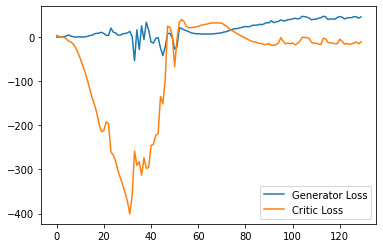

Step 2650: Generator loss: 45.54695465087891, critic loss: -11.365287365913389


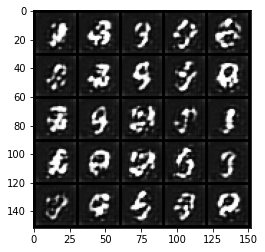

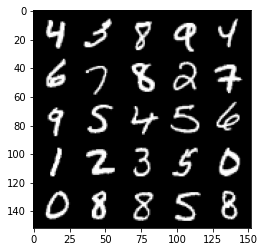

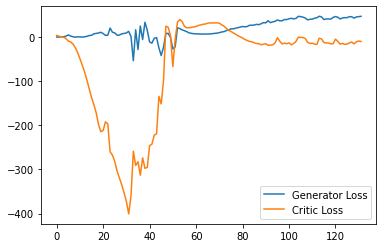

Step 2700: Generator loss: 45.66056694030762, critic loss: -13.981602076530459


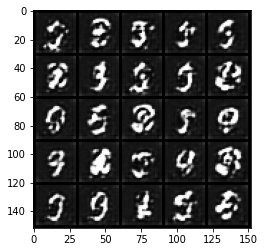

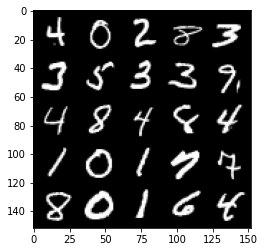

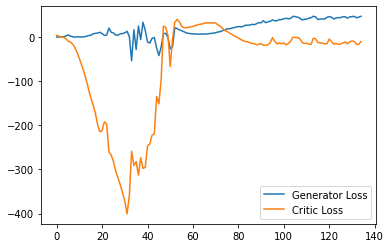

Step 2750: Generator loss: 46.94936698913574, critic loss: -9.347868736743928


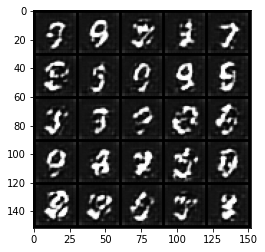

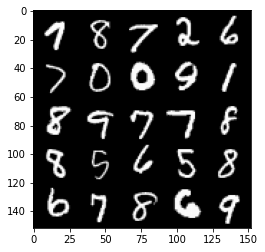

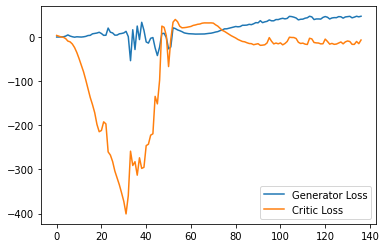

Step 2800: Generator loss: 46.57224571228027, critic loss: -7.6881763610839835


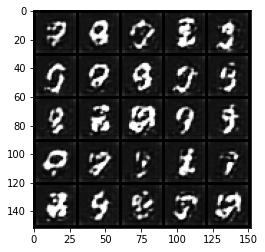

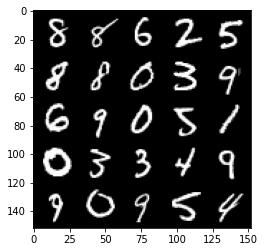

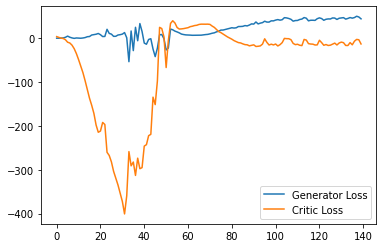

Step 2850: Generator loss: 44.05567108154297, critic loss: -15.486824830055234


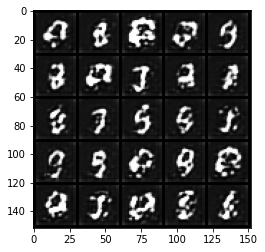

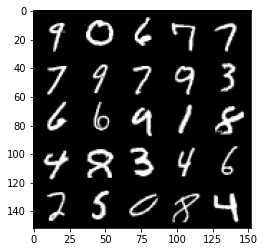

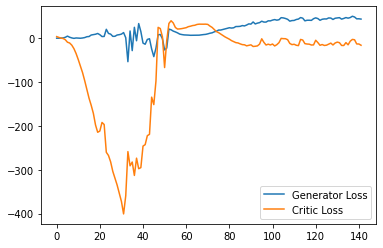

Step 2900: Generator loss: 45.03669914245606, critic loss: -12.863798280715939


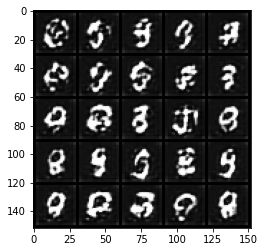

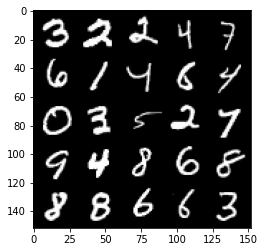

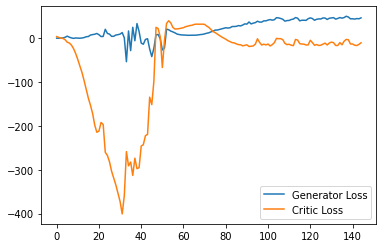

Step 2950: Generator loss: 43.35301895141602, critic loss: -14.848120202064518


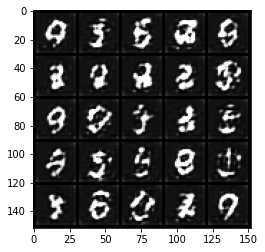

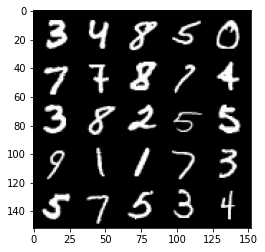

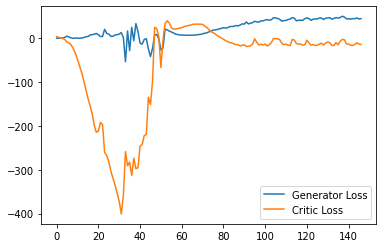

Step 3000: Generator loss: 44.022511596679685, critic loss: -16.113648246765134


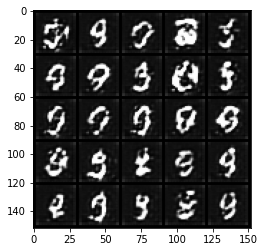

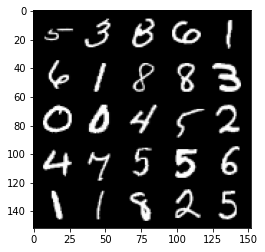

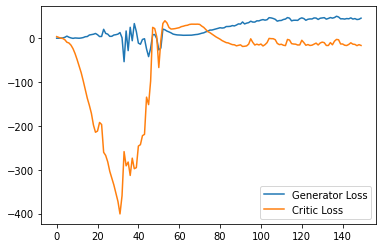

Step 3050: Generator loss: 46.745830879211425, critic loss: -9.784201756477353


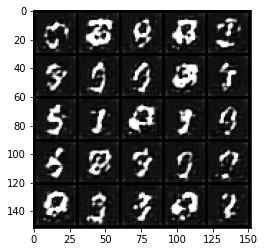

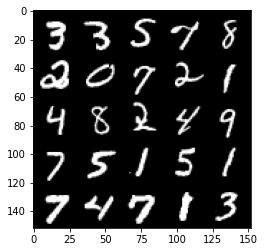

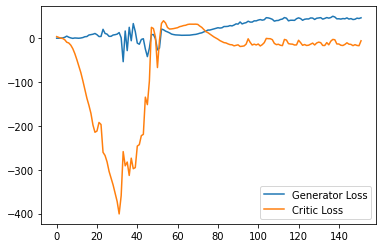

Step 3100: Generator loss: 44.6807080078125, critic loss: -12.794712139129638


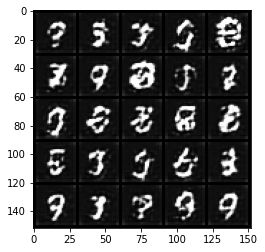

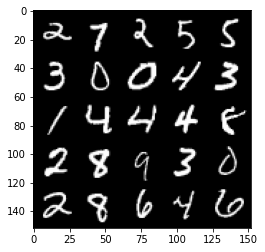

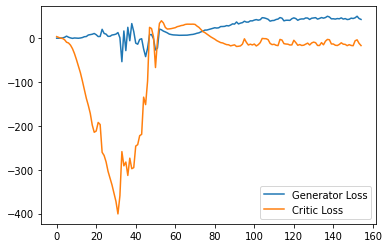

Step 3150: Generator loss: 43.47039688110352, critic loss: -18.979079514503482


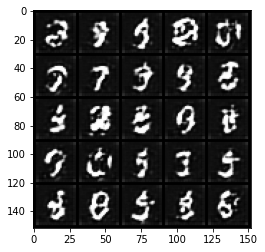

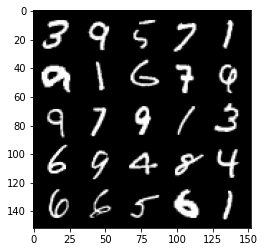

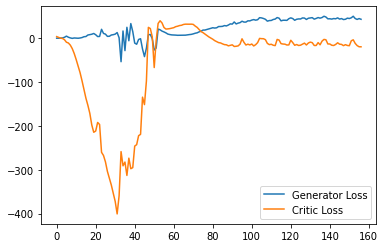

Step 3200: Generator loss: 45.937933464050296, critic loss: -10.114608513832092


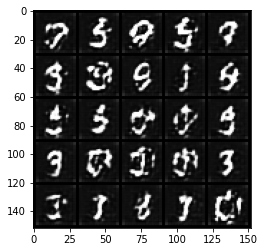

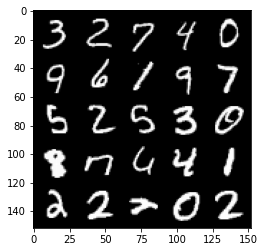

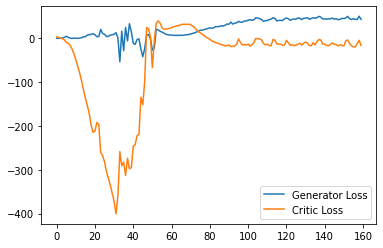

Step 3250: Generator loss: 45.709203491210936, critic loss: -8.765501247406004


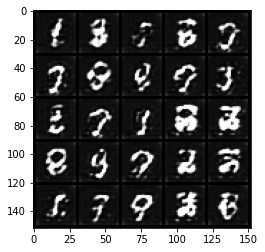

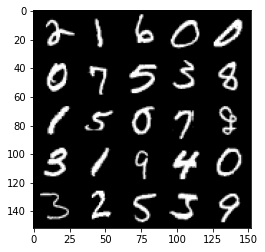

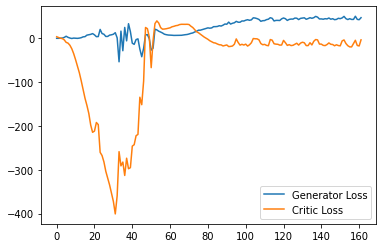

Step 3300: Generator loss: 47.1470076751709, critic loss: -3.1326807193756103


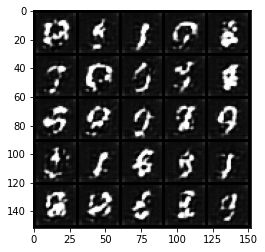

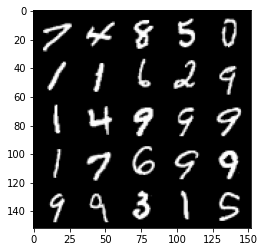

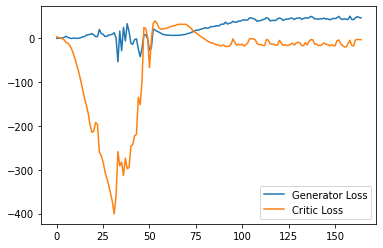

Step 3350: Generator loss: 42.447911224365235, critic loss: -10.652425471305849


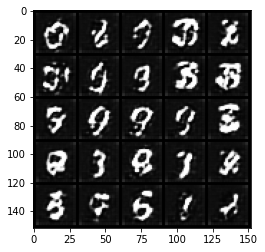

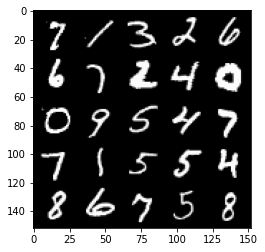

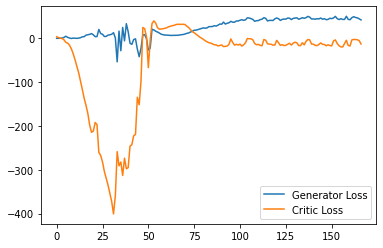

Step 3400: Generator loss: 43.88234252929688, critic loss: -6.395229538917544


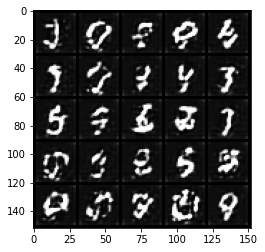

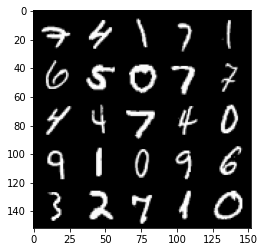

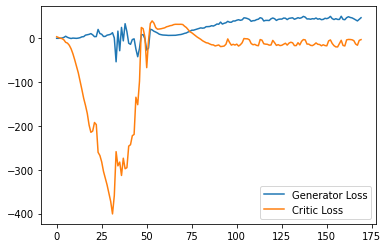

Step 3450: Generator loss: 41.089288024902345, critic loss: -11.179942120552063


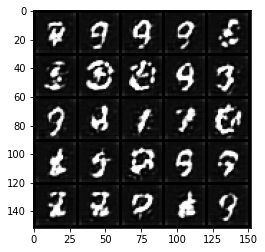

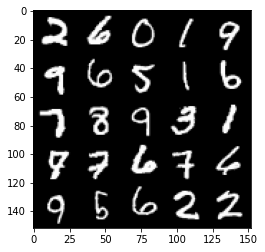

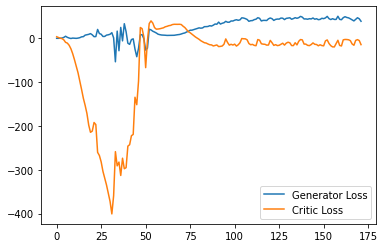

Step 3500: Generator loss: 46.84812889099121, critic loss: -2.582692885398864


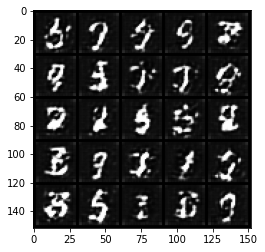

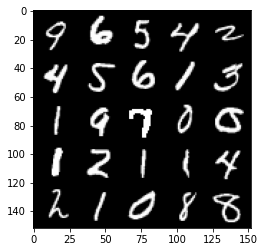

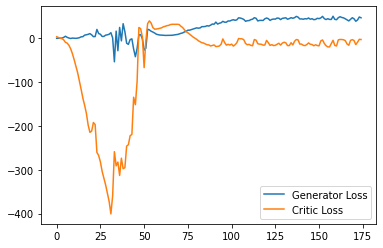

Step 3550: Generator loss: 40.85307273864746, critic loss: -11.058774617195128


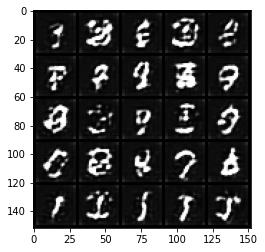

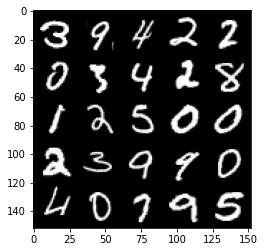

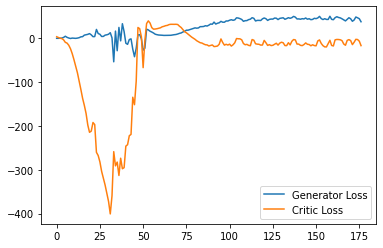

Step 3600: Generator loss: 47.5278702545166, critic loss: -3.7450044536590563


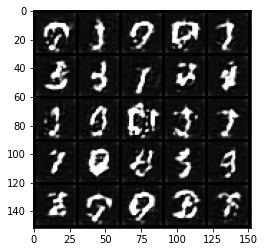

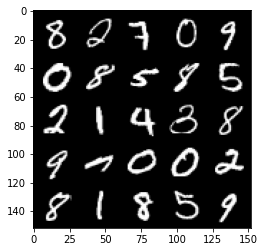

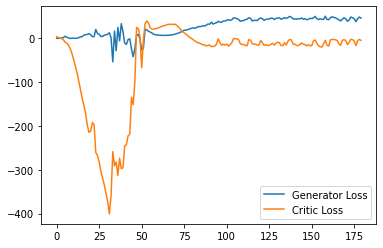

Step 3650: Generator loss: 39.482701263427735, critic loss: -16.921612256526945


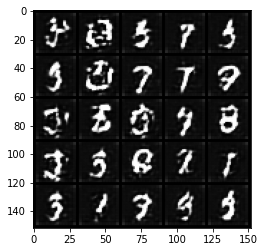

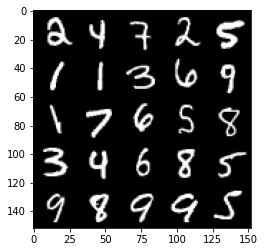

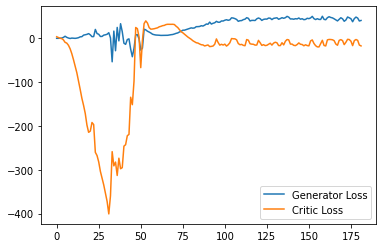

Step 3700: Generator loss: 41.29242515563965, critic loss: -15.602606428623199


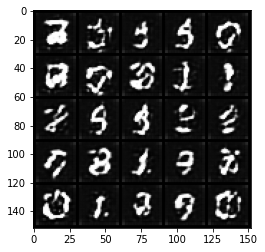

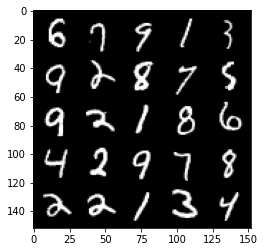

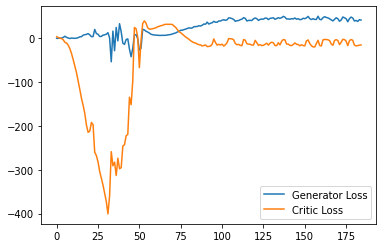

Step 3750: Generator loss: 45.938668746948245, critic loss: -7.988554963588716


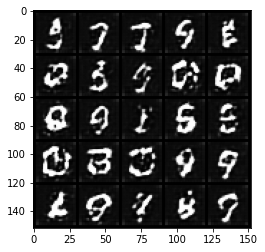

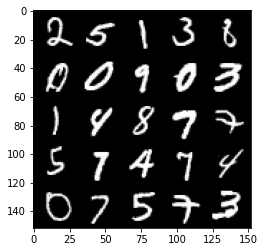

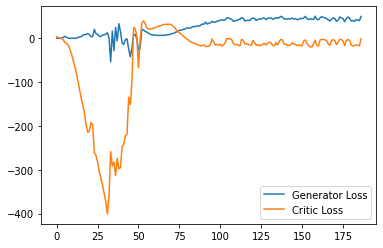

Step 3800: Generator loss: 42.05054859161377, critic loss: -11.82790819311142


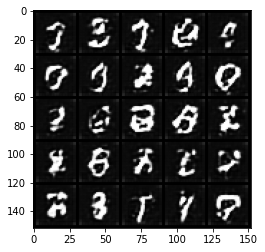

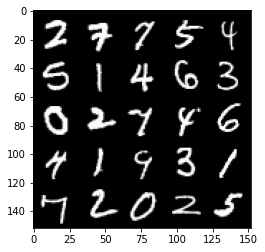

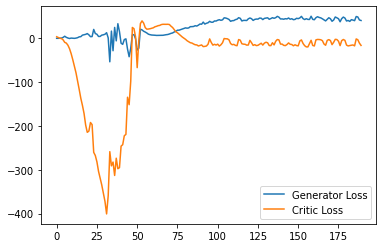

Step 3850: Generator loss: 39.936785202026364, critic loss: -15.74619686794281


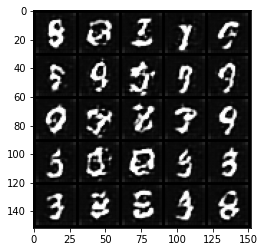

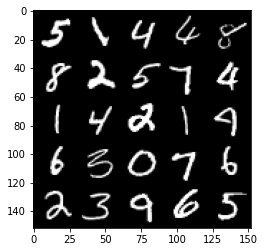

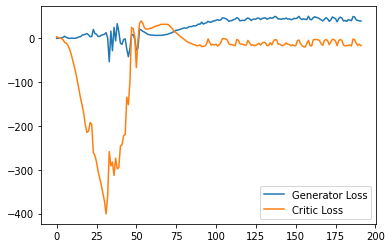

Step 3900: Generator loss: 43.673577575683595, critic loss: -14.452412840843197


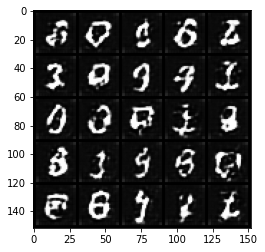

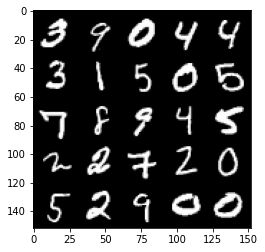

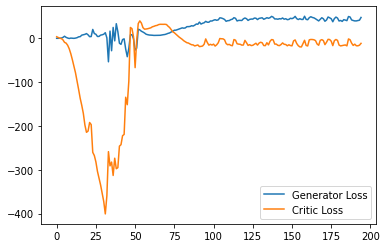

Step 3950: Generator loss: 39.01543510437012, critic loss: -15.479395558357236


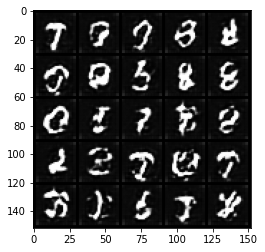

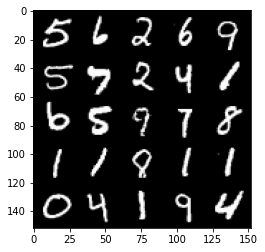

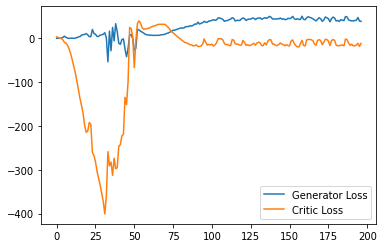

Step 4000: Generator loss: 40.45585105895996, critic loss: -16.48436808347702


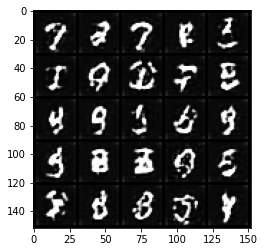

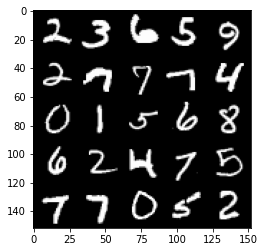

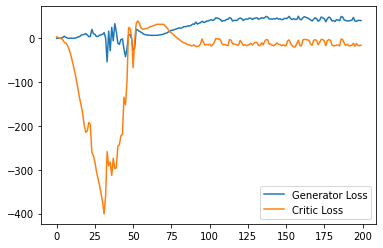

Step 4050: Generator loss: 41.25309028625488, critic loss: -15.982407099723812


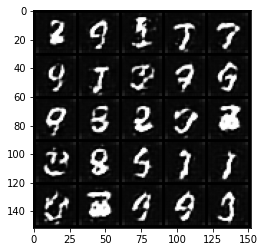

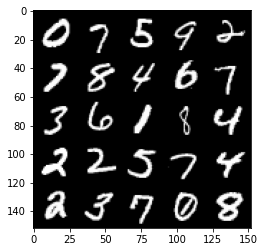

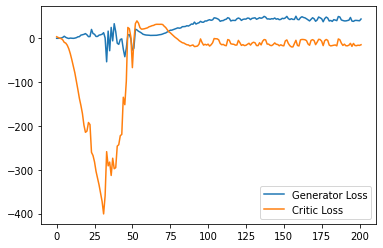

Step 4100: Generator loss: 48.262500534057615, critic loss: 3.1386508250236527


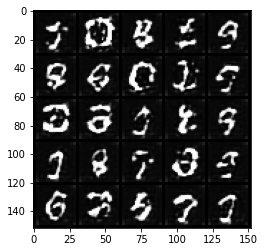

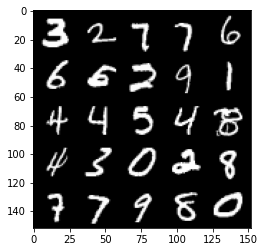

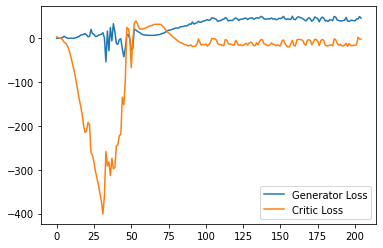

Step 4150: Generator loss: 43.733571701049804, critic loss: -2.125023099422455


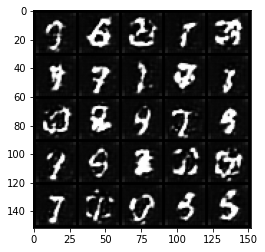

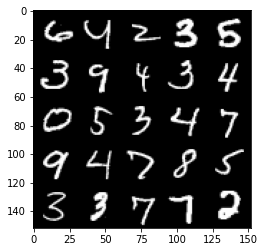

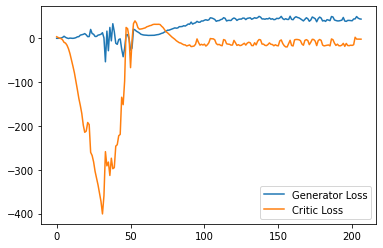

Step 4200: Generator loss: 42.60578018188477, critic loss: -2.577017826080322


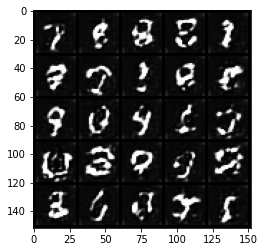

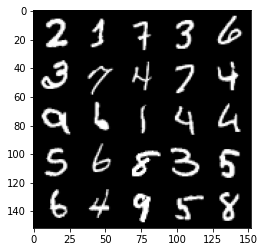

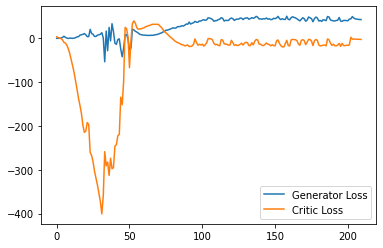

Step 4250: Generator loss: 42.06096893310547, critic loss: -2.7761147680282585


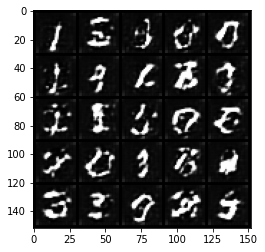

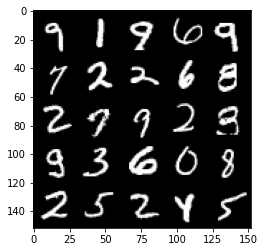

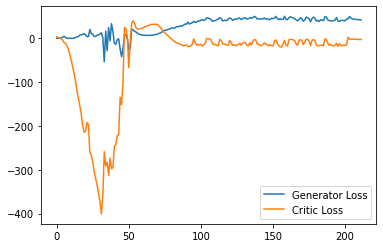

Step 4300: Generator loss: 41.67117851257324, critic loss: -3.448686430931092


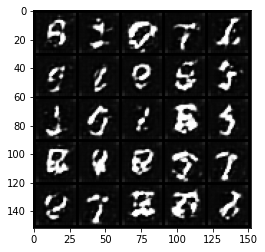

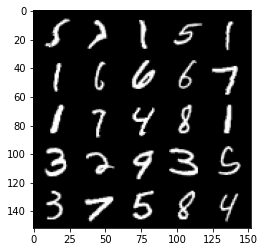

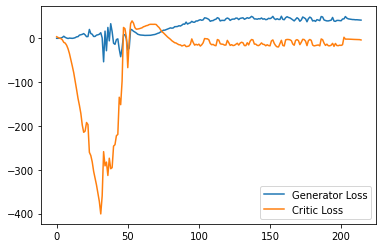

Step 4350: Generator loss: 37.92432312011719, critic loss: -9.898835483551025


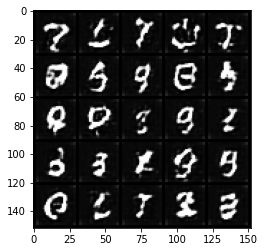

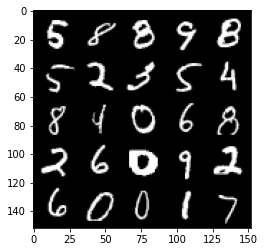

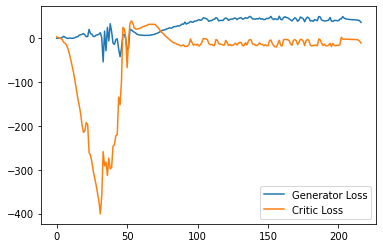

Step 4400: Generator loss: 43.772093276977536, critic loss: -4.139673204421998


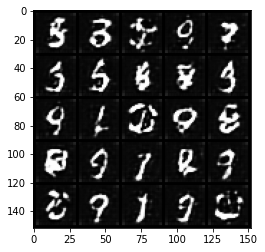

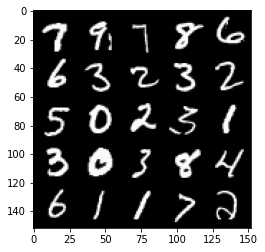

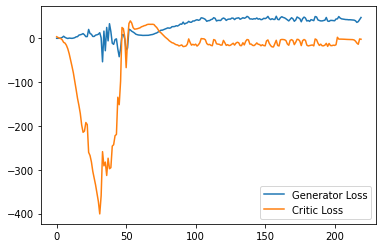

Step 4450: Generator loss: 44.42644844055176, critic loss: -2.7506795377731335


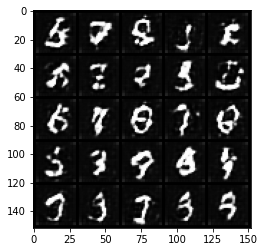

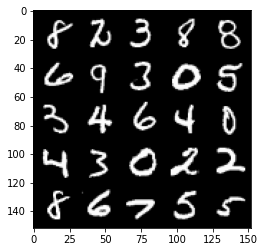

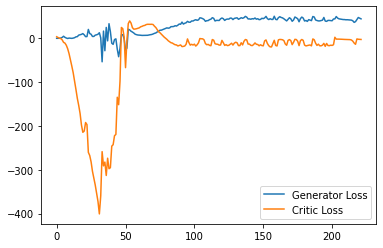

Step 4500: Generator loss: 39.58459098815918, critic loss: -8.894083309173585


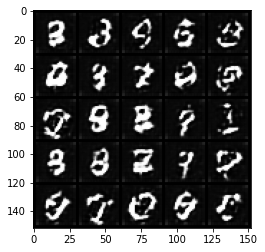

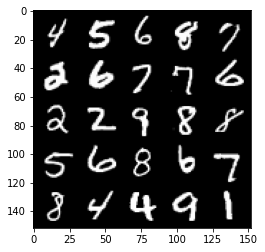

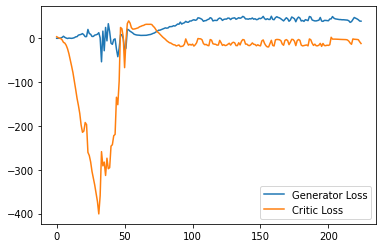

Step 4550: Generator loss: 37.77827655792236, critic loss: -14.86296515202522


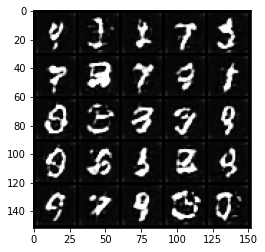

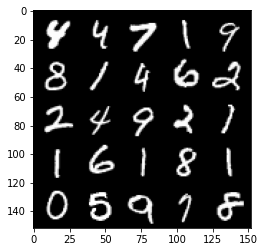

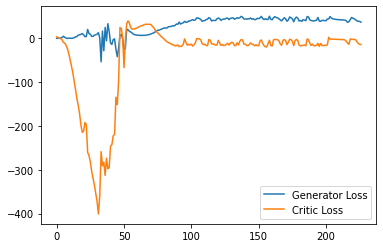

Step 4600: Generator loss: 38.736943588256835, critic loss: -15.25289204072952


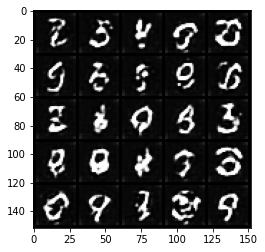

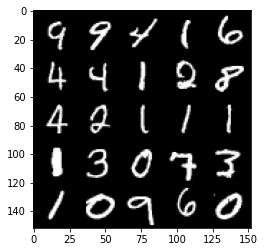

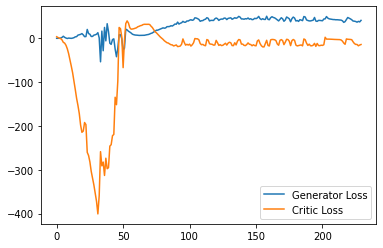

Step 4650: Generator loss: 45.71534652709961, critic loss: -4.423912227153779


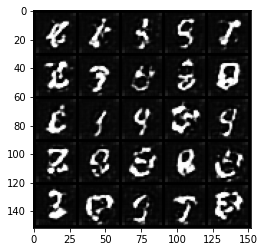

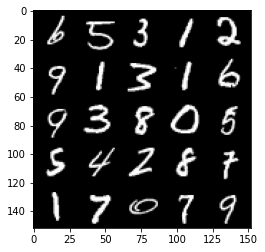

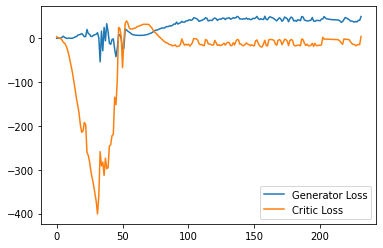

Step 4700: Generator loss: 45.75035026550293, critic loss: -3.8546382427215575


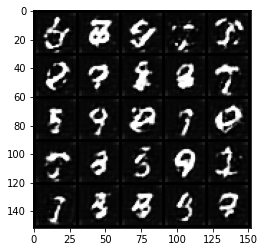

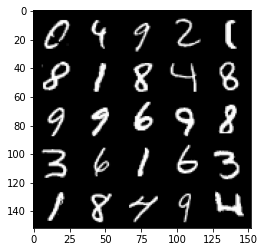

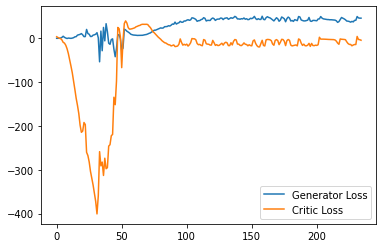

Step 4750: Generator loss: 38.73810043334961, critic loss: -15.12830128240585


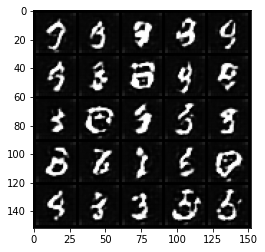

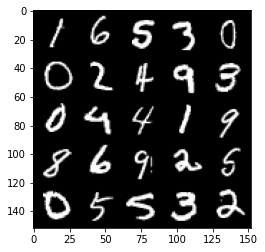

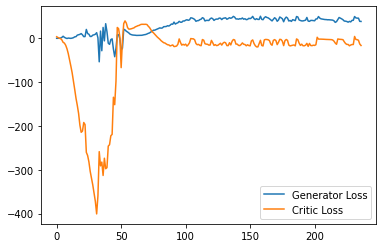

Step 4800: Generator loss: 41.126212692260744, critic loss: -14.829041959285735


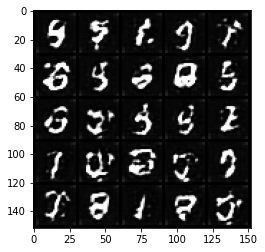

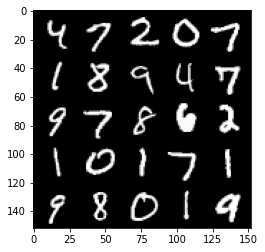

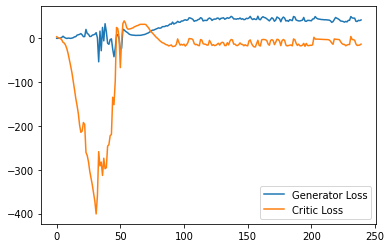

Step 4850: Generator loss: 41.5576057434082, critic loss: -14.19033333873748


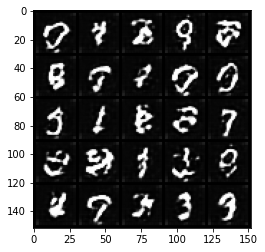

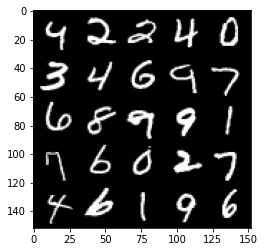

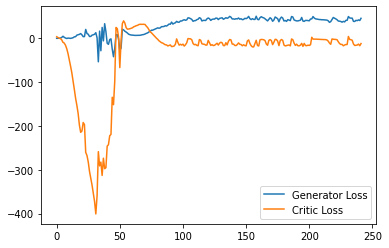

Step 4900: Generator loss: 39.6135884475708, critic loss: -11.902016726016996


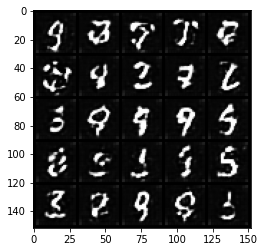

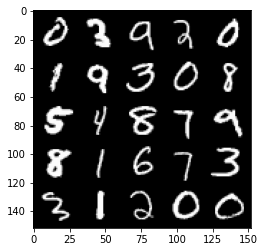

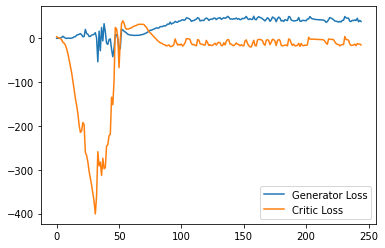

Step 4950: Generator loss: 45.85011085510254, critic loss: -4.167218784332275


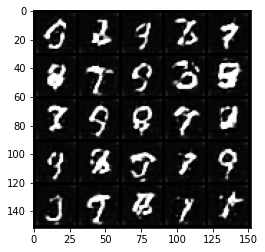

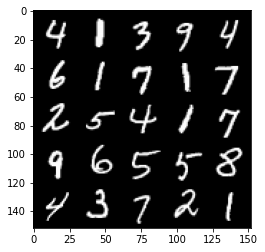

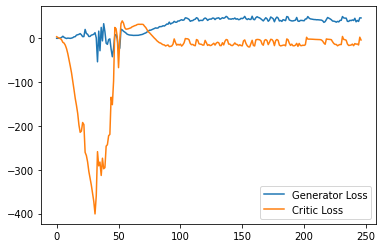

Step 5000: Generator loss: 39.00372241973877, critic loss: -14.491210659503938


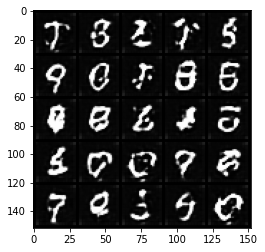

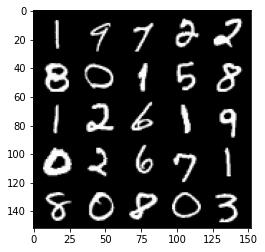

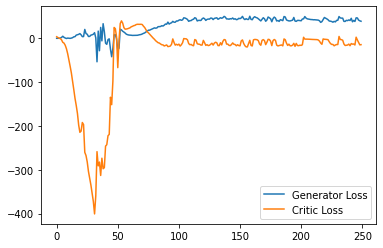

Step 5050: Generator loss: 41.55952365875244, critic loss: -12.180524092674256


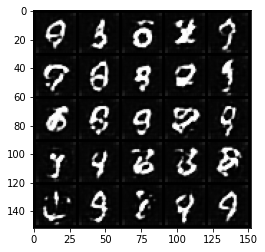

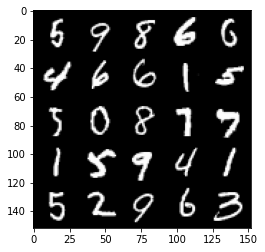

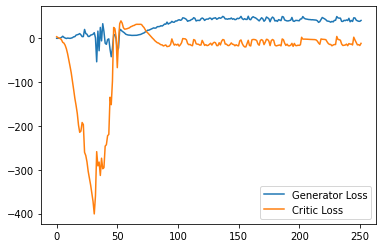

Step 5100: Generator loss: 39.853892669677734, critic loss: -14.190299929618837


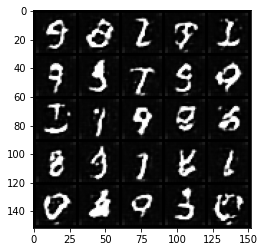

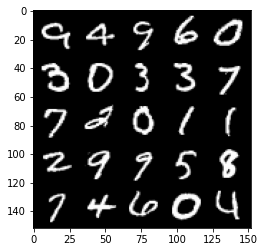

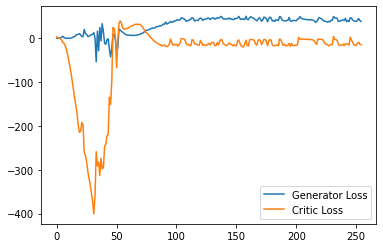

Step 5150: Generator loss: 45.8741333770752, critic loss: -9.989755144596101


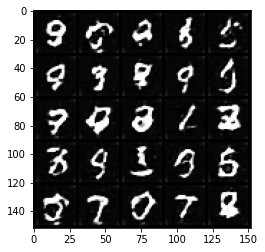

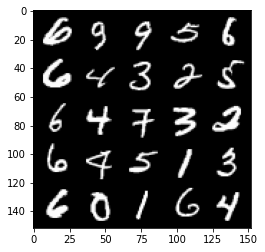

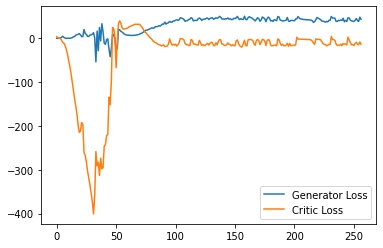

Step 5200: Generator loss: 39.70194599151611, critic loss: -12.185338254451754


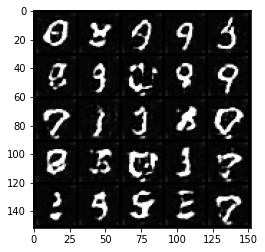

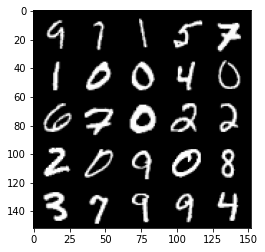

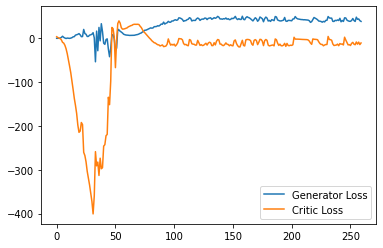

Step 5250: Generator loss: 47.44159858703613, critic loss: -4.950733171939851


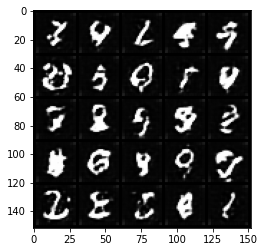

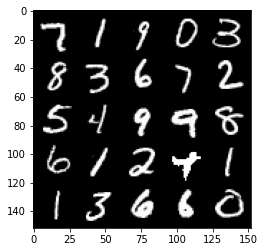

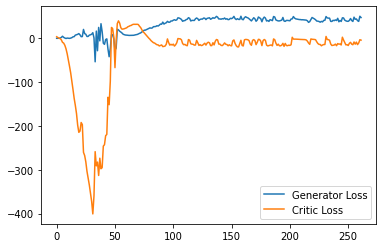

Step 5300: Generator loss: 41.440199584960936, critic loss: -12.510930403232576


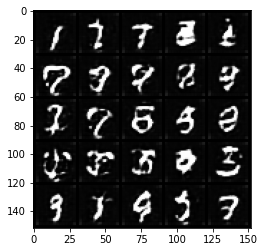

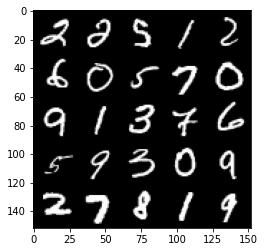

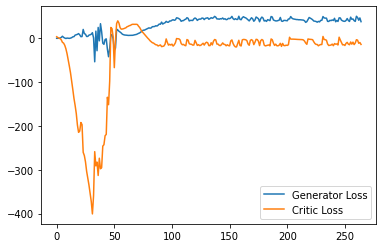

Step 5350: Generator loss: 41.60396461486816, critic loss: -14.083759936332699


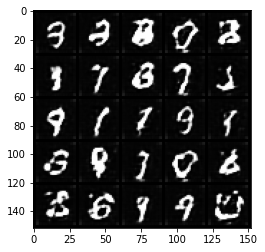

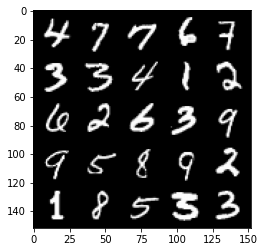

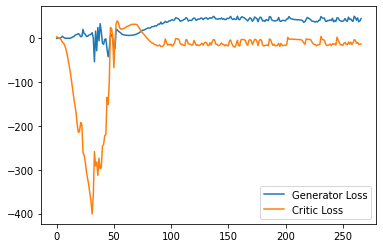

Step 5400: Generator loss: 37.57742794036865, critic loss: -15.91789484167099


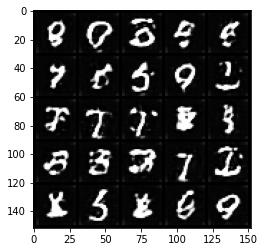

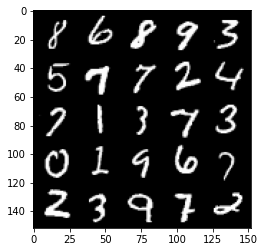

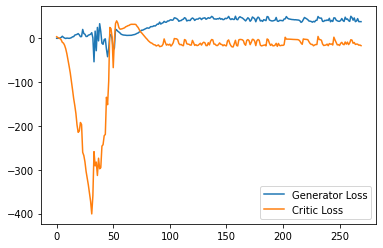

Step 5450: Generator loss: 48.49550033569336, critic loss: -2.2664449925422674


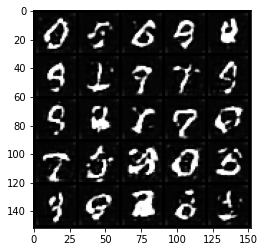

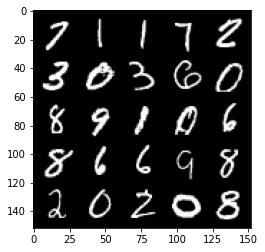

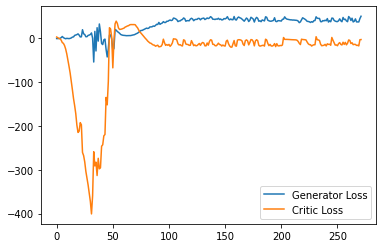

Step 5500: Generator loss: 46.099161071777345, critic loss: -2.493173282146454


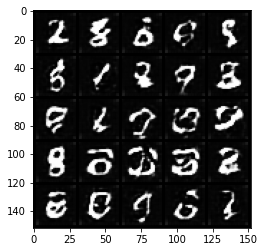

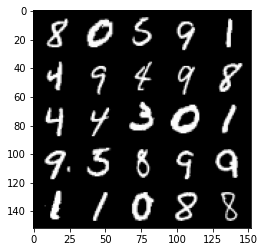

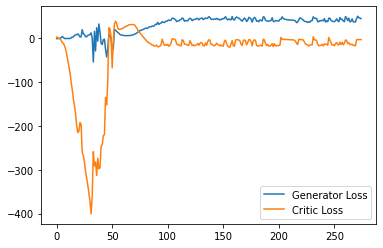

Step 5550: Generator loss: 44.03426803588867, critic loss: -2.8852184696197507


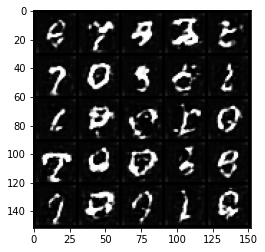

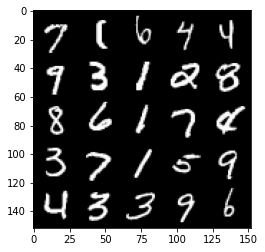

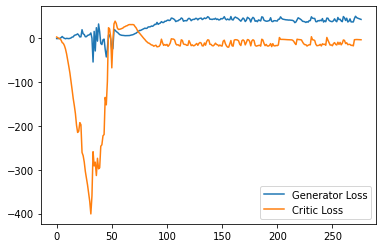

Step 5600: Generator loss: 43.242773361206055, critic loss: -3.4699930553436262


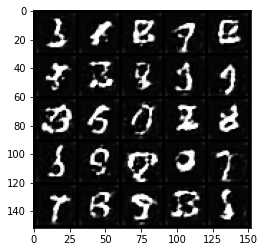

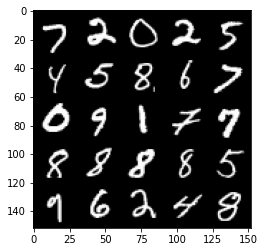

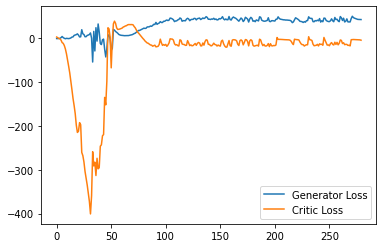

Step 5650: Generator loss: 39.13055591583252, critic loss: -11.936097039699552


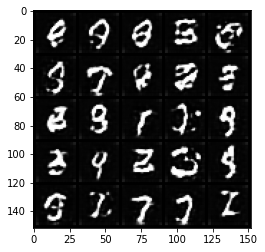

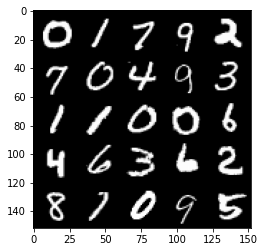

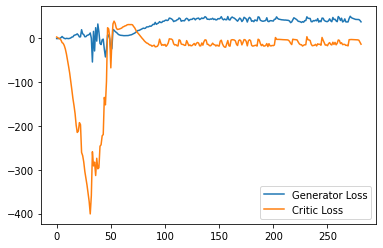

Step 5700: Generator loss: 40.14303813934326, critic loss: -14.338203844547268


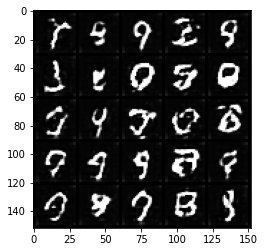

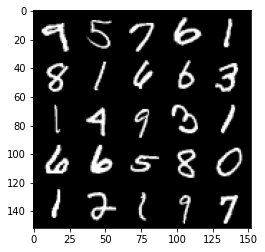

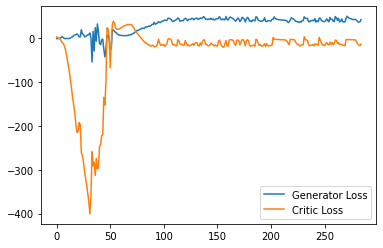

Step 5750: Generator loss: 41.79018341064453, critic loss: -14.046315658092501


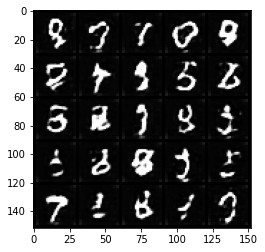

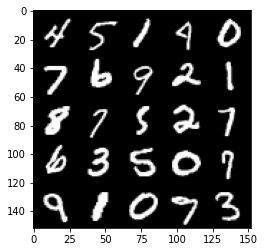

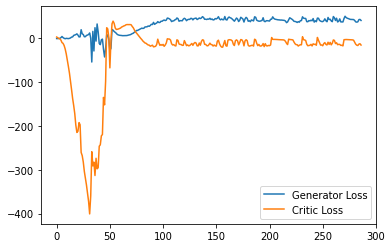

Step 5800: Generator loss: 39.19859119415283, critic loss: -17.239752851486205


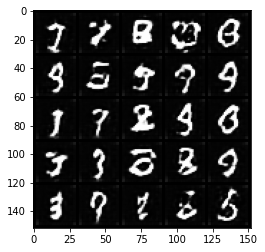

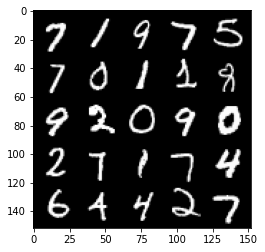

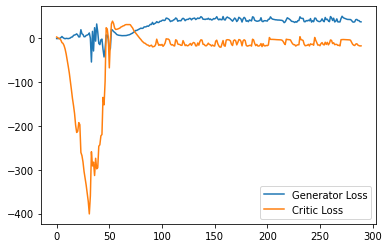

Step 5850: Generator loss: 43.71655250549316, critic loss: -13.57200489068031


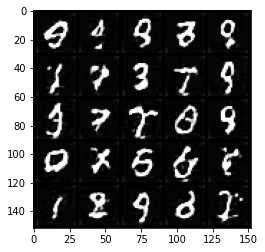

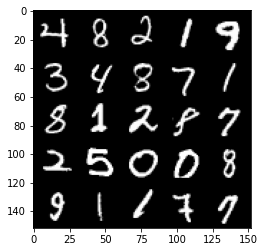

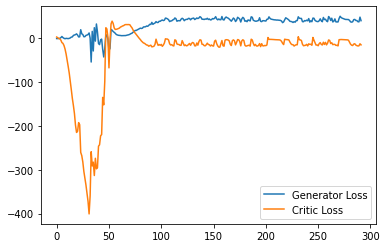

Step 5900: Generator loss: 45.306922912597656, critic loss: -9.783986316204073


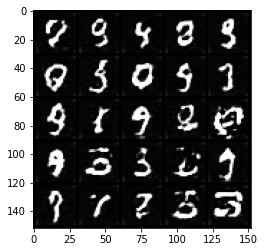

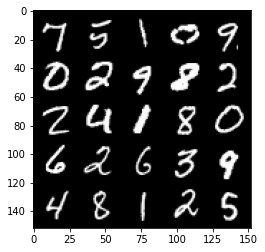

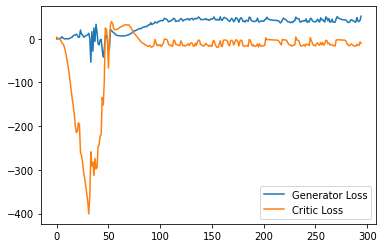

Step 5950: Generator loss: 42.09838455200195, critic loss: -14.718339671611787


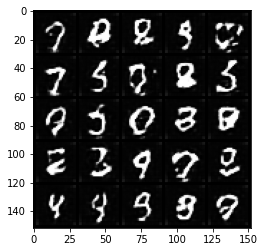

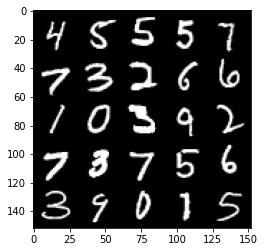

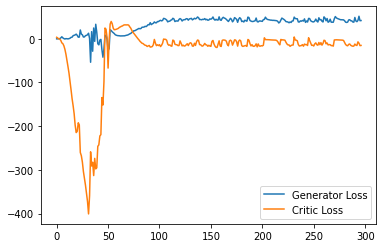

Step 6000: Generator loss: 40.11371849060058, critic loss: -17.457048312187197


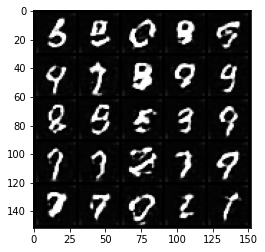

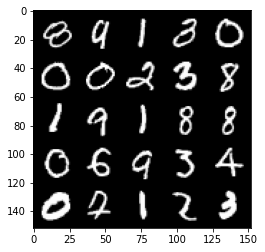

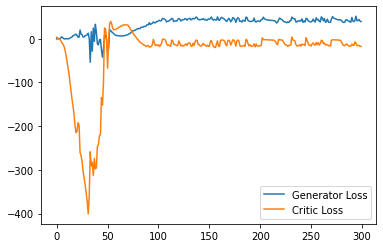

Step 6050: Generator loss: 45.77855392456055, critic loss: -9.444301889896392


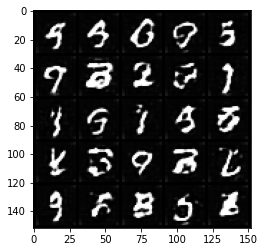

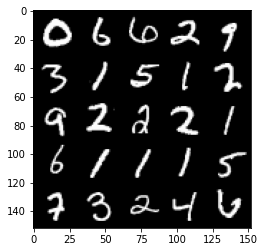

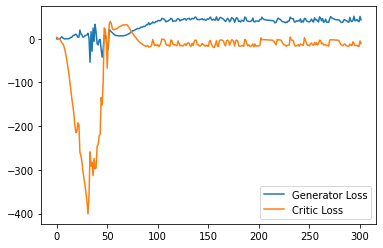

Step 6100: Generator loss: 45.52828079223633, critic loss: -13.756938056468961


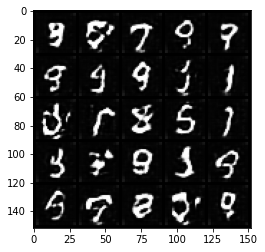

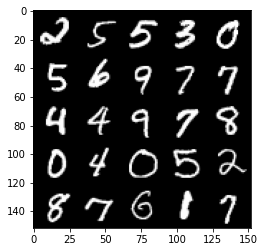

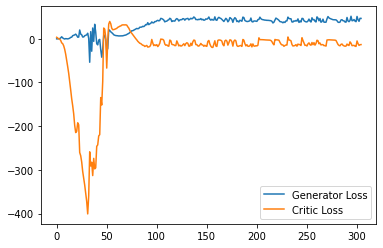

Step 6150: Generator loss: 41.27275245666504, critic loss: -16.31199233269692


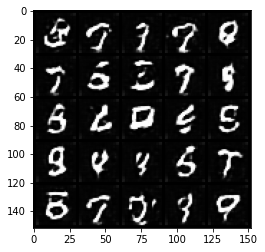

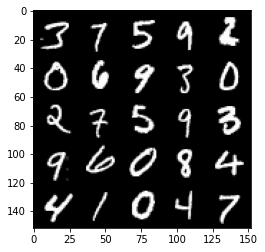

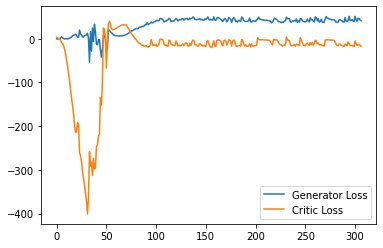

Step 6200: Generator loss: 43.30383399963379, critic loss: -15.18418537425995


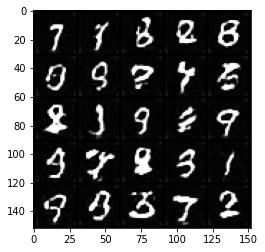

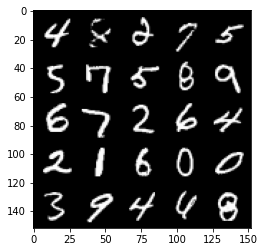

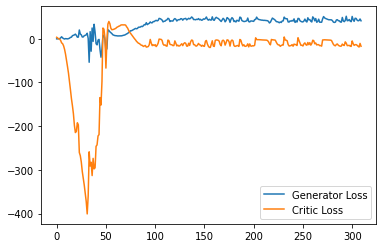

Step 6250: Generator loss: 40.27460968017578, critic loss: -16.575831596851344


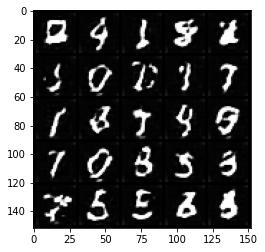

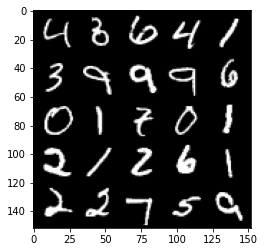

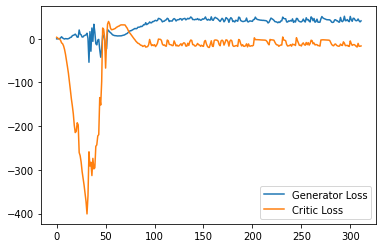

Step 6300: Generator loss: 40.91299896240234, critic loss: -17.08071626806259


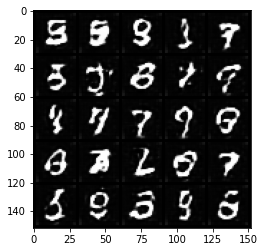

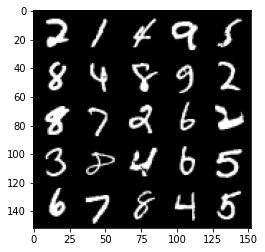

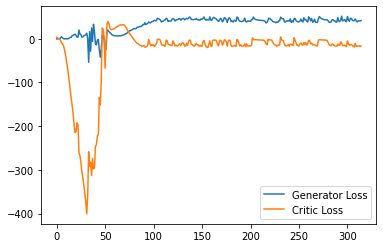

Step 6350: Generator loss: 42.15108406066894, critic loss: -16.98913736534118


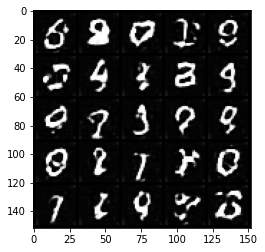

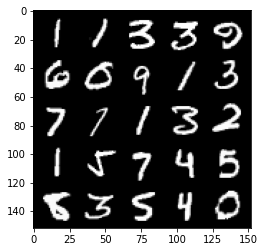

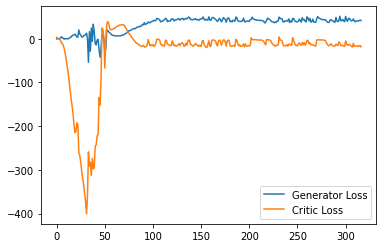

Step 6400: Generator loss: 46.74784358978272, critic loss: -7.245324684619903


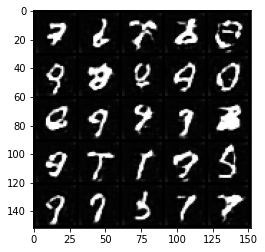

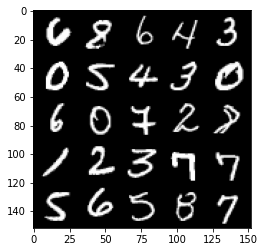

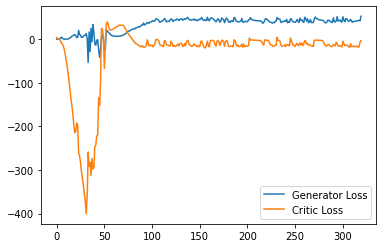

Step 6450: Generator loss: 44.04136039733887, critic loss: -13.105285248279575


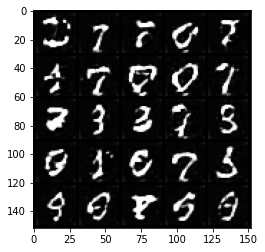

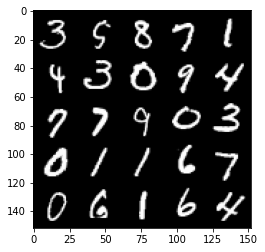

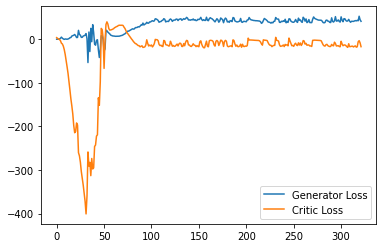

Step 6500: Generator loss: 43.464081268310544, critic loss: -14.251464709758755


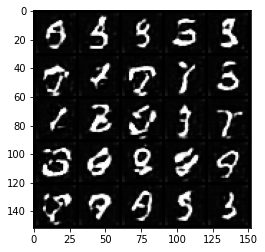

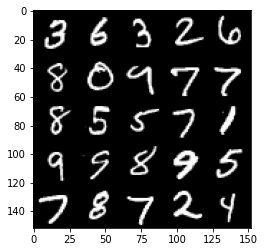

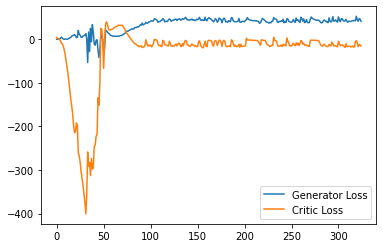

Step 6550: Generator loss: 43.94777015686035, critic loss: -15.123915610313416


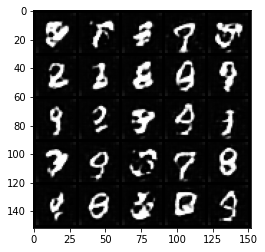

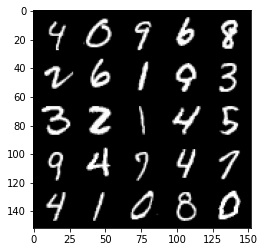

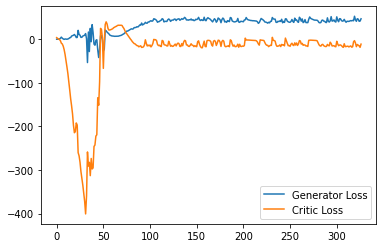

Step 6600: Generator loss: 45.81492073059082, critic loss: -13.600096289396282


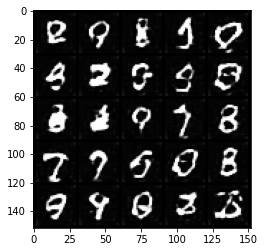

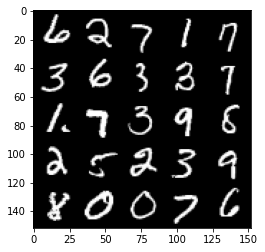

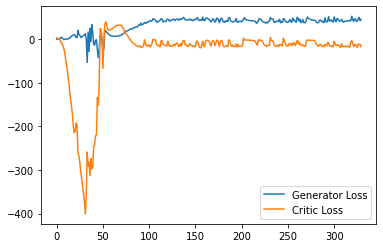

Step 6650: Generator loss: 46.74093307495117, critic loss: -14.30486578512191


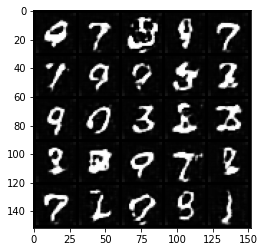

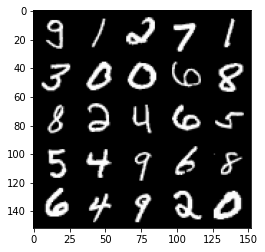

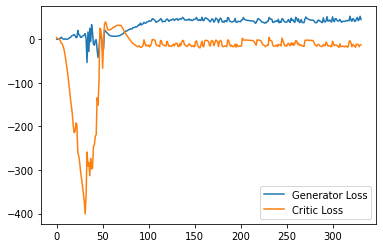

Step 6700: Generator loss: 45.35704025268555, critic loss: -15.207565581321711


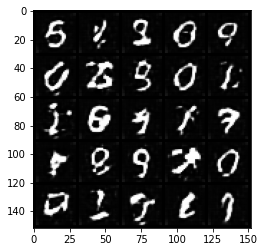

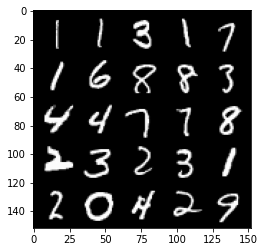

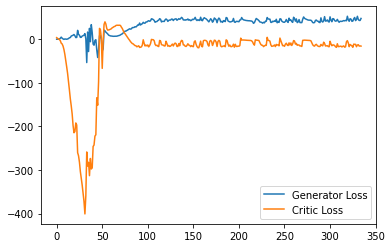

Step 6750: Generator loss: 49.05180473327637, critic loss: -5.3310938634872445


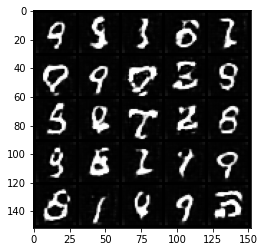

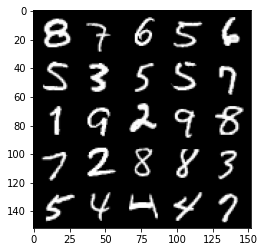

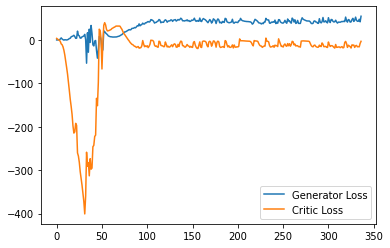

Step 6800: Generator loss: 43.92853775024414, critic loss: -13.715639259338378


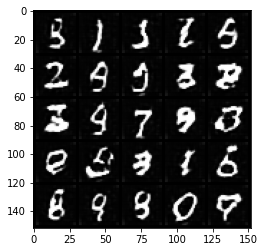

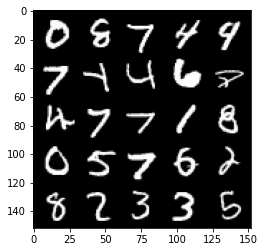

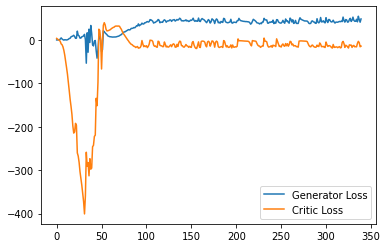

Step 6850: Generator loss: 48.949116439819335, critic loss: -13.821993549346923


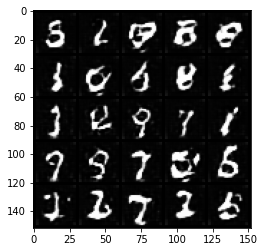

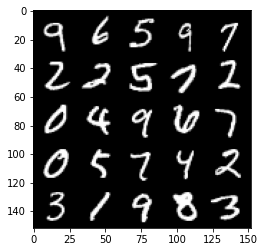

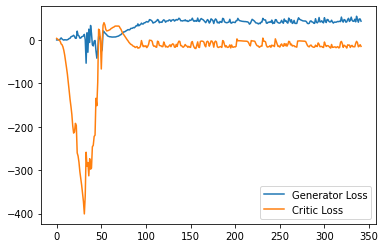

Step 6900: Generator loss: 43.16223083496094, critic loss: -14.914152242183684


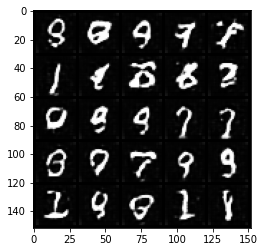

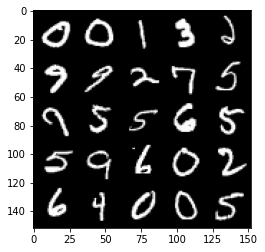

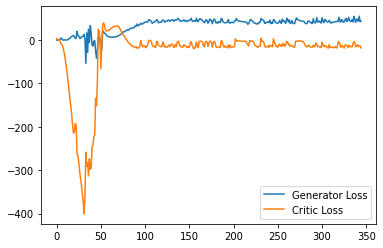

Step 6950: Generator loss: 52.33810512542725, critic loss: -11.11107562065124


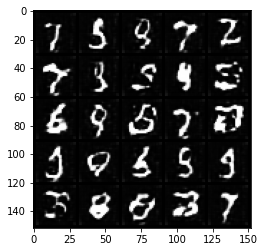

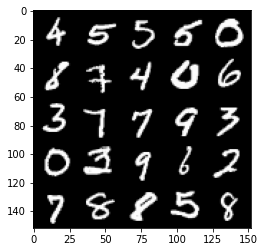

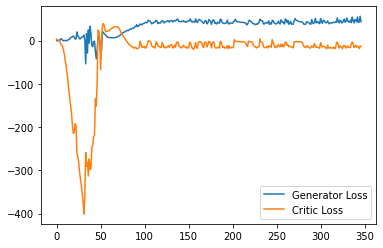

Step 7000: Generator loss: 46.06511817932129, critic loss: -8.475396162509917


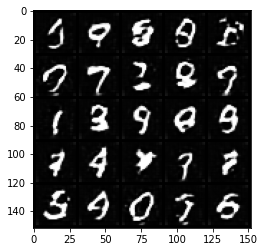

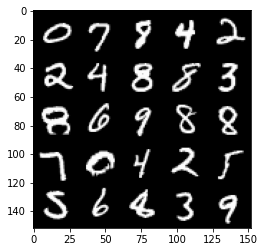

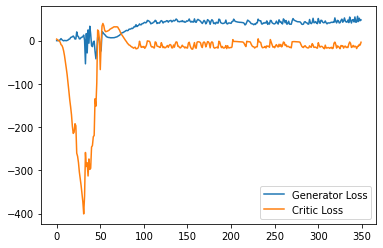

Step 7050: Generator loss: 50.42082473754883, critic loss: -6.651526146888735


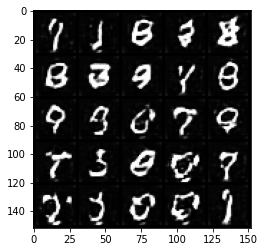

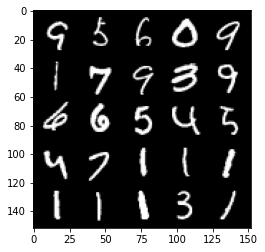

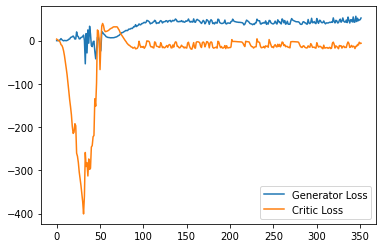

Step 7100: Generator loss: 45.685105895996095, critic loss: -14.638311786651613


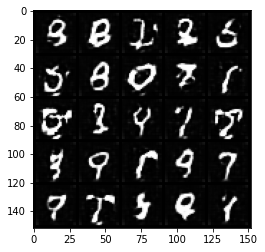

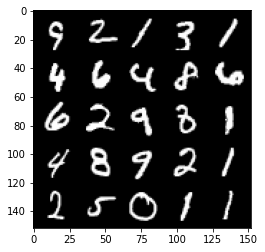

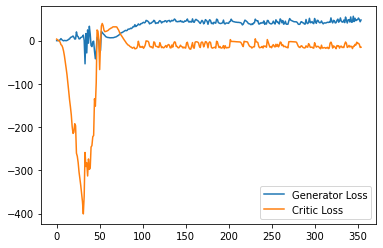

Step 7150: Generator loss: 44.587410316467285, critic loss: -16.92311696767807


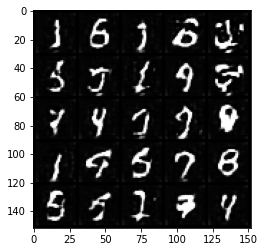

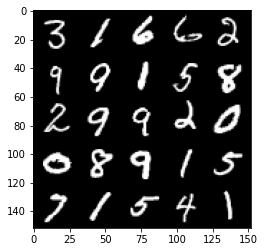

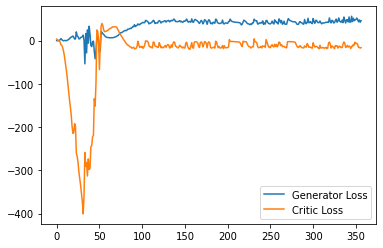

Step 7200: Generator loss: 49.93830619812012, critic loss: -17.200806484222415


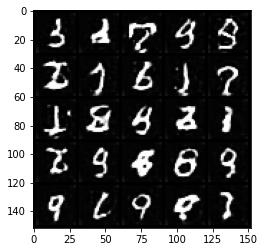

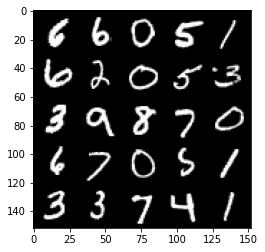

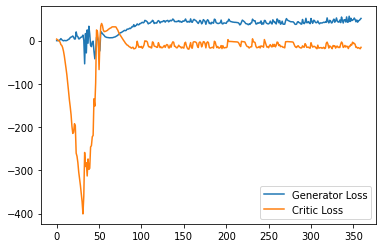

Step 7250: Generator loss: 51.524303665161135, critic loss: -11.268747373580931


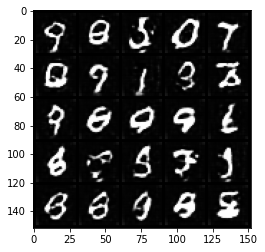

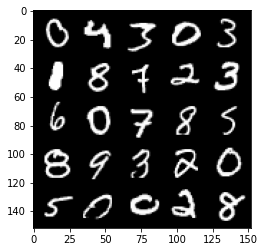

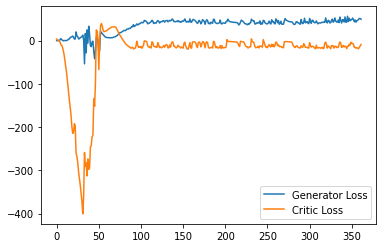

Step 7300: Generator loss: 49.98498695373535, critic loss: -13.78677782654762


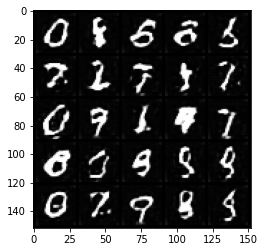

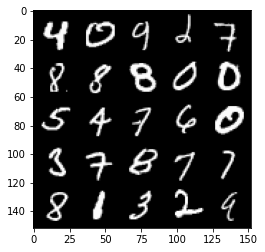

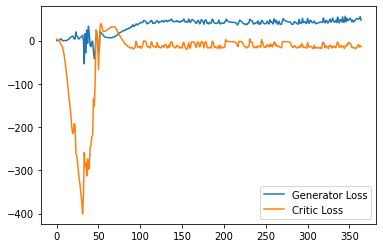

Step 7350: Generator loss: 50.466231231689456, critic loss: -14.65466358613967


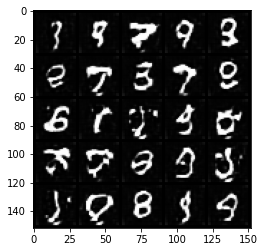

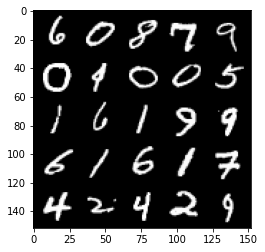

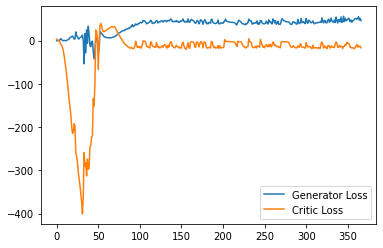

Step 7400: Generator loss: 49.17709503173828, critic loss: -15.943742980480192


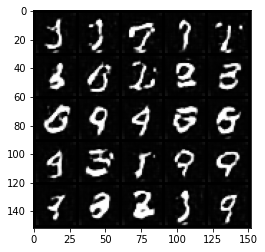

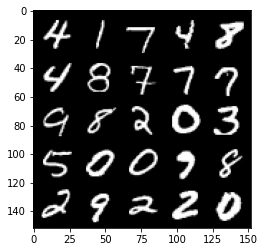

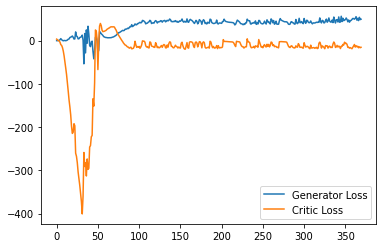

Step 7450: Generator loss: 50.84722229003906, critic loss: -14.175074992656702


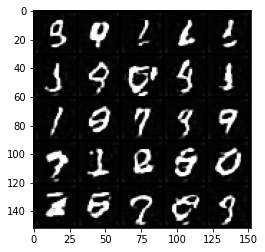

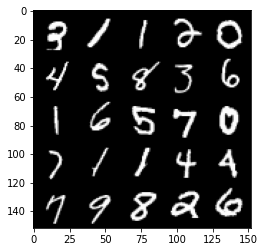

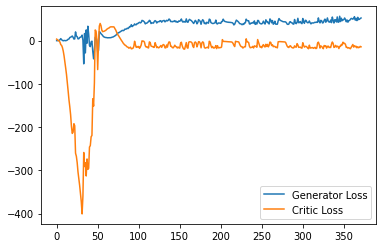

Step 7500: Generator loss: 52.8996696472168, critic loss: -13.851180676460269


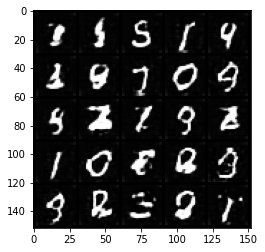

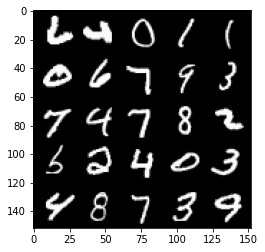

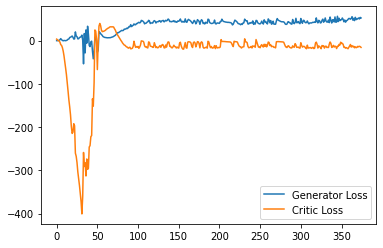

Step 7550: Generator loss: 51.10138656616211, critic loss: -13.135826494693761


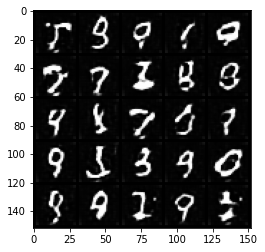

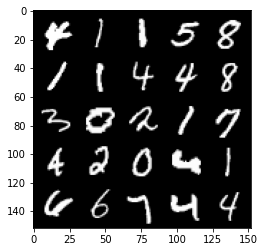

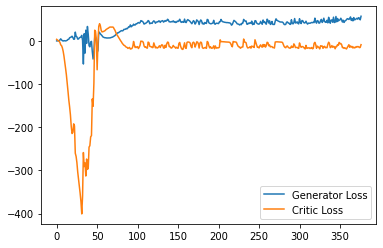

Step 7600: Generator loss: 53.44478065490723, critic loss: -13.68294912862778


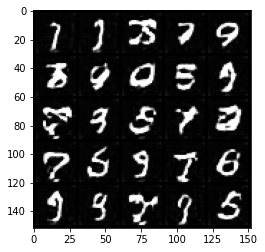

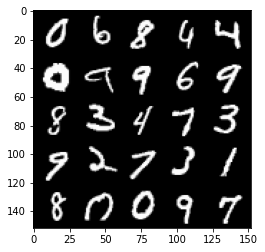

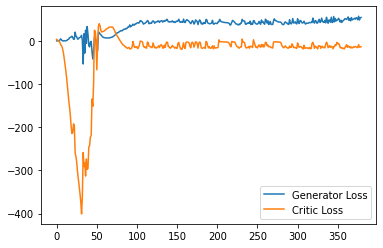

Step 7650: Generator loss: 57.266549835205076, critic loss: -11.843473058223722


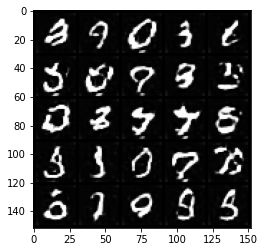

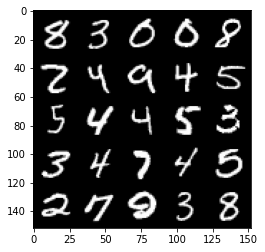

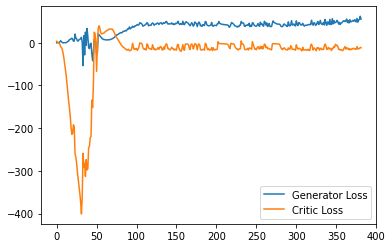

Step 7700: Generator loss: 51.818327255249024, critic loss: -14.944599735260015


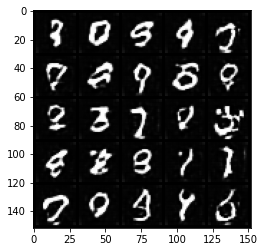

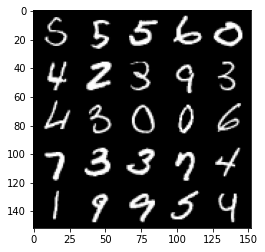

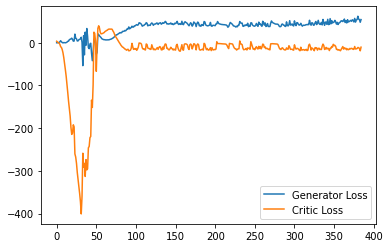

Step 7750: Generator loss: 52.29019012451172, critic loss: -13.944966480255125


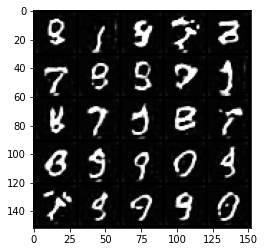

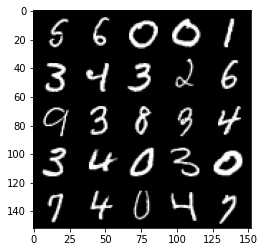

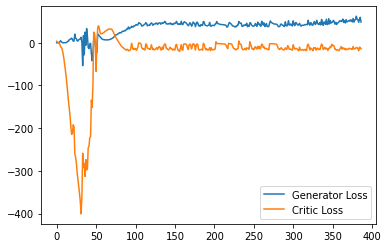

Step 7800: Generator loss: 52.31497528076172, critic loss: -12.632162337303166


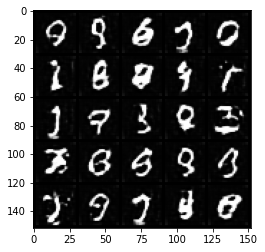

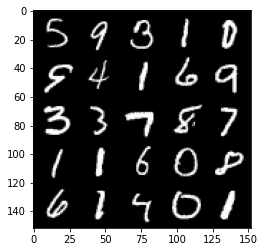

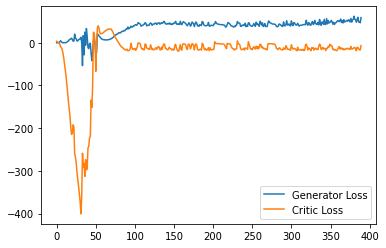

Step 7850: Generator loss: 55.50599487304687, critic loss: -11.228084602355954


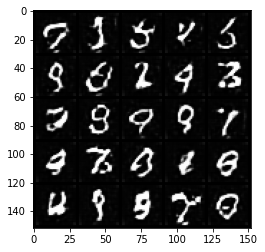

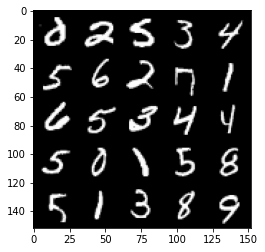

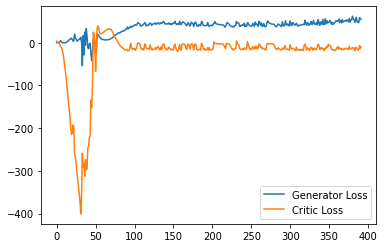

Step 7900: Generator loss: 56.0077082824707, critic loss: -16.24249242830276


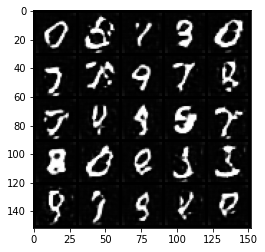

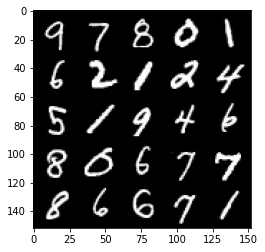

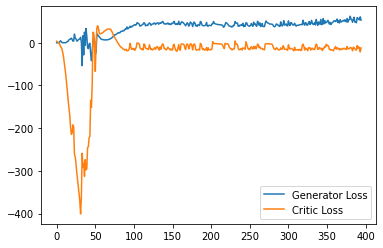

Step 7950: Generator loss: 56.25273811340332, critic loss: -11.503452135562897


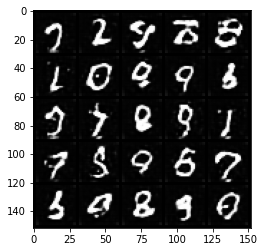

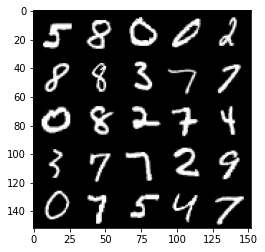

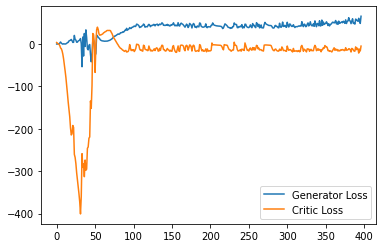

Step 8000: Generator loss: 54.78034805297852, critic loss: -12.780328963279725


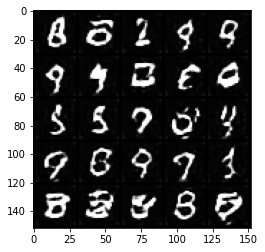

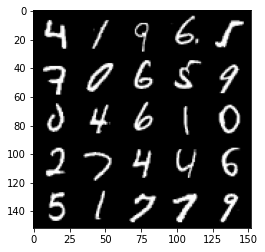

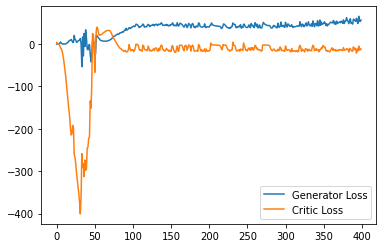

Step 8050: Generator loss: 55.385650100708006, critic loss: -12.51699838209152


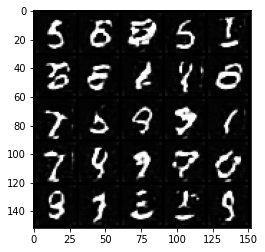

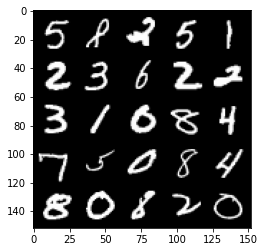

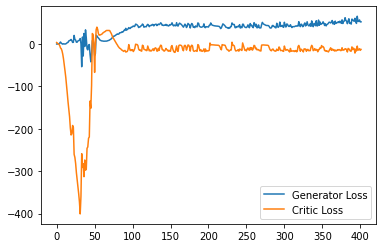

Step 8100: Generator loss: 55.56317543029785, critic loss: -14.163863316059116


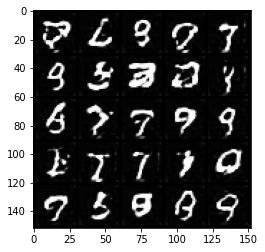

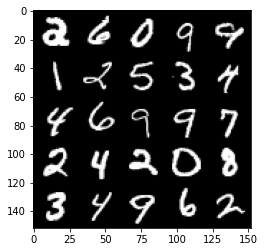

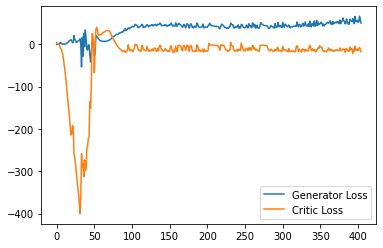

Step 8150: Generator loss: 58.360814514160154, critic loss: -13.593944596767424


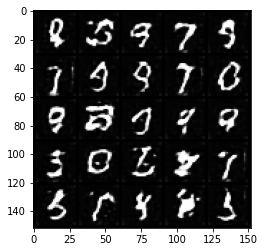

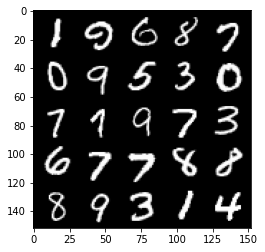

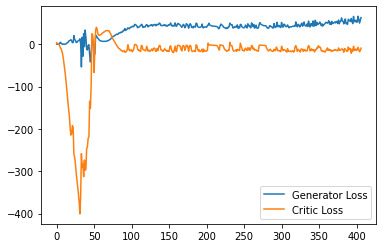

Step 8200: Generator loss: 55.46926780700684, critic loss: -13.205232881546017


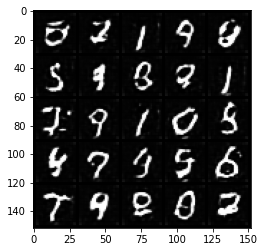

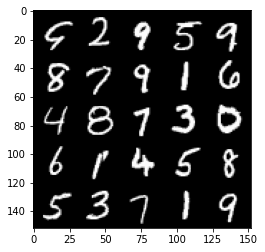

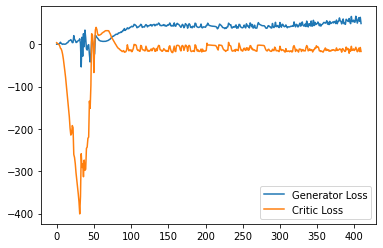

Step 8250: Generator loss: 53.3141081237793, critic loss: -17.57193546819687


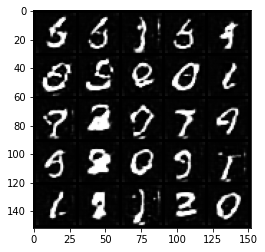

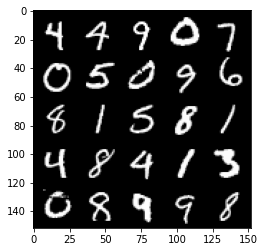

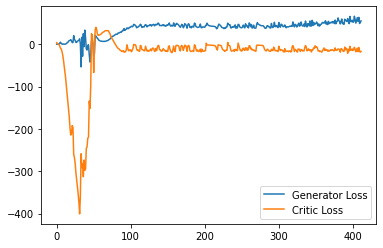

Step 8300: Generator loss: 53.010838928222654, critic loss: -17.62055314731598


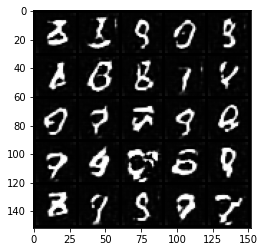

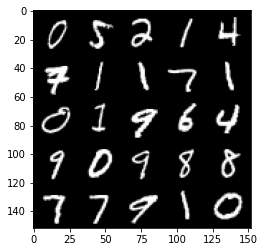

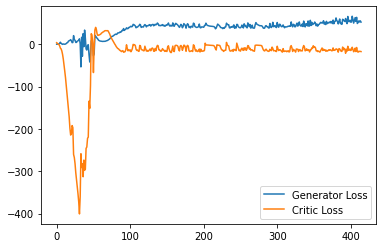

Step 8350: Generator loss: 56.756746978759764, critic loss: -9.555383152961731


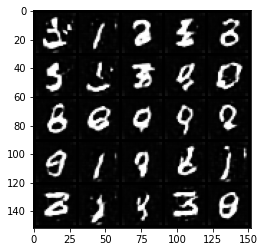

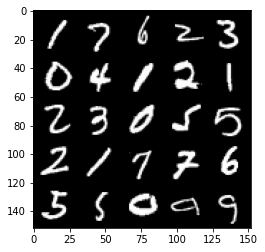

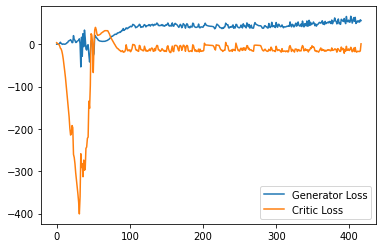

Step 8400: Generator loss: 55.44102180480957, critic loss: -17.68392760801315


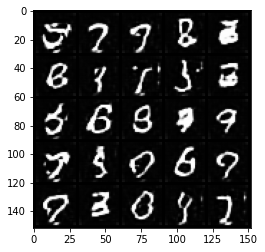

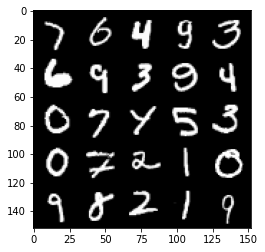

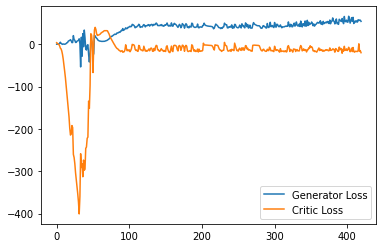

Step 8450: Generator loss: 57.89131790161133, critic loss: -17.219857171058653


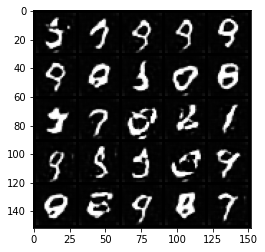

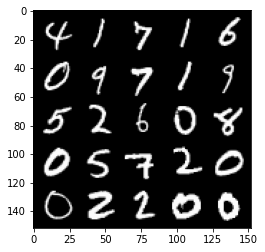

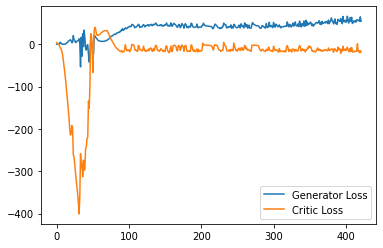

Step 8500: Generator loss: 60.09804786682129, critic loss: -16.057918062210092


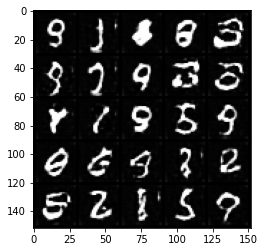

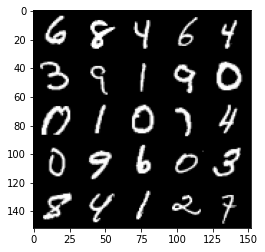

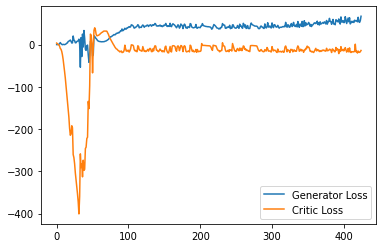

Step 8550: Generator loss: 61.14968940734863, critic loss: -12.863887233257289


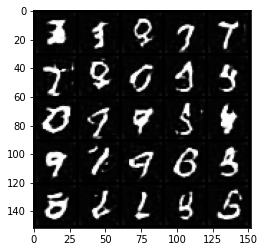

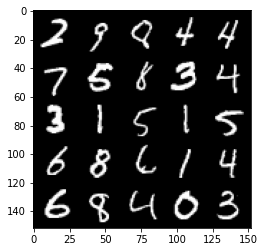

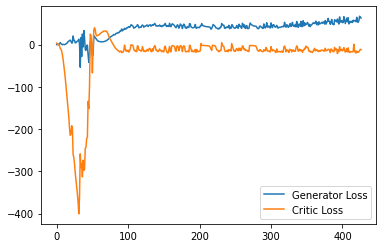

Step 8600: Generator loss: 62.1346134185791, critic loss: -12.69283077979088


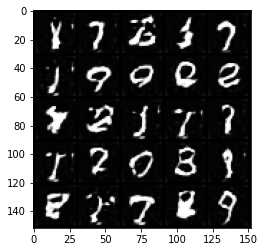

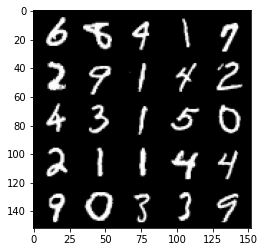

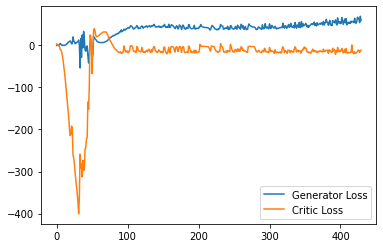

Step 8650: Generator loss: 54.371554641723634, critic loss: -14.36976125907898


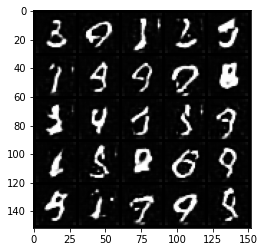

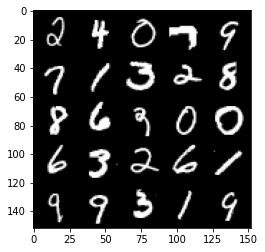

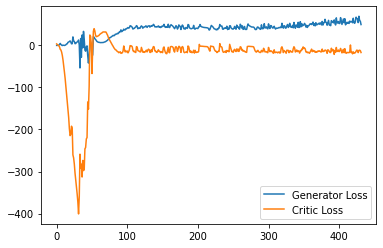

Step 8700: Generator loss: 59.75899436950684, critic loss: -15.944840623617177


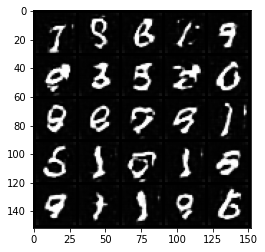

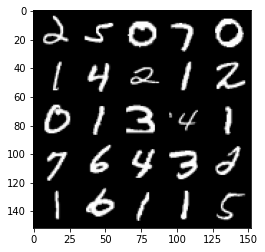

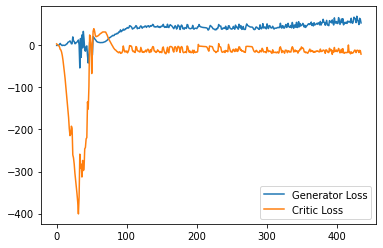

Step 8750: Generator loss: 61.93610996246338, critic loss: -10.584499429225923


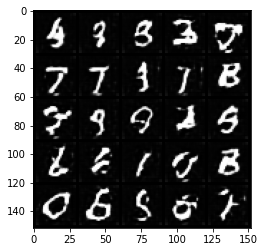

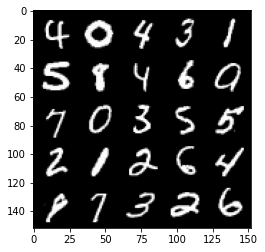

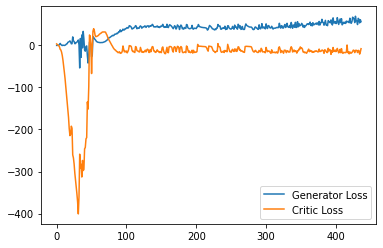

Step 8800: Generator loss: 58.912995986938476, critic loss: -14.679104191541674


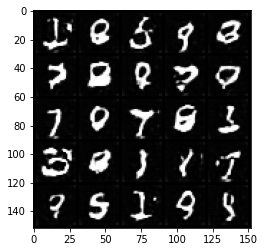

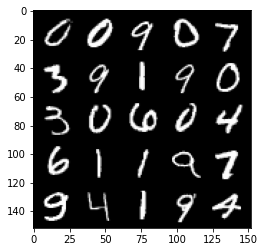

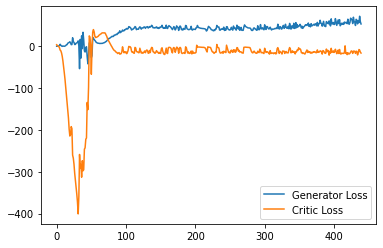

Step 8850: Generator loss: 60.38974754333496, critic loss: -14.88986785125732


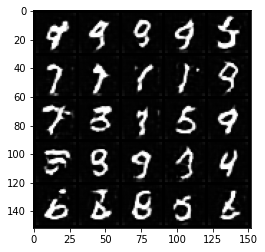

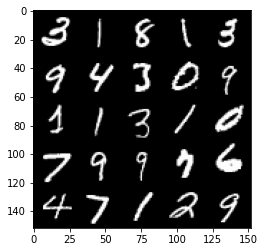

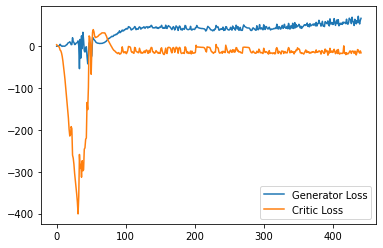

Step 8900: Generator loss: 63.14775764465332, critic loss: -0.7746784613132472


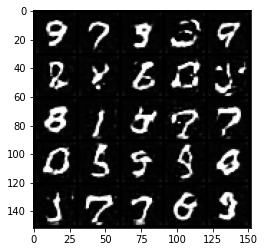

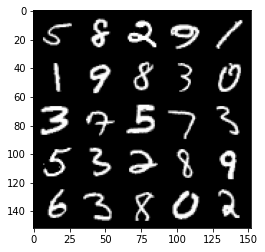

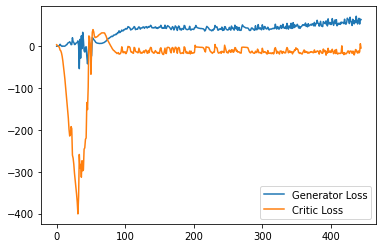

Step 8950: Generator loss: 63.53711280822754, critic loss: -9.607279824733734


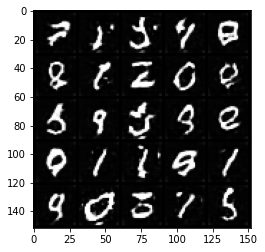

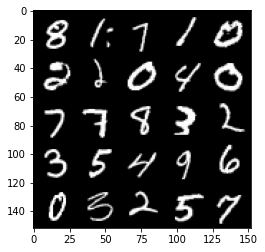

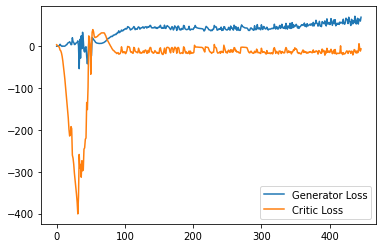

Step 9000: Generator loss: 57.848366775512694, critic loss: -15.375941651344299


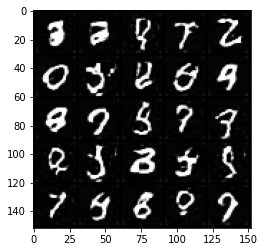

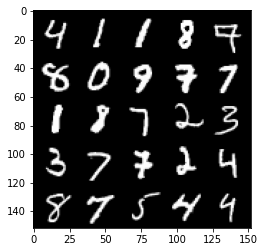

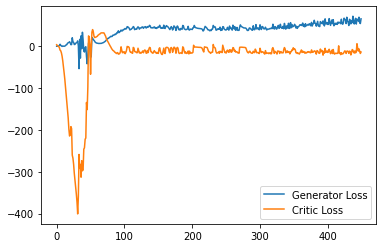

Step 9050: Generator loss: 60.27671401977539, critic loss: -14.886436553478243


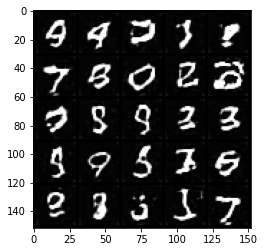

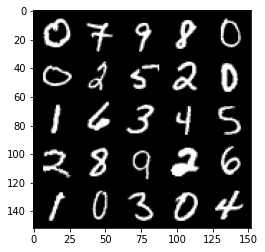

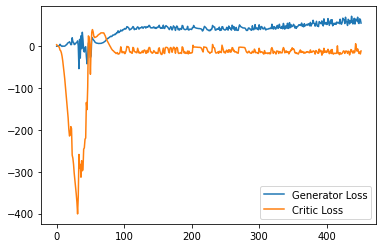

Step 9100: Generator loss: 60.74930641174316, critic loss: -15.143555923461923


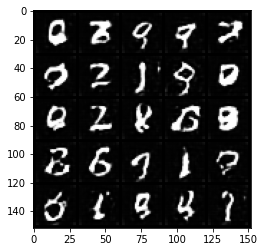

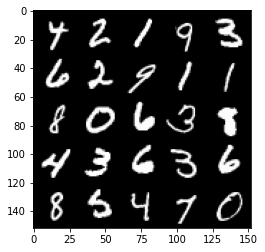

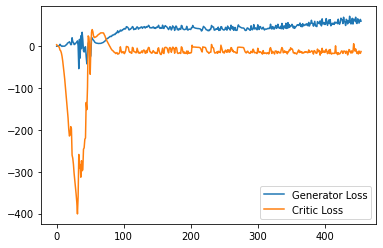

Step 9150: Generator loss: 65.17632400512696, critic loss: -14.04409712076187


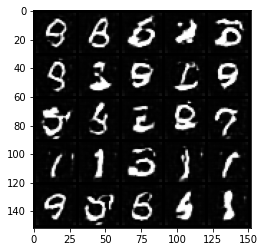

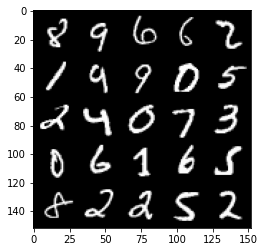

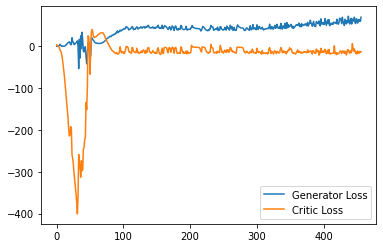

Step 9200: Generator loss: 57.07298629760742, critic loss: -12.926128409862516


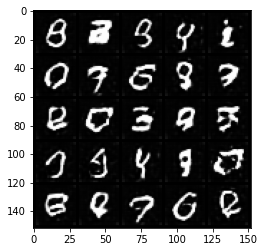

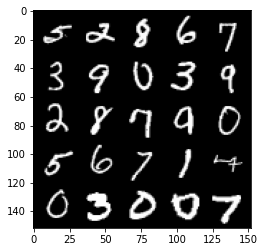

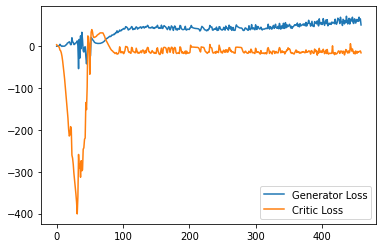

Step 9250: Generator loss: 59.12822906494141, critic loss: -15.682454380512235


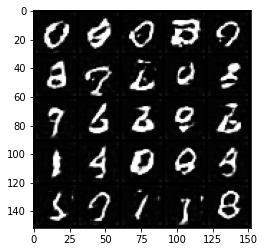

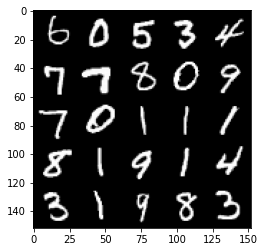

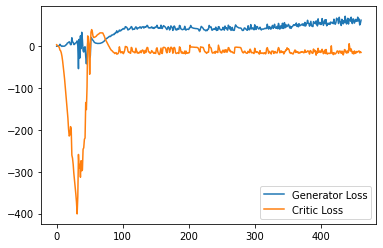

Step 9300: Generator loss: 60.34736846923828, critic loss: -13.295625745773318


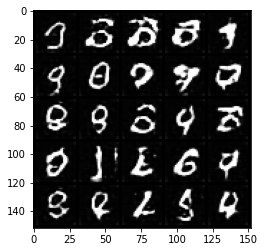

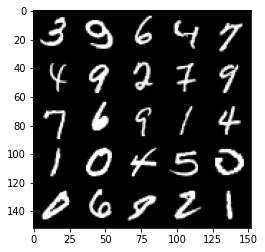

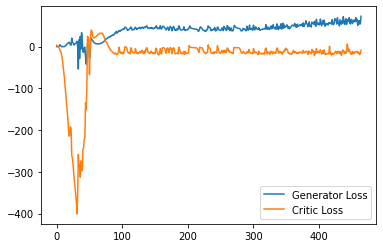

Step 9350: Generator loss: 62.02676528930664, critic loss: -6.27722254669666


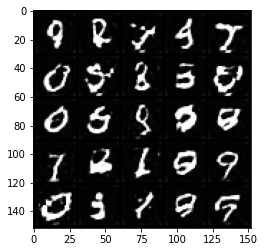

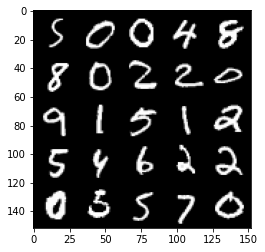

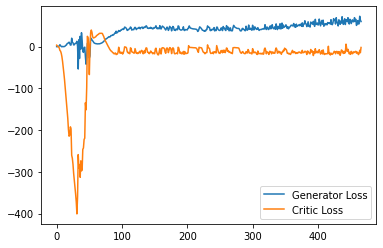

Step 9400: Generator loss: 65.59052268981934, critic loss: -3.2624784533977502


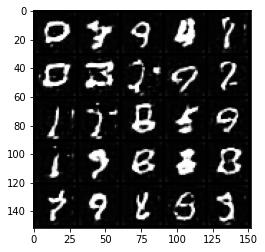

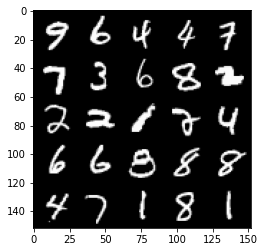

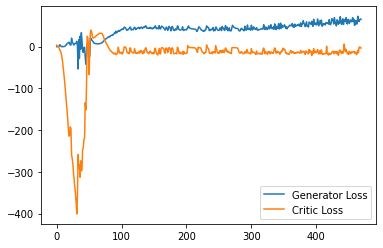

Step 9450: Generator loss: 58.84849182128906, critic loss: -7.033991815805437


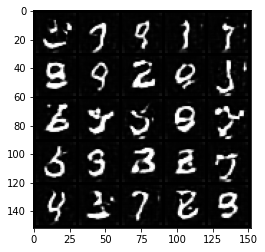

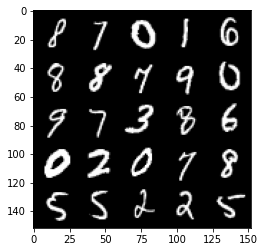

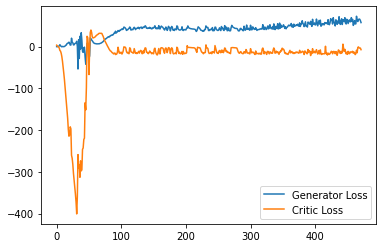

Step 9500: Generator loss: 66.03486640930176, critic loss: -12.974760390281677


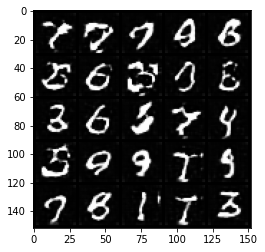

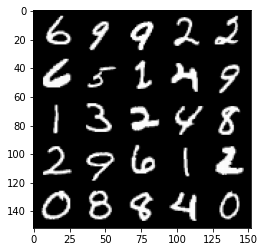

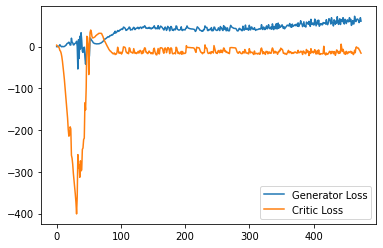

Step 9550: Generator loss: 55.870813522338864, critic loss: -13.59382893013954


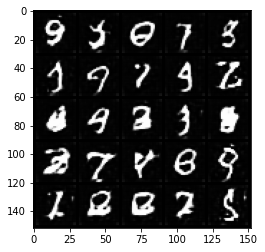

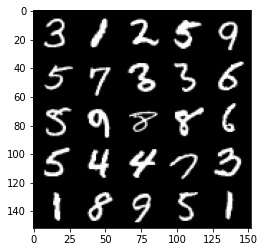

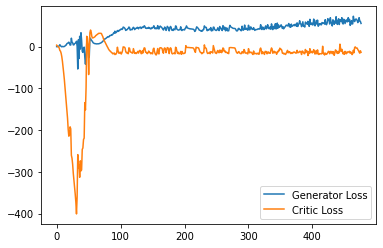

Step 9600: Generator loss: 64.9260474395752, critic loss: -13.725431628465646


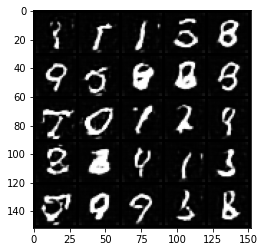

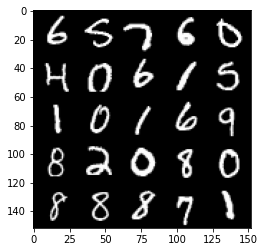

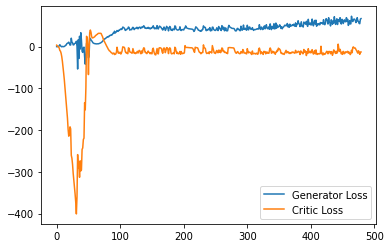

Step 9650: Generator loss: 57.725176315307614, critic loss: -18.02814939332008


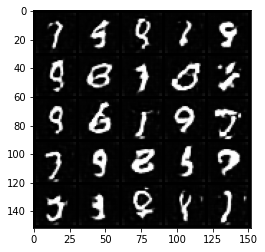

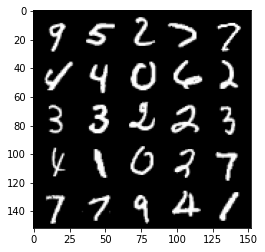

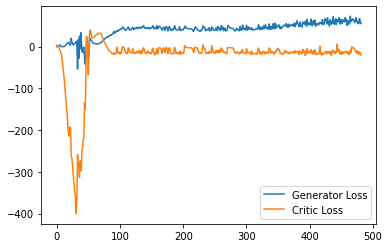

Step 9700: Generator loss: 62.325743179321286, critic loss: -16.03871819210052


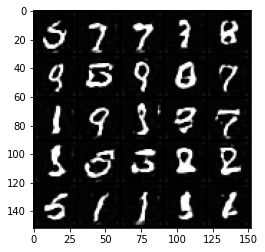

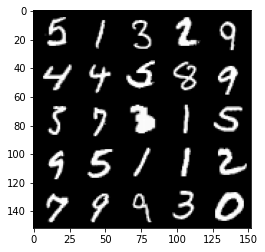

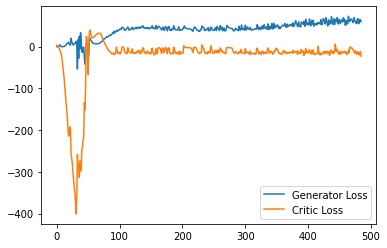

Step 9750: Generator loss: 60.80459823608398, critic loss: -14.940024480342865


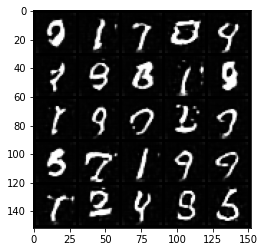

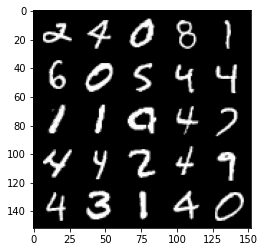

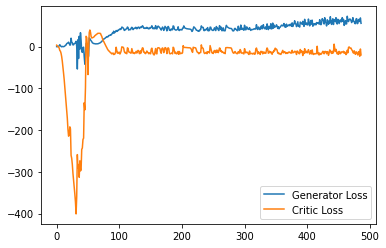

Step 9800: Generator loss: 63.68711235046387, critic loss: -15.580334065914151


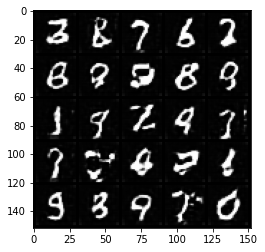

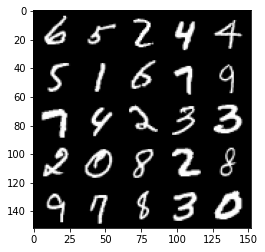

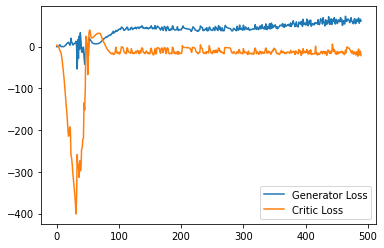

Step 9850: Generator loss: 60.87460891723633, critic loss: -14.505212960720069


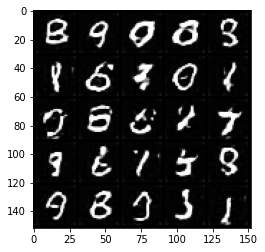

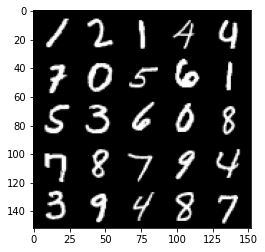

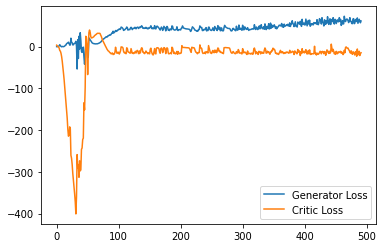

Step 14700: Generator loss: 67.04968894958496, critic loss: -12.302299043655395


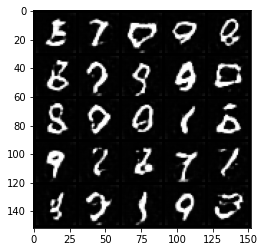

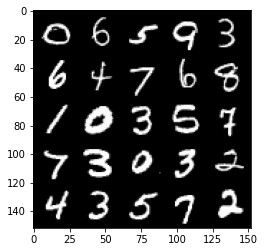

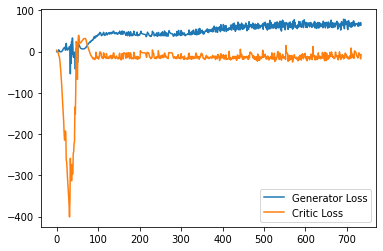

Step 14750: Generator loss: 68.95286506652832, critic loss: -11.137700582504273


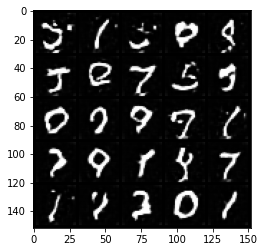

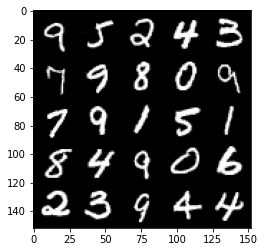

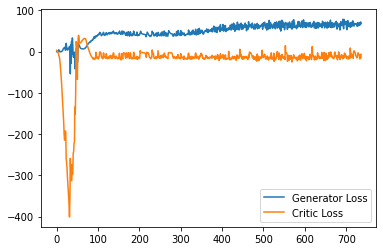

Step 14800: Generator loss: 69.47954483032227, critic loss: -14.556595592975617


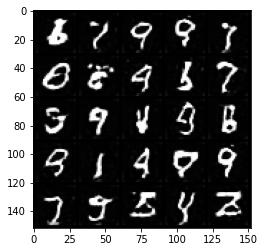

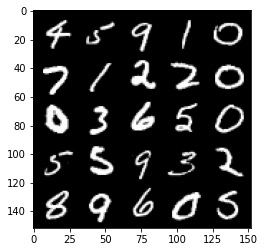

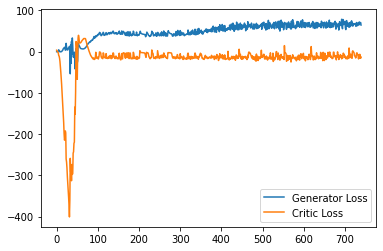

Step 14850: Generator loss: 69.47982116699218, critic loss: -11.659323132157324


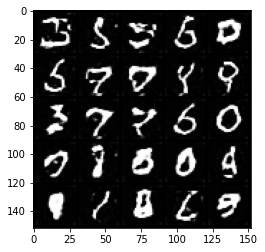

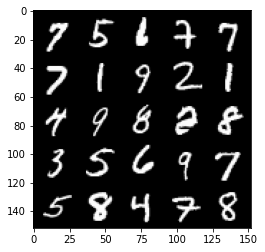

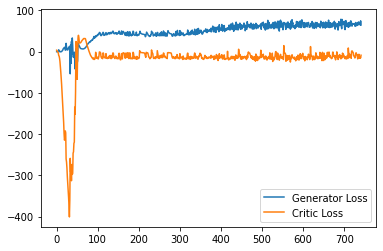

Step 14900: Generator loss: 67.04834465026856, critic loss: -12.584973949670793


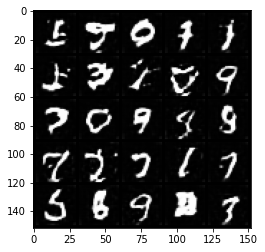

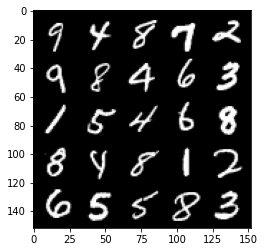

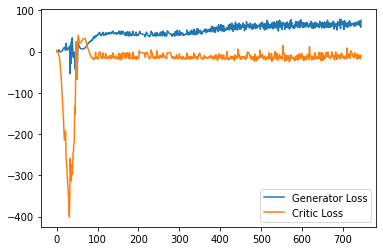

Step 14950: Generator loss: 65.031849899292, critic loss: -6.840138799190526


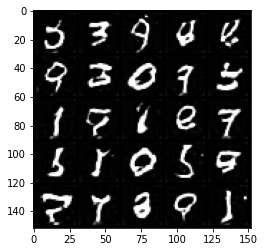

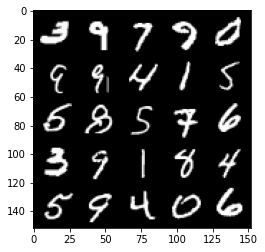

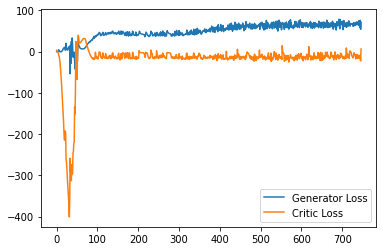

Step 15000: Generator loss: 72.49929306030273, critic loss: -4.251241227149963


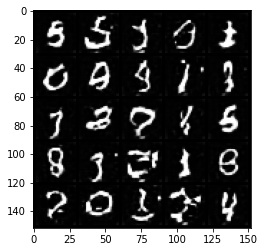

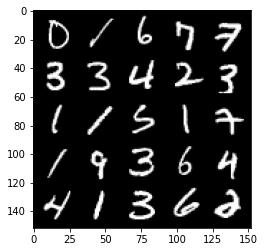

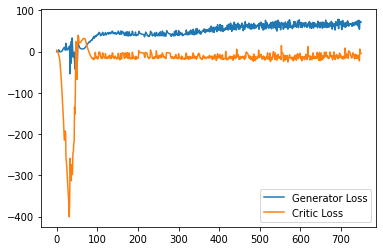

Step 15050: Generator loss: 58.83616493225097, critic loss: -17.169119714021683


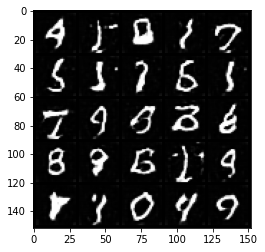

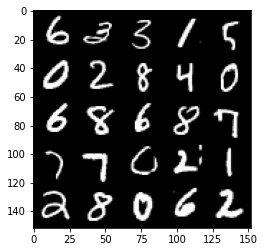

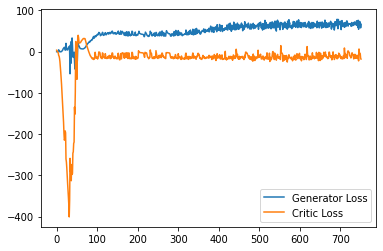

Step 15100: Generator loss: 68.92024147033692, critic loss: -11.89407932782173


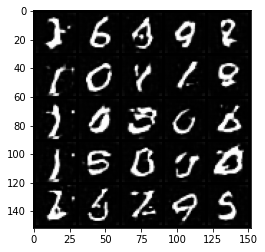

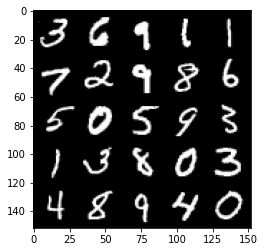

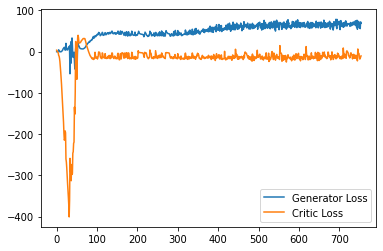

Step 15150: Generator loss: 72.66134956359863, critic loss: -14.763310955524451


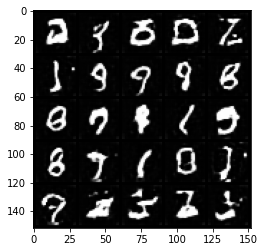

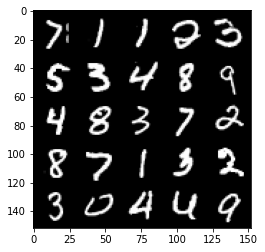

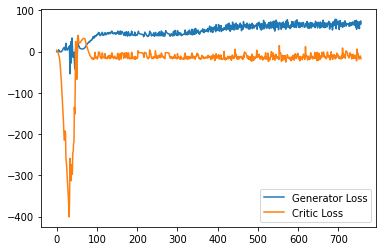

Step 15200: Generator loss: 68.49163398742675, critic loss: -12.67357169246673


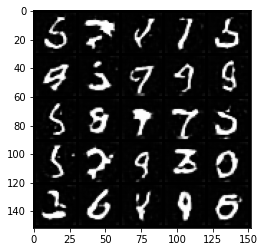

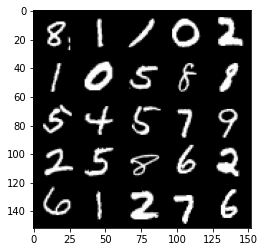

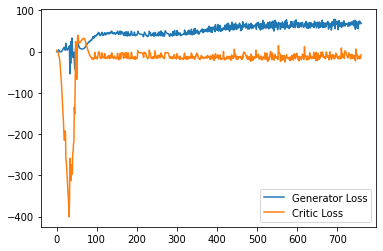

Step 15250: Generator loss: 70.93903358459472, critic loss: -13.610186433792121


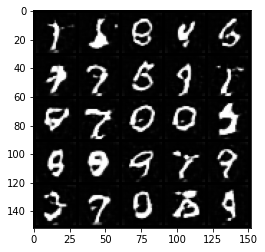

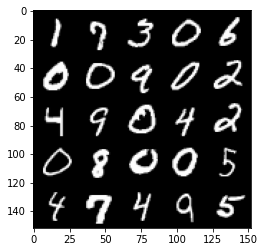

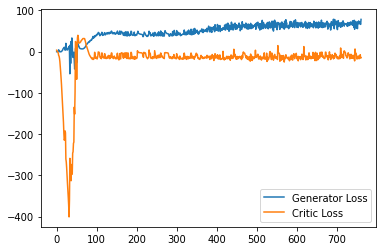

Step 15300: Generator loss: 65.18050987243652, critic loss: -15.63510553002358


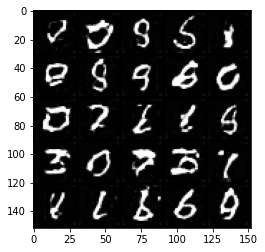

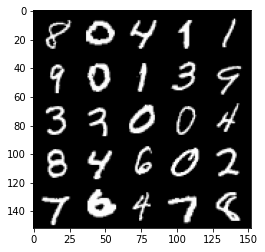

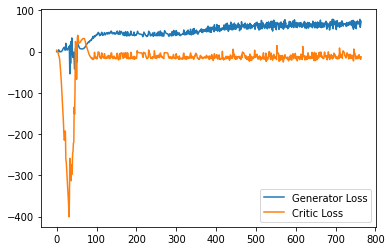

Step 15350: Generator loss: 69.60299827575683, critic loss: -14.499944635152813


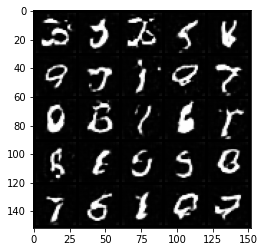

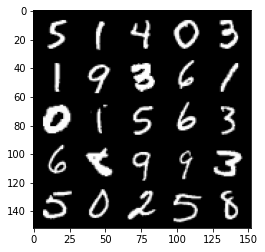

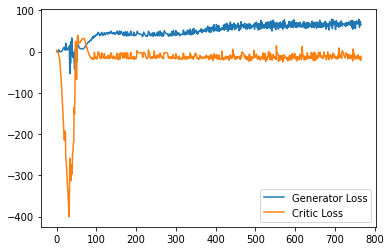

Step 15400: Generator loss: 72.65564918518066, critic loss: -10.881388749122621


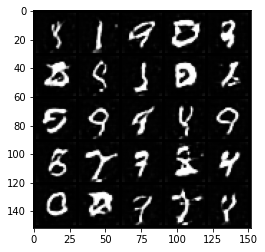

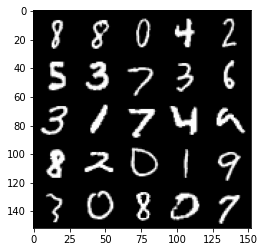

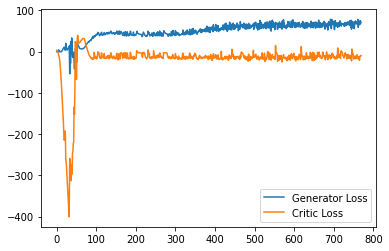

Step 15450: Generator loss: 61.903067398071286, critic loss: -18.456698799133292


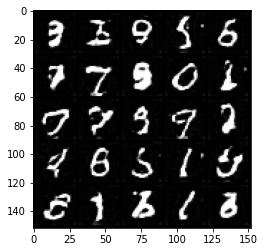

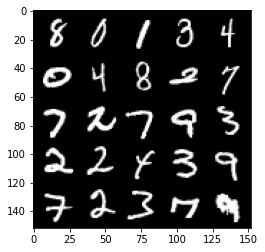

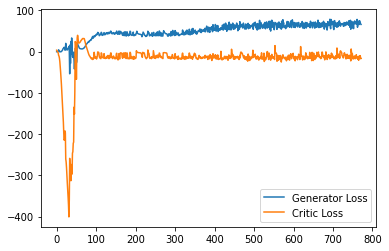

Step 15500: Generator loss: 63.23237952232361, critic loss: -13.200552850008007


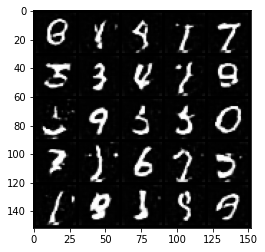

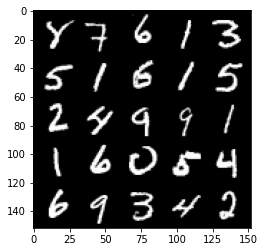

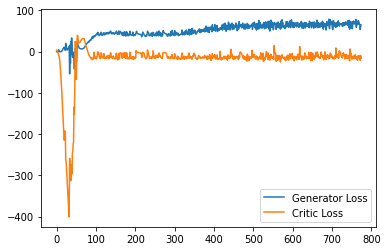

Step 15550: Generator loss: 62.384740295410154, critic loss: -20.05335142421723


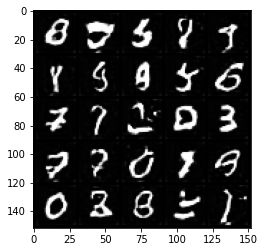

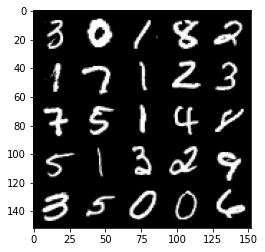

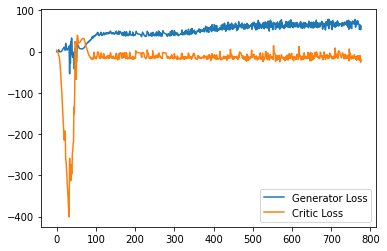

Step 15600: Generator loss: 64.24993957519531, critic loss: -14.433001611232761


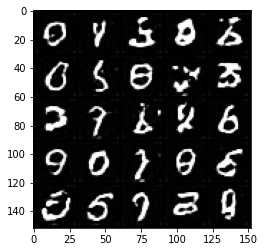

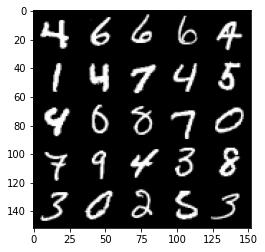

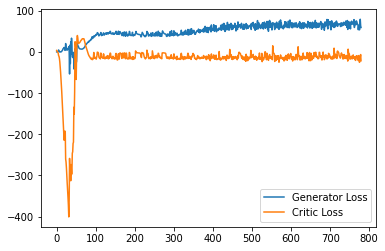

Step 15650: Generator loss: 72.98405685424805, critic loss: -7.929887189388275


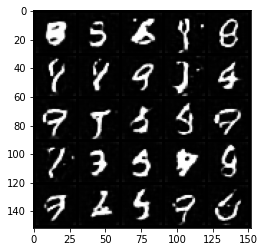

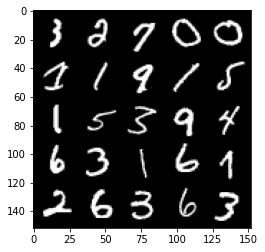

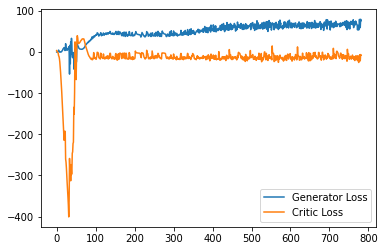

Step 15700: Generator loss: 61.294978332519534, critic loss: -16.561177901268014


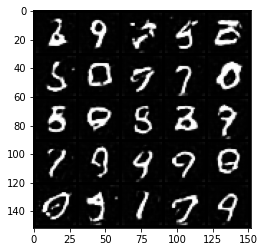

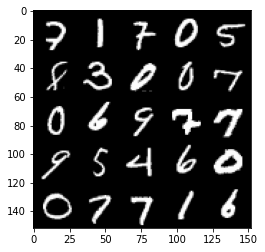

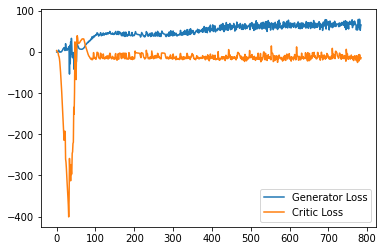

Step 15750: Generator loss: 64.18498485565186, critic loss: -16.441302836418153


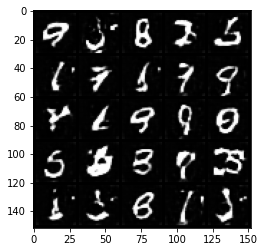

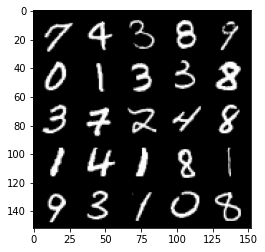

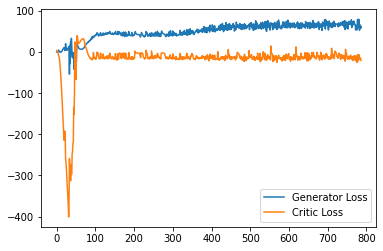

Step 15800: Generator loss: 68.15889297485352, critic loss: -16.379660738945002


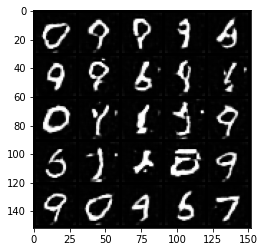

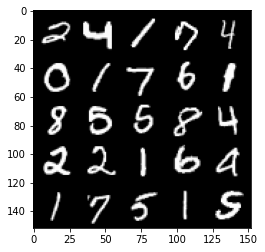

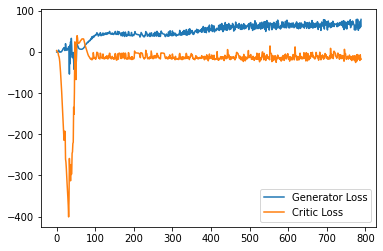

Step 15850: Generator loss: 65.39056594848633, critic loss: -15.605077606678005


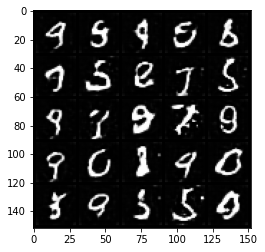

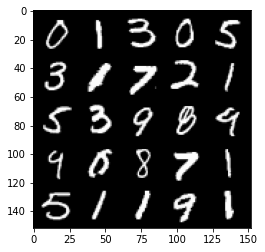

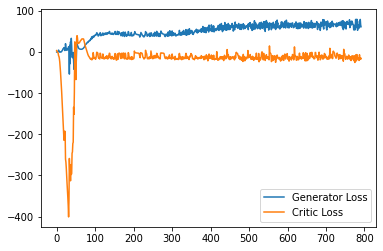

Step 15900: Generator loss: 66.34660675048828, critic loss: -16.0566292526722


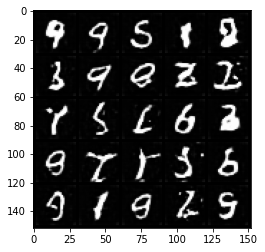

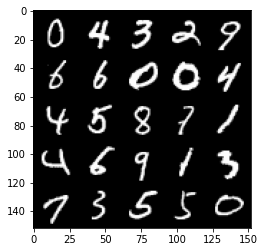

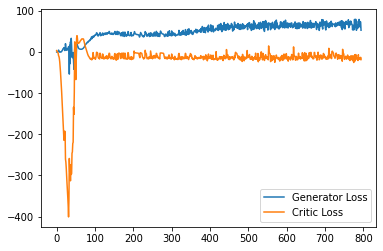

Step 15950: Generator loss: 73.59602249145507, critic loss: -12.391841783285145


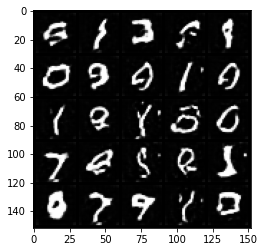

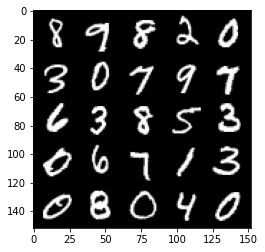

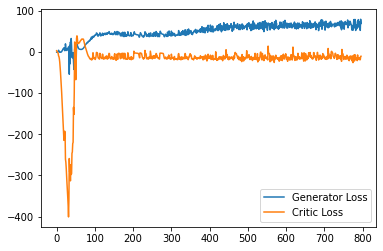

Step 16000: Generator loss: 69.15385520935058, critic loss: -7.587850303649902


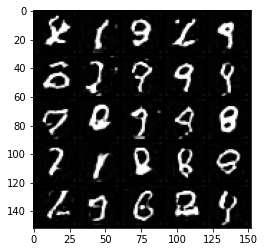

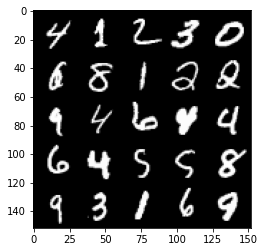

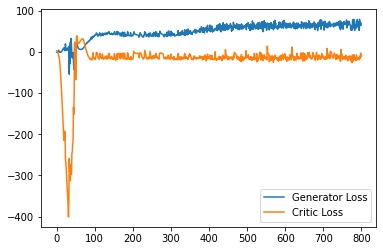

Step 16050: Generator loss: 68.44781753540039, critic loss: -14.964195998072624


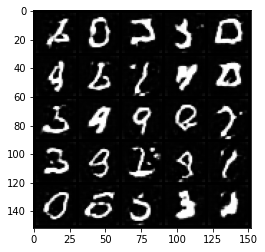

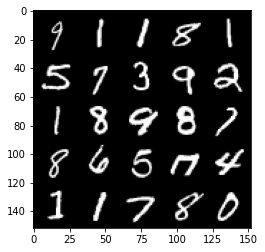

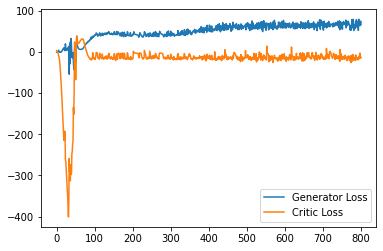

Step 16100: Generator loss: 68.089995803833, critic loss: -15.209990693569182


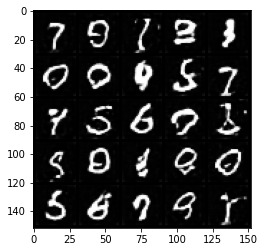

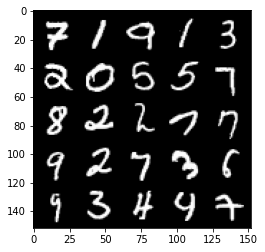

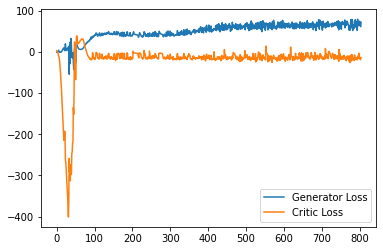

Step 16150: Generator loss: 66.57999431610108, critic loss: -16.37345438718796


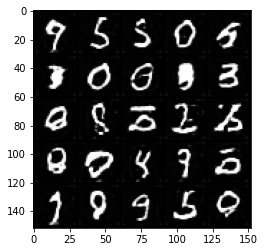

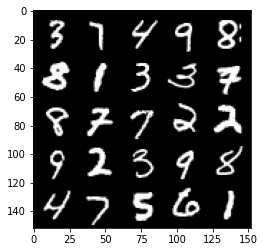

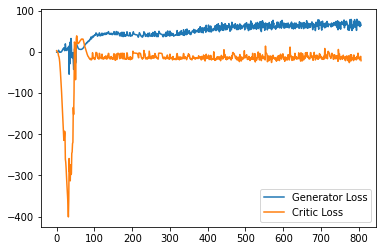

Step 16200: Generator loss: 62.877801475524905, critic loss: -16.15006629991531


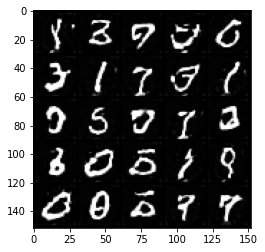

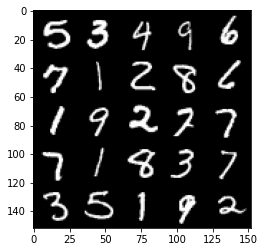

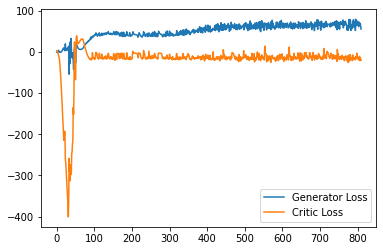

Step 16250: Generator loss: 64.24336421966552, critic loss: -16.84062676429749


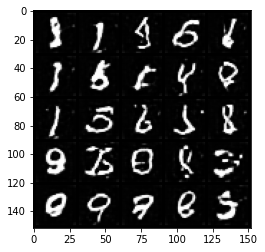

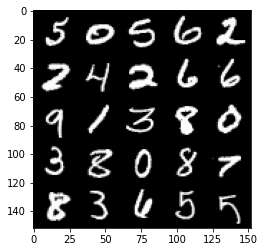

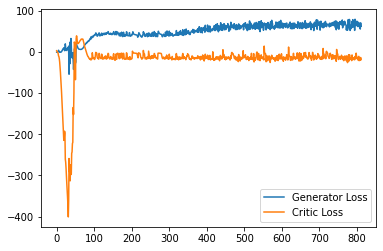

Step 16300: Generator loss: 72.13470169067382, critic loss: -9.915838250160217


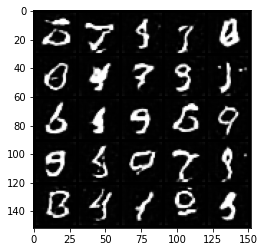

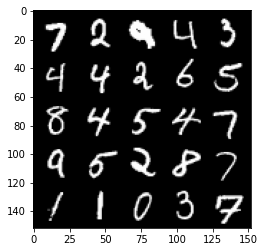

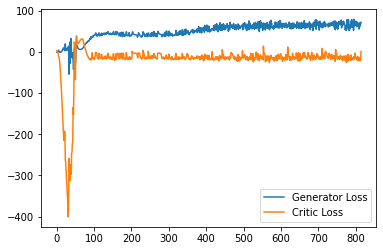

Step 16350: Generator loss: 67.20232002258301, critic loss: -13.8619855132103


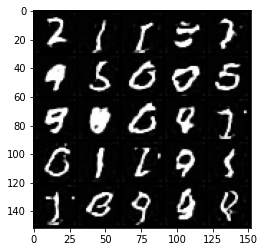

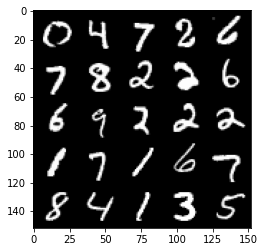

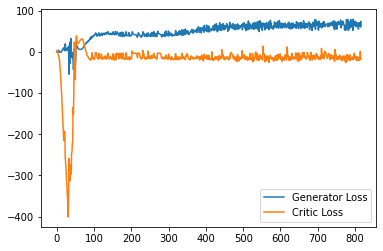

Step 16400: Generator loss: 66.19085571289062, critic loss: -15.536910136222836


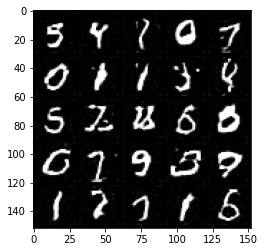

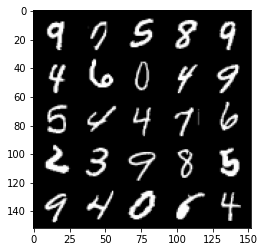

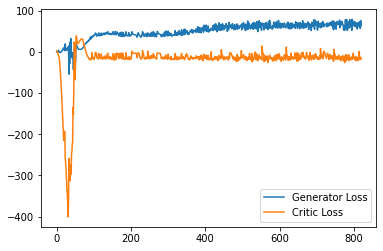

Step 16450: Generator loss: 68.4623159790039, critic loss: -14.631457750082017


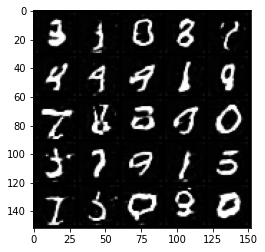

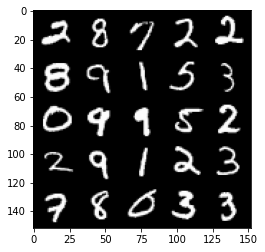

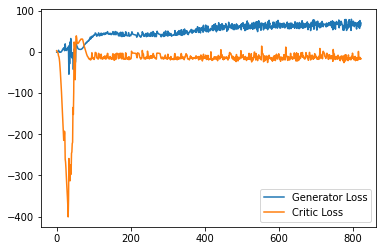

Step 16500: Generator loss: 69.1179077911377, critic loss: -13.435941434860233


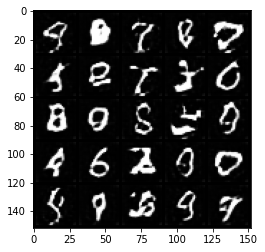

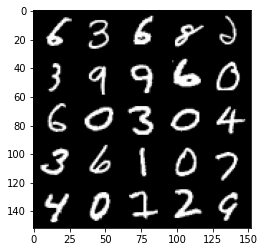

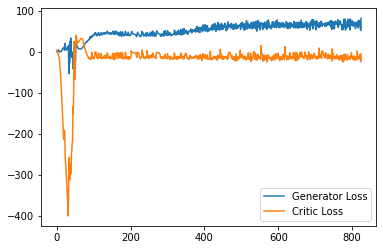

Step 16550: Generator loss: 66.48326801300048, critic loss: -13.797605703830719


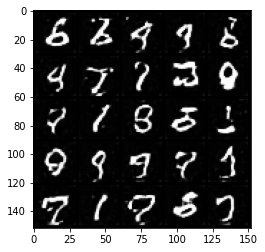

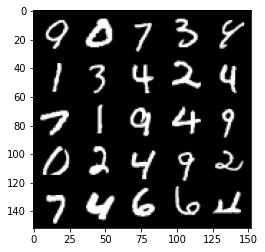

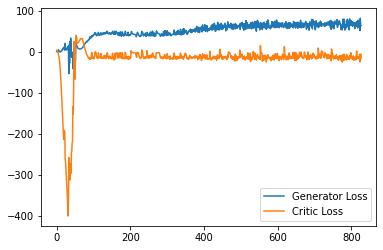

Step 16600: Generator loss: 62.839812698364256, critic loss: -15.88962007141113


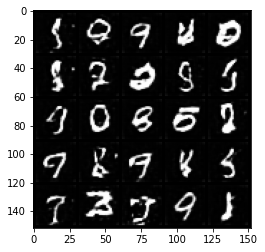

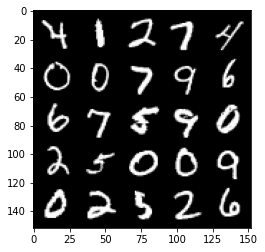

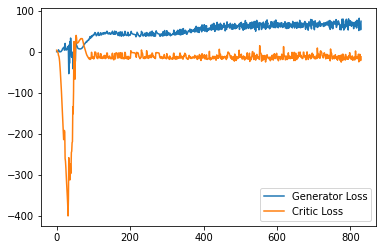

Step 16650: Generator loss: 67.1458309173584, critic loss: -12.469820074796678


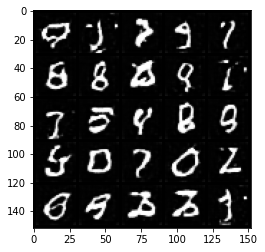

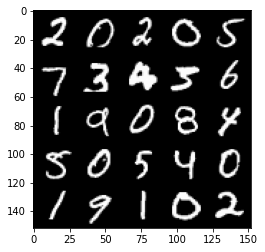

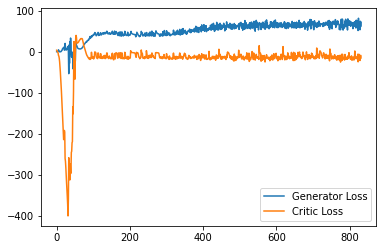

Step 16700: Generator loss: 65.89876663208008, critic loss: -16.271648398399357


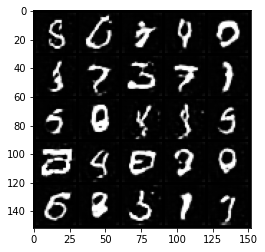

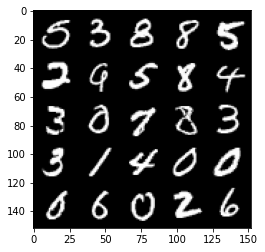

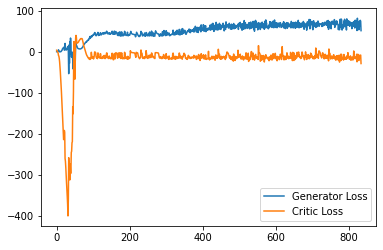

Step 16750: Generator loss: 72.67924156188965, critic loss: -8.920298379659654


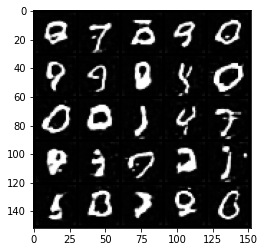

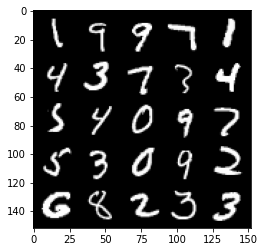

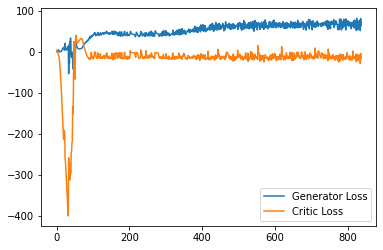

Step 16800: Generator loss: 72.88235336303711, critic loss: -13.96730606651306


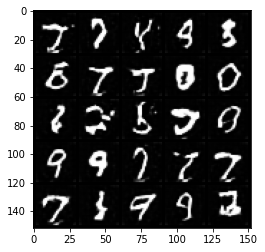

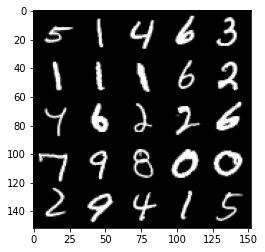

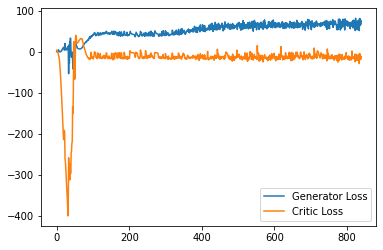

Step 16850: Generator loss: 69.9975475692749, critic loss: -14.634507249355316


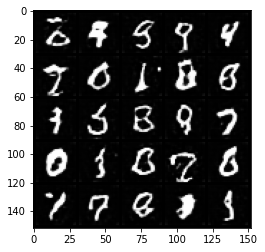

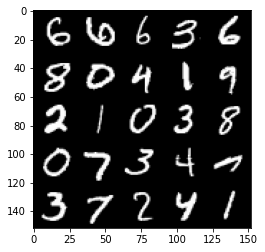

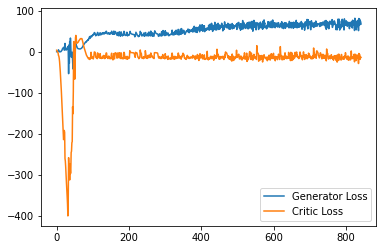

Step 16900: Generator loss: 70.3775777053833, critic loss: -4.995232422053815


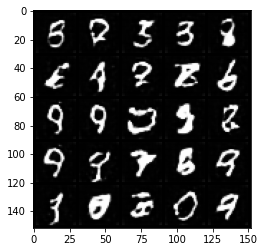

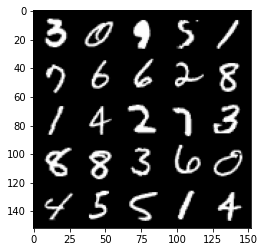

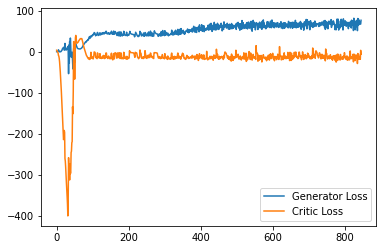

Step 16950: Generator loss: 66.83299823760986, critic loss: -15.344828522443771


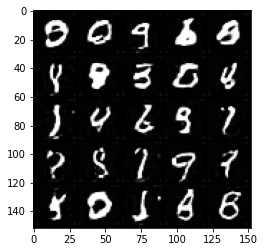

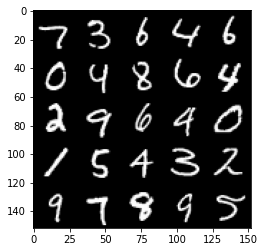

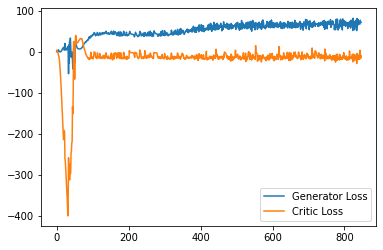

Step 17000: Generator loss: 68.26020851135254, critic loss: -9.90596474599838


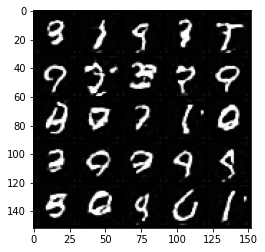

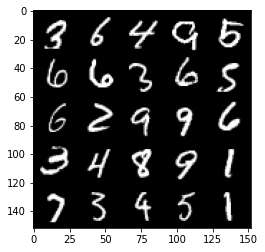

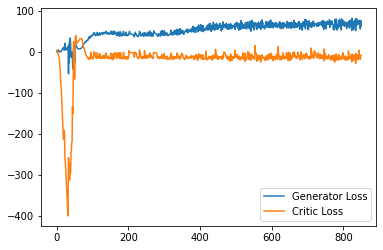

Step 17050: Generator loss: 69.76600830078125, critic loss: -18.156106245994568


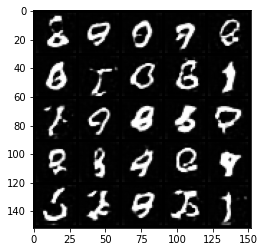

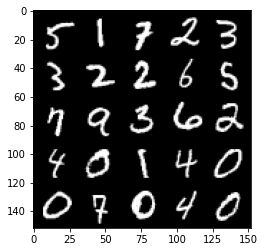

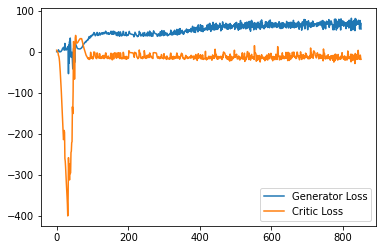

Step 17100: Generator loss: 70.23073249816895, critic loss: -11.55943068432808


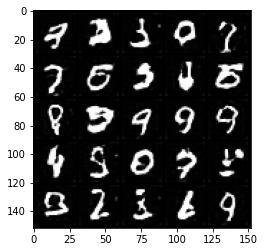

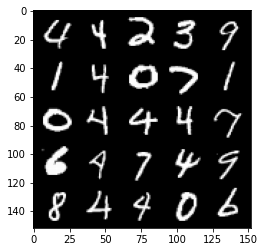

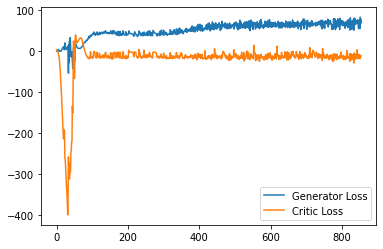

Step 17150: Generator loss: 67.57763328552247, critic loss: -11.844819445610044


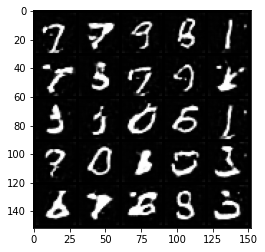

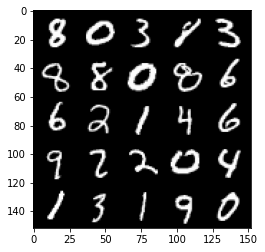

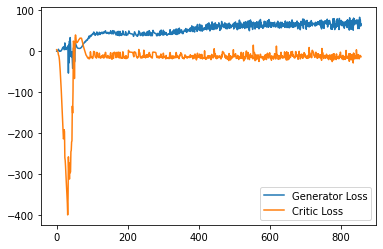

Step 17200: Generator loss: 72.86320793151856, critic loss: -7.899996746063234


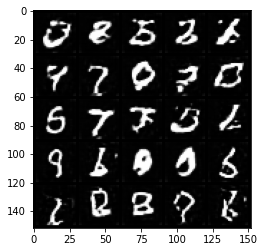

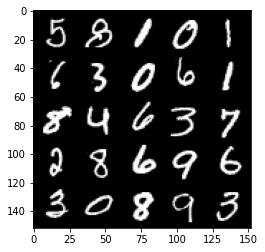

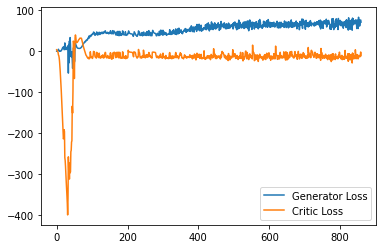

Step 17250: Generator loss: 59.56508365631103, critic loss: -14.830127334117895


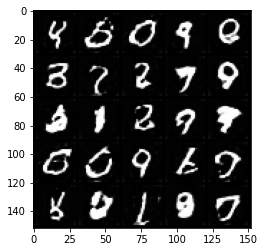

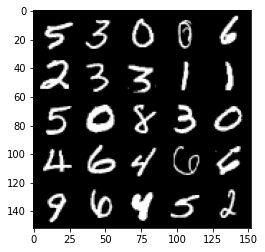

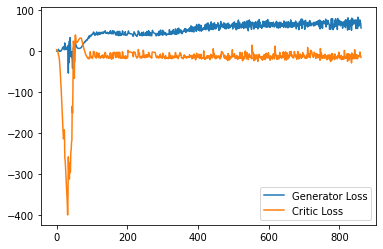

Step 17300: Generator loss: 71.5584984588623, critic loss: -6.082782091498376


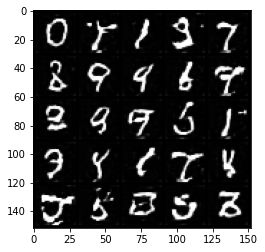

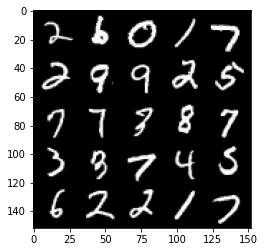

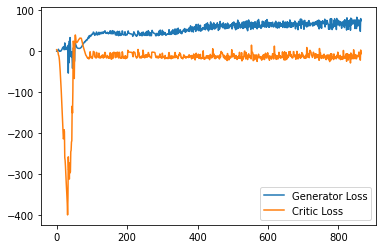

Step 17350: Generator loss: 64.78364433288574, critic loss: -12.383102606534955


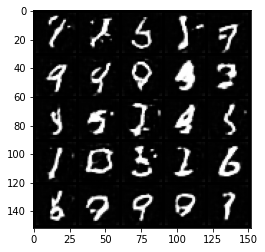

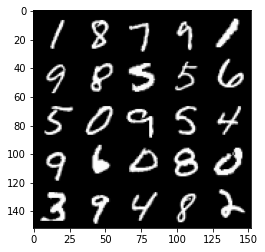

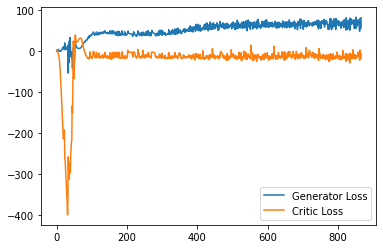

Step 17400: Generator loss: 72.28846954345703, critic loss: -12.397947510719293


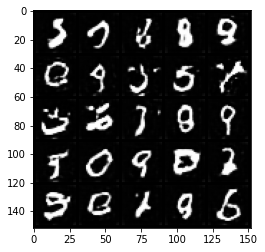

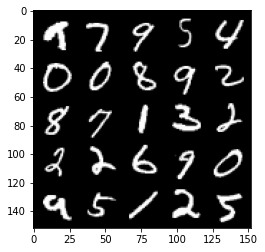

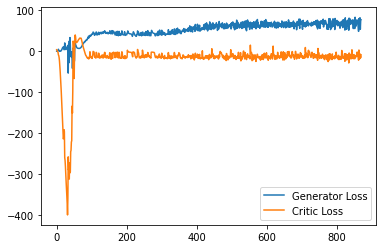

Step 17450: Generator loss: 65.0832462310791, critic loss: -17.419903202056886


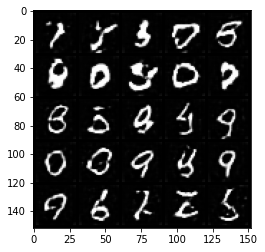

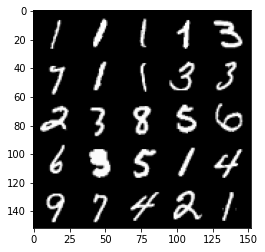

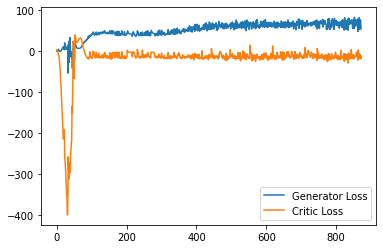

Step 17500: Generator loss: 73.41506561279297, critic loss: -14.232931286334992


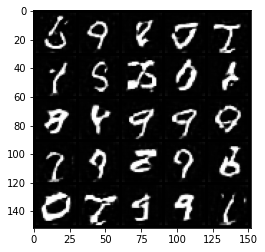

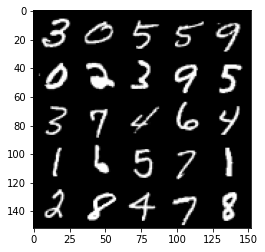

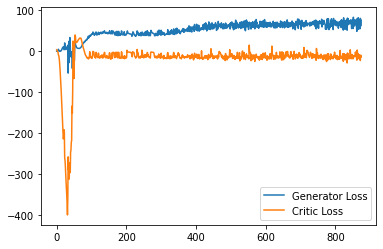

Step 17550: Generator loss: 62.47295204162597, critic loss: -14.323703673005106


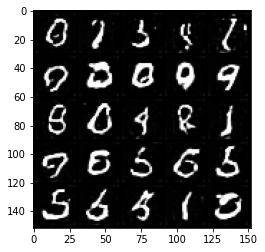

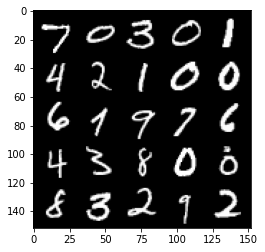

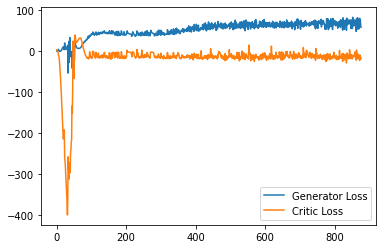

Step 30350: Generator loss: 62.39837272644043, critic loss: -3.2214228024482723


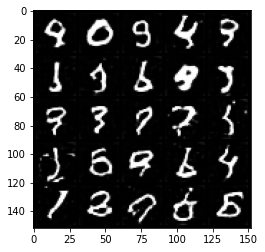

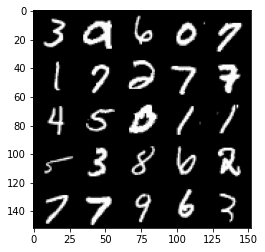

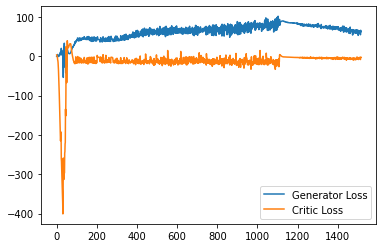

Step 30400: Generator loss: 62.54231079101562, critic loss: -4.680343307375906


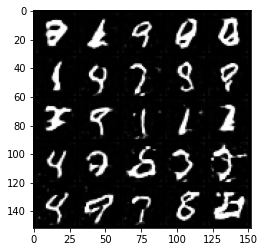

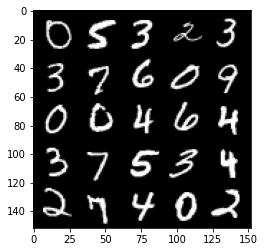

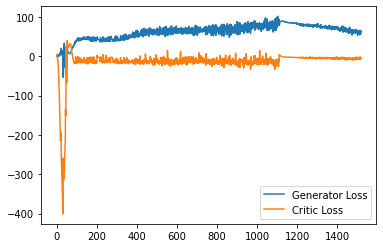

Step 30450: Generator loss: 61.269826889038086, critic loss: -4.254621759891509


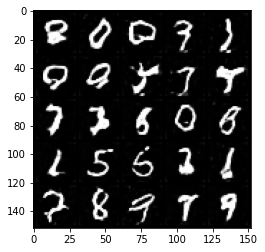

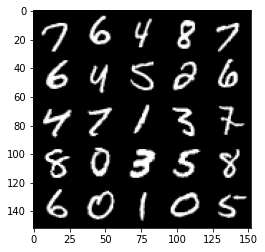

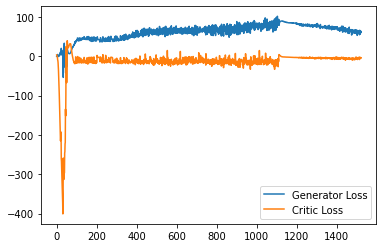

Step 30500: Generator loss: 59.46690536499023, critic loss: -6.069501397848131


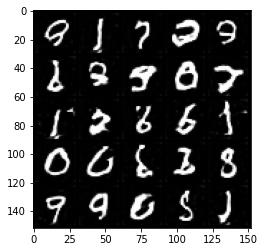

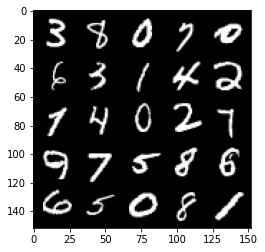

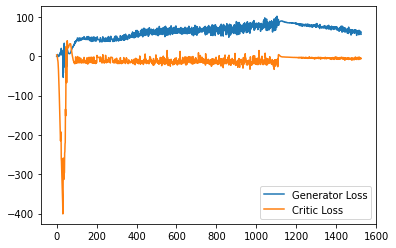

Step 30550: Generator loss: 63.67557609558106, critic loss: -5.431670419096947


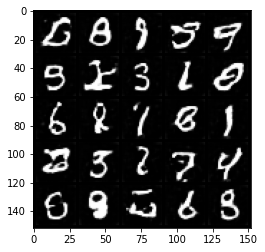

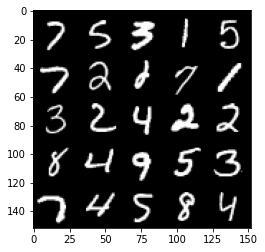

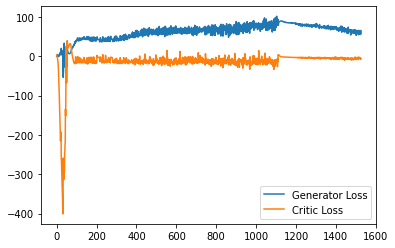

Step 30600: Generator loss: 57.06908317565918, critic loss: -4.926807758331297


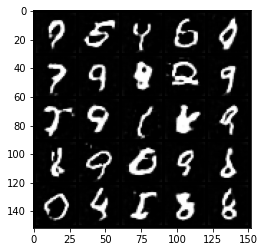

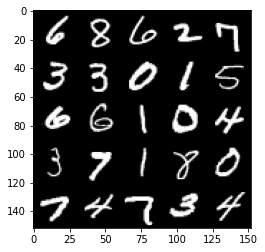

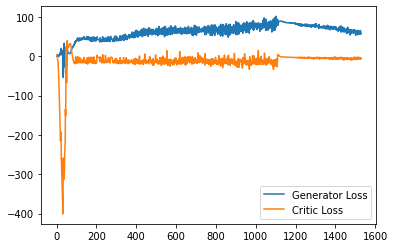

Step 30650: Generator loss: 56.14250923156738, critic loss: -5.245573804616927


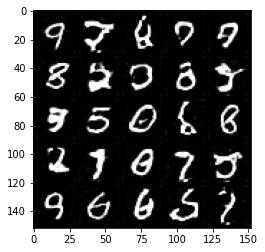

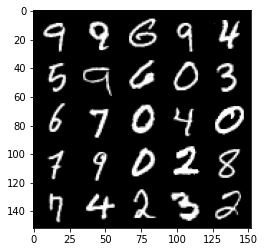

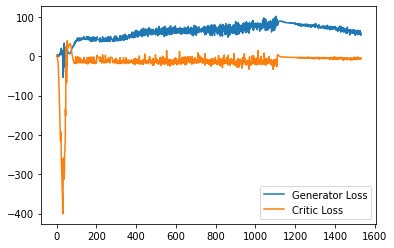

Step 30700: Generator loss: 57.108678665161136, critic loss: -6.622754557132722


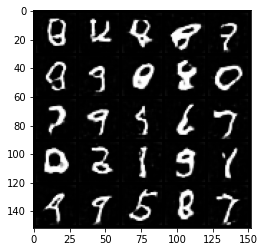

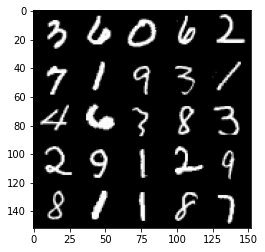

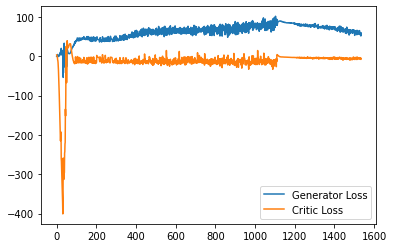

Step 30750: Generator loss: 57.520104293823245, critic loss: -4.8656972899436965


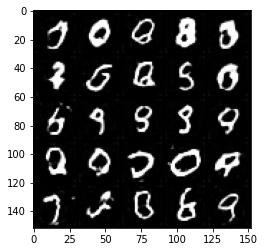

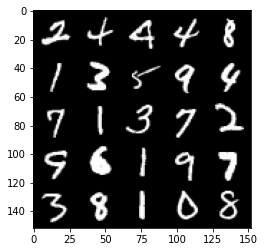

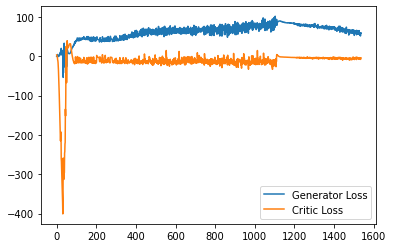

Step 30800: Generator loss: 55.4087744140625, critic loss: -5.003668223142621


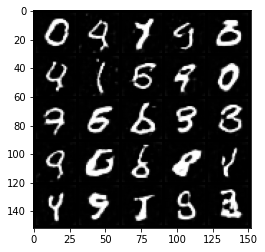

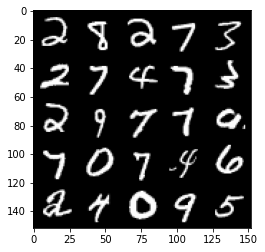

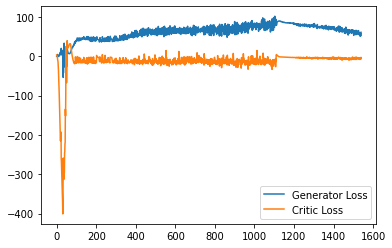

Step 30850: Generator loss: 53.703991470336916, critic loss: -5.5213209260702145


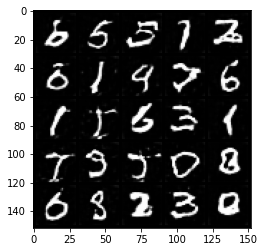

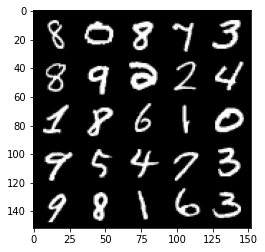

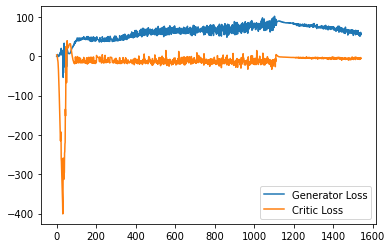

Step 30900: Generator loss: 55.28241744995117, critic loss: -5.49783000075817


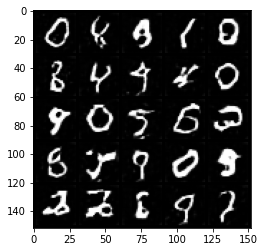

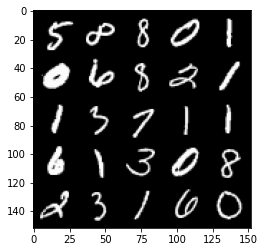

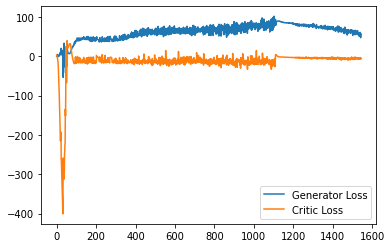

Step 30950: Generator loss: 58.40046310424805, critic loss: -4.0072453877925875


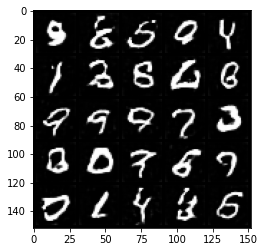

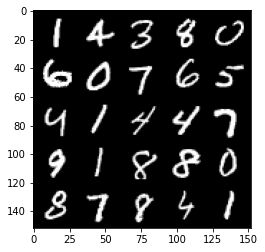

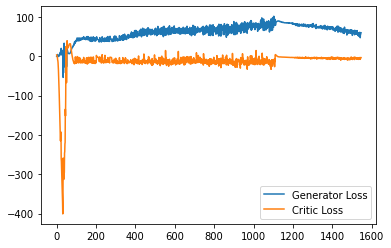

Step 31000: Generator loss: 53.77299415588379, critic loss: -5.889288433909417


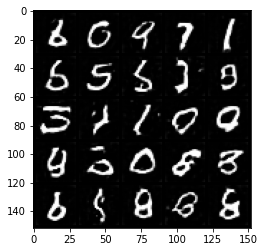

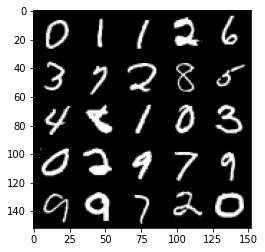

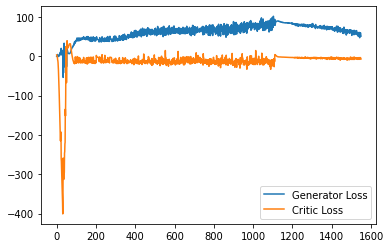

Step 31050: Generator loss: 56.37723960876465, critic loss: -5.724788947343828


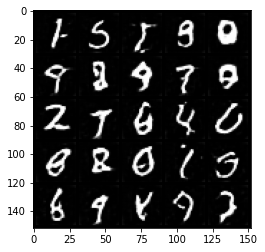

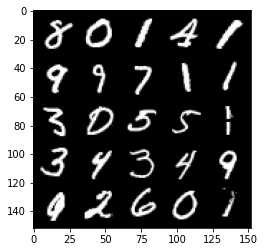

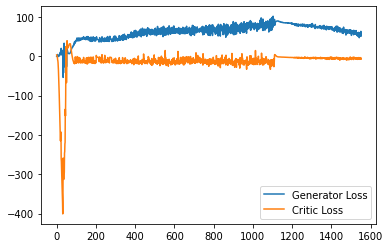

Step 31100: Generator loss: 54.31380828857422, critic loss: -5.966488448321821


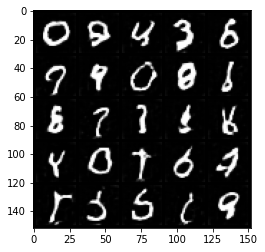

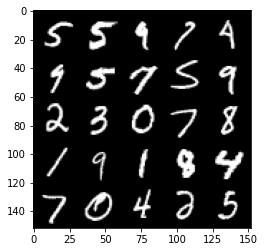

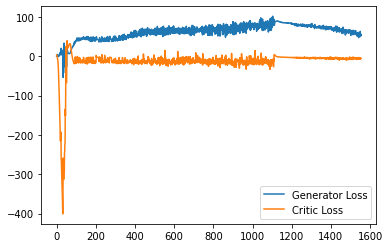

Step 31150: Generator loss: 56.797785720825196, critic loss: -4.189805866241455


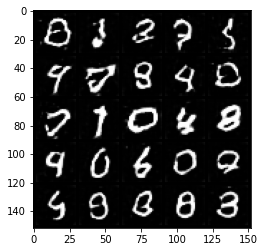

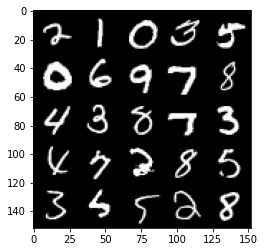

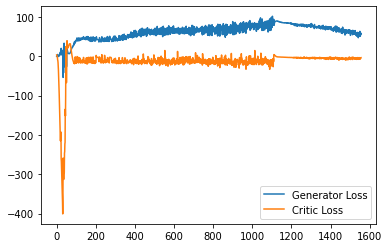

Step 31200: Generator loss: 58.570102005004884, critic loss: -5.828260889708995


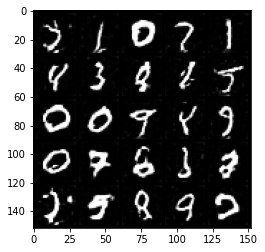

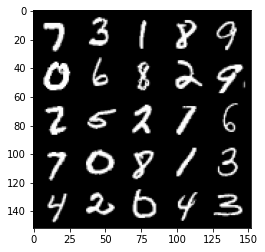

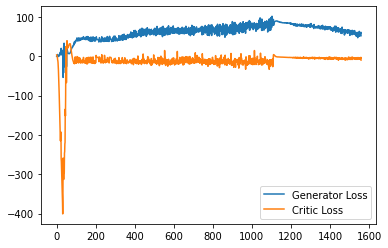

Step 31250: Generator loss: 55.71142463684082, critic loss: -6.05917598092556


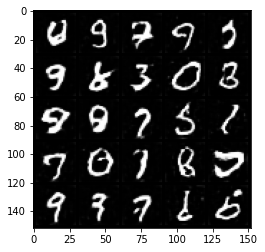

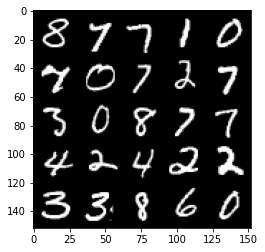

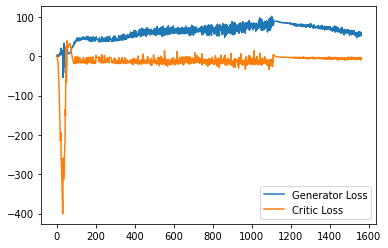

Step 31300: Generator loss: 53.61979621887207, critic loss: -6.349619654893876


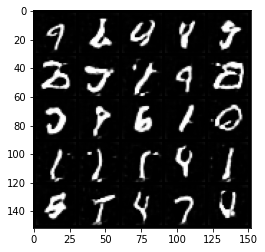

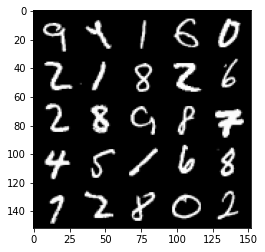

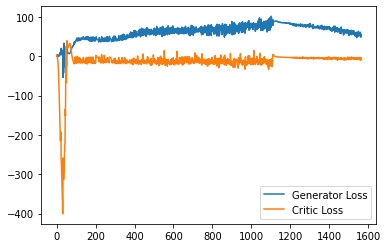

Step 31350: Generator loss: 53.91495006561279, critic loss: -6.945715433120728


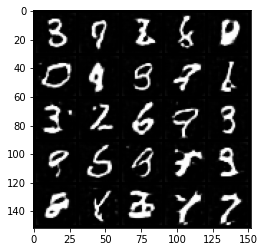

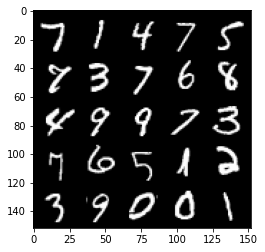

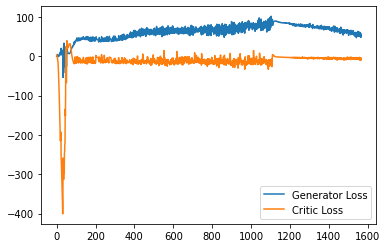

Step 31400: Generator loss: 53.954697647094726, critic loss: -6.1184022547006585


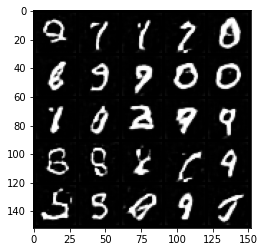

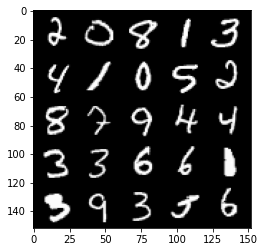

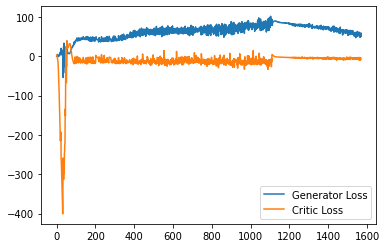

Step 31450: Generator loss: 54.745242233276365, critic loss: -6.09123270535469


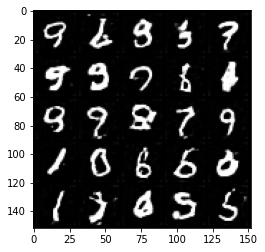

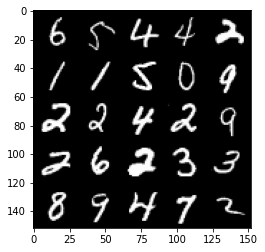

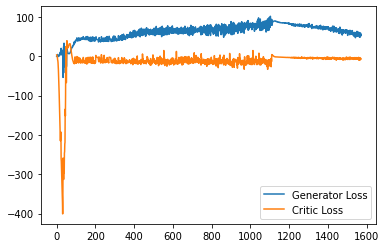

Step 31500: Generator loss: 55.57011077880859, critic loss: -5.658239973902702


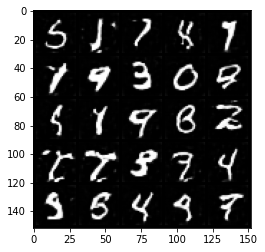

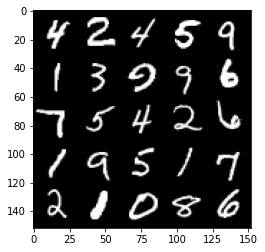

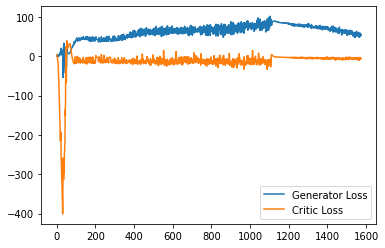

Step 31550: Generator loss: 53.520972366333005, critic loss: -5.428160580277442


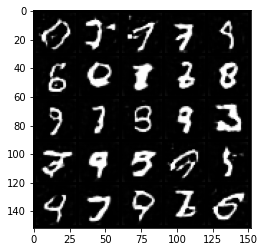

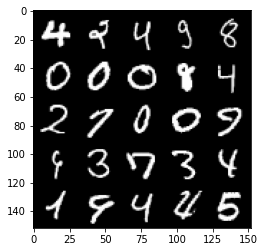

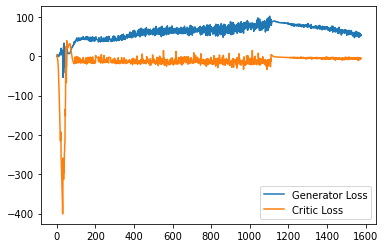

Step 31600: Generator loss: 51.79801887512207, critic loss: -4.927949495553969


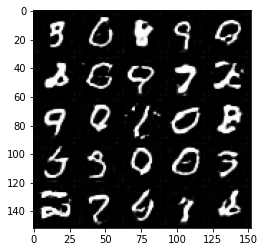

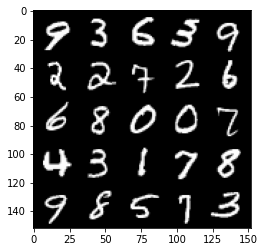

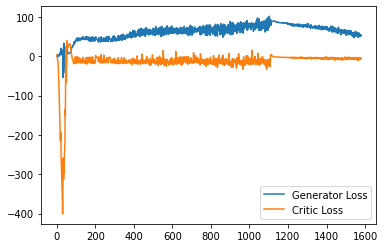

Step 31650: Generator loss: 48.30467613220215, critic loss: -7.615555998563767


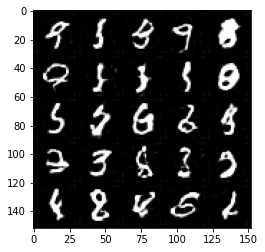

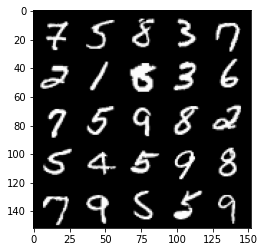

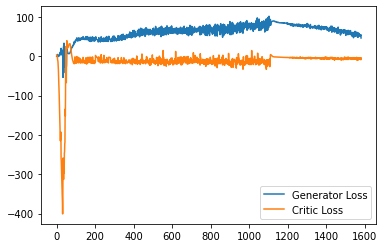

Step 31700: Generator loss: 50.0152405166626, critic loss: -6.262919371128082


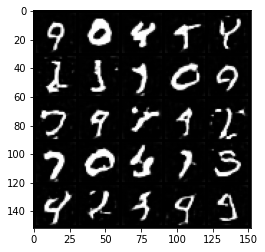

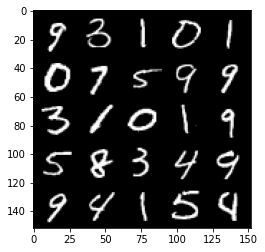

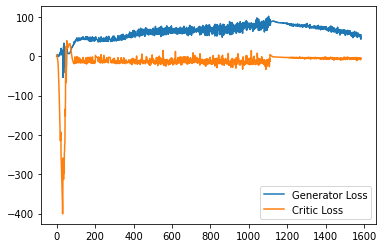

Step 31750: Generator loss: 50.21798107147217, critic loss: -4.94714991593361


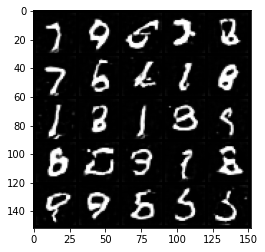

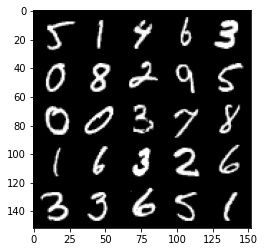

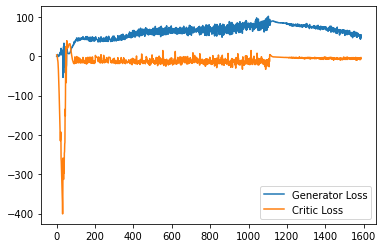

Step 31800: Generator loss: 50.370506286621094, critic loss: -6.383297701358792


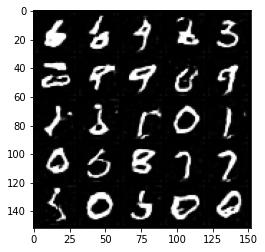

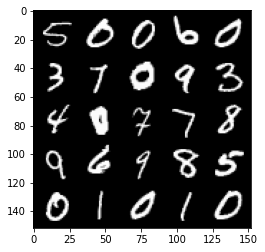

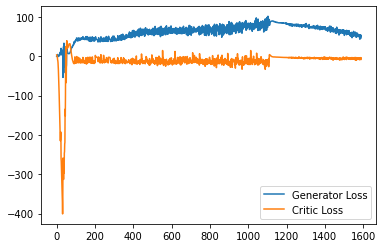

Step 31850: Generator loss: 49.446895065307615, critic loss: -5.8945662509202945


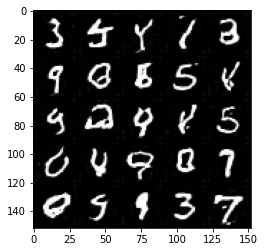

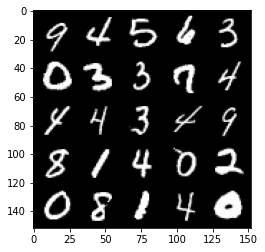

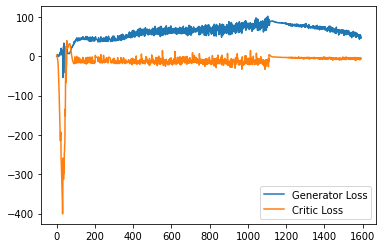

Step 31900: Generator loss: 50.762225036621096, critic loss: -7.265253270030022


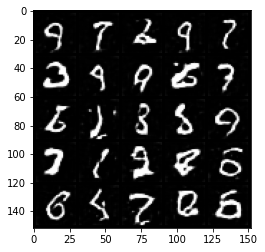

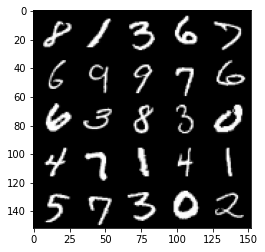

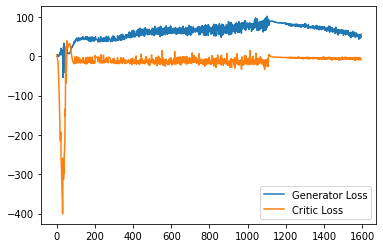

Step 31950: Generator loss: 49.452711486816405, critic loss: -6.004560870409012


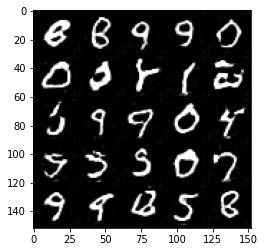

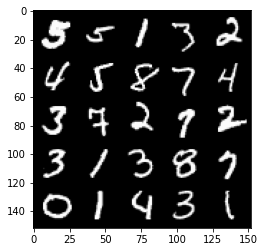

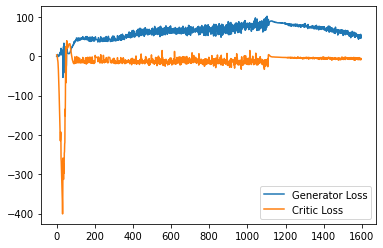

Step 32000: Generator loss: 50.750330429077145, critic loss: -5.261843173980712


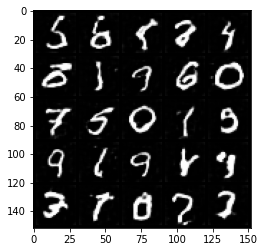

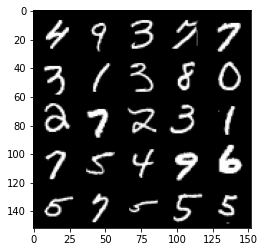

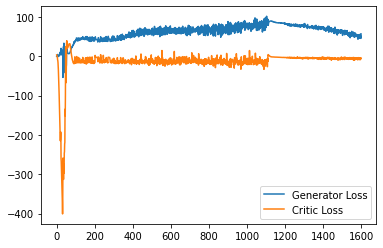

Step 32050: Generator loss: 46.72943450927735, critic loss: -8.717767750024795


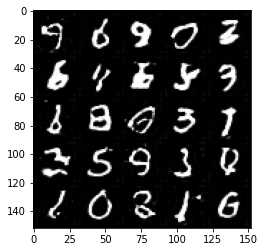

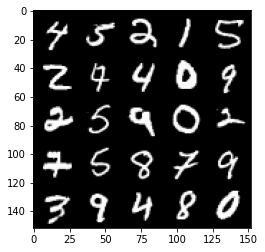

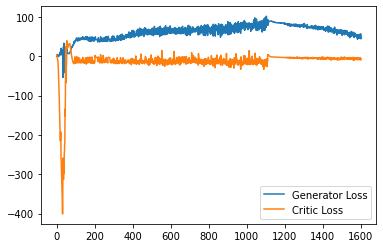

Step 32100: Generator loss: 52.3609285736084, critic loss: -6.479411646842957


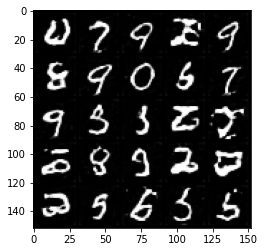

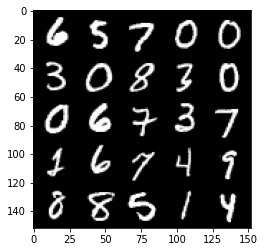

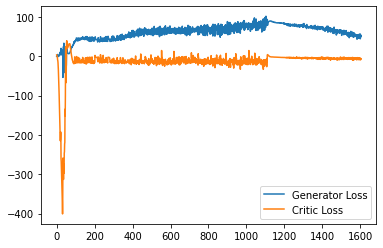

Step 32150: Generator loss: 53.46050422668457, critic loss: -7.462525852680205


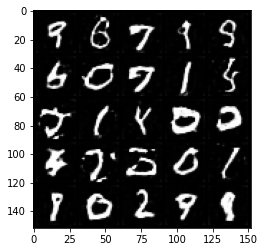

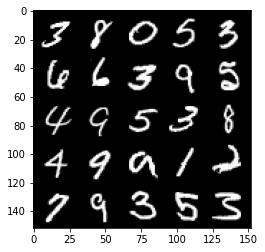

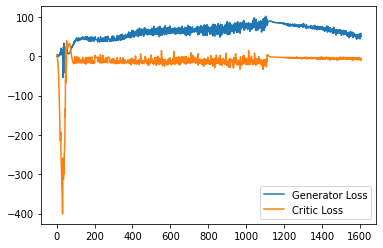

Step 32200: Generator loss: 48.40311470031738, critic loss: -4.862588603973389


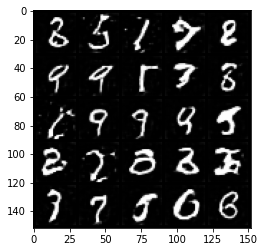

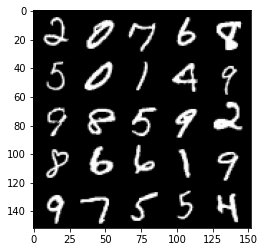

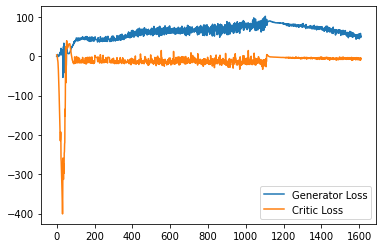

Step 32250: Generator loss: 47.993622283935544, critic loss: -5.750025740146637


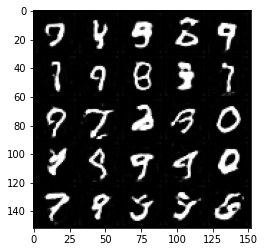

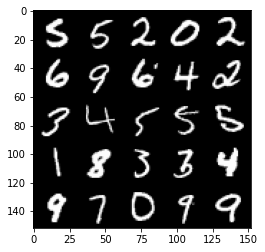

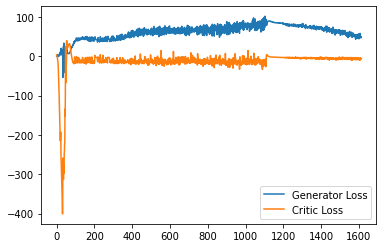

Step 32300: Generator loss: 46.517866935729984, critic loss: -8.187710811495782


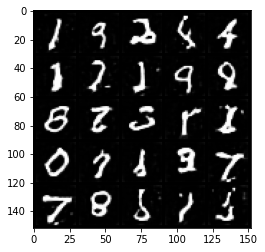

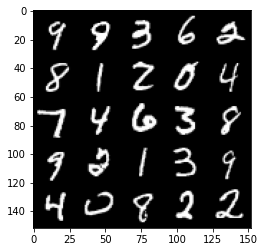

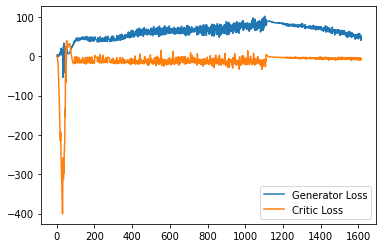

Step 32350: Generator loss: 50.112347793579104, critic loss: -6.505885065555572


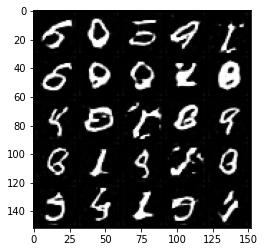

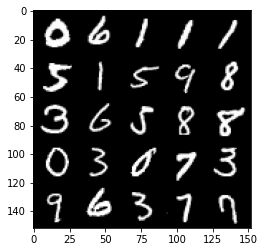

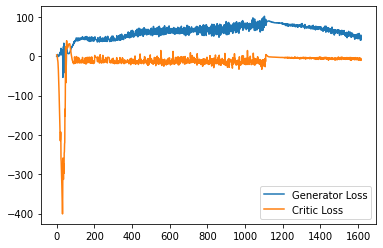

Step 32400: Generator loss: 47.029298362731936, critic loss: -5.889234193205834


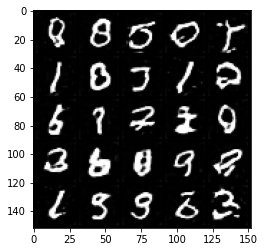

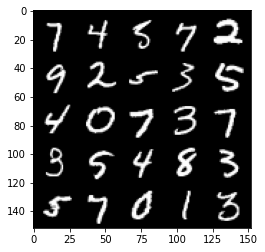

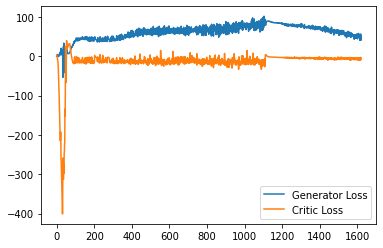

Step 32450: Generator loss: 50.507311248779295, critic loss: -7.125634058475493


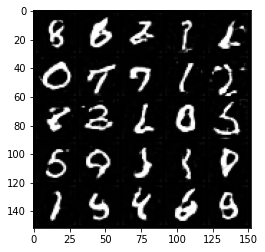

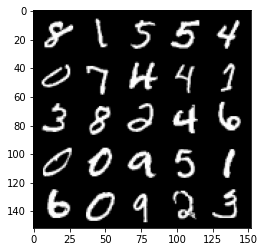

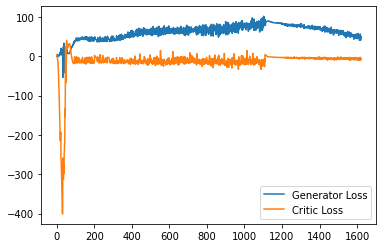

Step 32500: Generator loss: 45.92358032226562, critic loss: -5.277095186471939


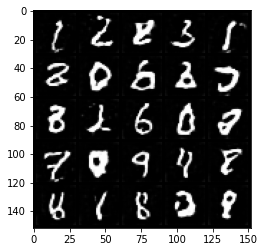

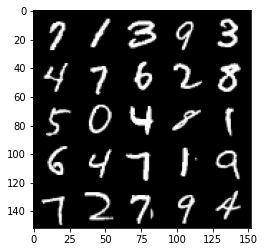

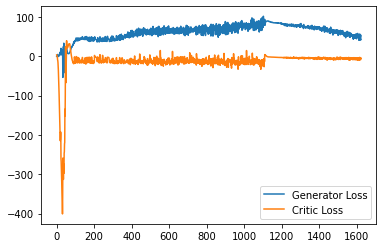

Step 32550: Generator loss: 48.78475093841553, critic loss: -6.0440810618400596


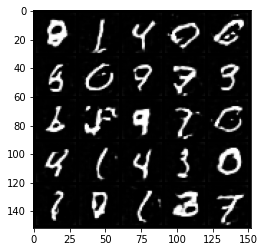

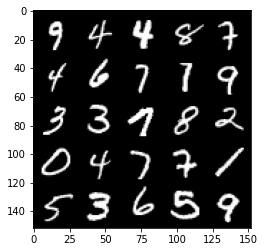

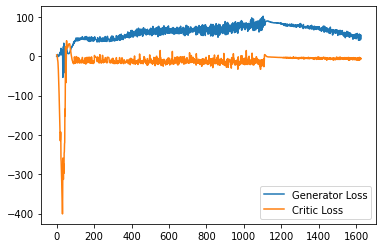

Step 32600: Generator loss: 51.06172264099121, critic loss: -6.5038898777961744


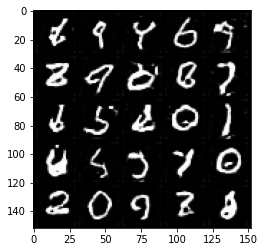

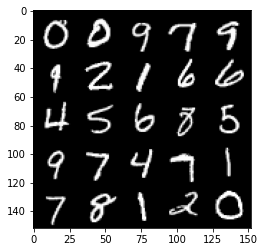

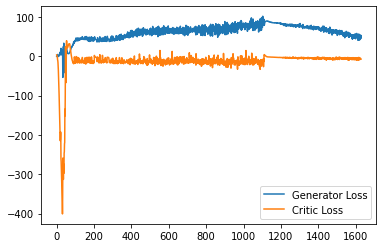

Step 32650: Generator loss: 47.74654373168946, critic loss: -5.13604497051239


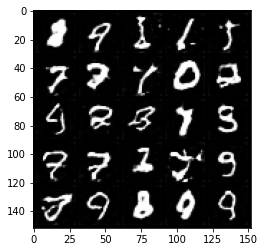

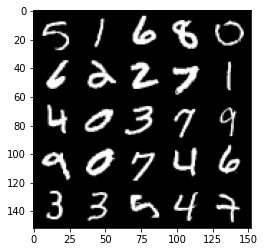

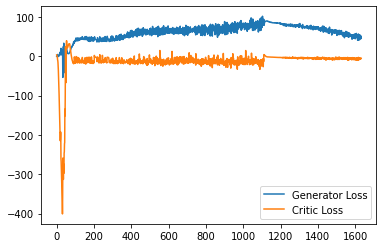

Step 32700: Generator loss: 47.82235862731934, critic loss: -9.529322919607164


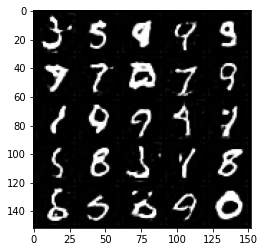

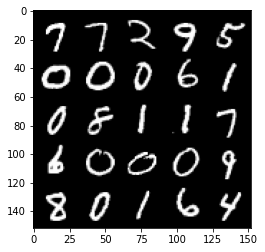

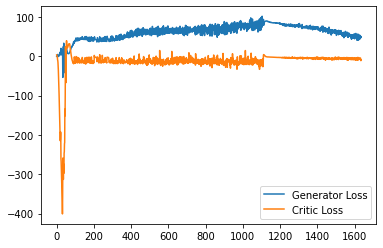

Step 32750: Generator loss: 48.993469581604, critic loss: -5.741838580846786


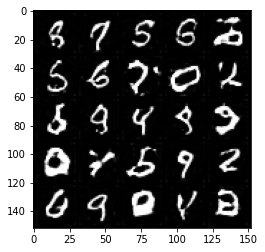

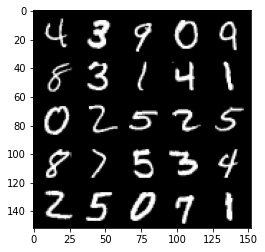

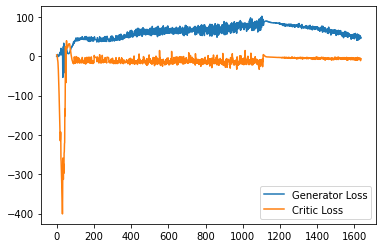

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
